# R15107 fiducial efficiency regardless of satellite killer is exceptionally low.

Lets check the topological information from these tracks and plot those that fail the fiducial cut

In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from tqdm import tqdm
import tables as tb
from matplotlib import colors 

from typing          import Optional
from typing          import Union
from typing          import Callable

from concurrent.futures import ProcessPoolExecutor

import sys,os,os.path
sys.path.append("/gluster/data/next/software/IC_311024/")
sys.path.append(os.path.expanduser('~/code/eol_hsrl_python'))
#sys.path.append("/home/e78368jw/Documents/NEXT_CODE/next_misc/")
os.environ['ICTDIR']='/gluster/data/next/software/IC_311024/'

from invisible_cities.io.dst_io           import load_dst, load_dsts, df_writer
from invisible_cities.io.hits_io          import hits_writer
from invisible_cities.core                import tbl_functions   as tbl
from invisible_cities.core.core_functions import in_range
from invisible_cities.cities.beersheba    import hitc_to_df_
from invisible_cities.io.hits_io          import hits_from_df
from invisible_cities.evm.nh5             import HitsTable
from invisible_cities.types.symbols       import NormStrategy
from invisible_cities.types.ic_types      import NoneType
from invisible_cities.reco.corrections    import read_maps, get_df_to_z_converter, apply_all_correction
from invisible_cities.evm.event_model     import HitCollection

from tqdm import tqdm

import functions_HE as func

%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [3]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from tqdm import tqdm
import tables as tb
from matplotlib import colors 

from typing          import Optional
from typing          import Union
from typing          import Callable

from concurrent.futures import ProcessPoolExecutor

import sys,os,os.path
sys.path.append("/gluster/data/next/software/IC_311024/")
sys.path.append(os.path.expanduser('~/code/eol_hsrl_python'))
#sys.path.append("/home/e78368jw/Documents/NEXT_CODE/next_misc/")
os.environ['ICTDIR']='/gluster/data/next/software/IC_311024/'

from invisible_cities.io.dst_io           import load_dst, load_dsts, df_writer
from invisible_cities.io.hits_io          import hits_writer
from invisible_cities.core                import tbl_functions   as tbl
from invisible_cities.core.core_functions import in_range
from invisible_cities.cities.beersheba    import hitc_to_df_
from invisible_cities.io.hits_io          import hits_from_df
from invisible_cities.evm.nh5             import HitsTable
from invisible_cities.types.symbols       import NormStrategy
from invisible_cities.types.ic_types      import NoneType
from invisible_cities.reco.corrections    import read_maps, get_df_to_z_converter, apply_all_correction
from invisible_cities.evm.event_model     import HitCollection

from IC.invisible_cities.evm.event_model        import HitEnergy
from IC.invisible_cities.cities.beersheba          import DeconvolutionMode
from IC.invisible_cities.cities.beersheba          import CutType
from IC.invisible_cities.cities                 import beersheba as beerfun


from IC.invisible_cities.reco import hits_functions as hif

from IC.invisible_cities.reco.deconv_functions import deconvolve
from IC.invisible_cities.reco.deconv_functions import deconvolution_input
from IC.invisible_cities.reco.deconv_functions import InterpolationMethod

from tqdm import tqdm

import functions_HE as func

%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [4]:
def load_single_file(file_path):
    '''
    Load data from a single h5 file and produce dataframes for /Tracking/Tracks

    Args:
        file_path       :       str
                                Path to the h5 file to be loaded.

    Returns:
        tracks_df       :       pandas.DataFrame
                                DataFrame containing the /Tracking/Tracks data.
    '''
    try: 
        tracks_df = load_dst(file_path, 'Tracking', 'Tracks')
        return tracks_df
    except Exception as e:
        print(f'File {file_path} broke with error:\n{e}')
        x = pd.DataFrame()
        return x

def load_file_hits(file_path):
    '''
    Load data from a single h5 file and produce dataframes for /DECO/Events

    Args:
        file_path       :       str
                                Path to the h5 file to be loaded.

    Returns:
        tracks_df       :       pandas.DataFrame
                                DataFrame containing the /DECO/Events data.
    '''
    try: 
        tracks_df = load_dst(file_path, 'DECO', 'Events')
        return tracks_df
    except Exception as e:
        print(f'File {file_path} broke with error:\n{e}')
        x = pd.DataFrame()
        return x
    
    

def load_file_soph_hits(file_path):
    '''
    Load data from a single h5 file and produce dataframes for /RECO/Events

    Args:
        file_path       :       str
                                Path to the h5 file to be loaded.

    Returns:
        tracks_df       :       pandas.DataFrame
                                DataFrame containing the /RECO/Events data.
    '''
    try: 
        tracks_df = load_dst(file_path, 'RECO', 'Events')
        return tracks_df
    except Exception as e:
        print(f'File {file_path} broke with error:\n{e}')
        x = pd.DataFrame()
        return x
    

def load_data_fast(folder_path, func):
    '''
    Load multiple h5 files and produce concatenated dataframes for /Tracking/Tracks, /MC/Particles, and their corresponding eventmap.

    Args:
        folder_path     :       str
                                Path to the folder containing the h5 files.
        func            :       function
                                The function you're passing that defines the df you're retrieving

    Returns:
        tracks          :       pandas.DataFrame
                                Concatenated DataFrame containing the /Tracking/Tracks data from all h5 files.
        
        particles       :       pandas.DataFrame
                                Concatenated DataFrame containing the /MC/particles data from all h5 files, with the 'event_id' column modified.

        eventmap        :       pandas.DataFrame
                                Concatenated DataFrame containing the event map from all h5 files.
    '''
    
    file_names = [f for f in os.listdir(folder_path) if f.endswith('.h5')]
    file_paths = [os.path.join(folder_path, f) for f in file_names]

    # Use ProcessPoolExecutor to parallelize the data loading process
    with ProcessPoolExecutor() as executor:
        results = list(executor.map(func, file_paths))
    
    # Separate the results into respective lists
    tracks_list = results

    # Concatenate all the dataframes at once
    tracks = pd.concat(tracks_list, axis=0, ignore_index=True)

    return tracks

In [5]:
RUN_NUMBER = 15107
TIMESTAMP  = 240425

In [6]:
# whole thing
n100_dir = f'/gluster/data/next/files/TOPOLOGY_John/N100_data/{RUN_NUMBER}/isaura/{TIMESTAMP}/'

hdst = []

for i in tqdm(range(1,8)):
    print(f"LDC {i}")
    if i != 2: # we're skipping it atm
        folder_path = n100_dir + 'ldc' + str(i) + '/'
        hdst.append(load_data_fast(folder_path, load_single_file))

hdst = pd.concat(hdst)

  0%|          | 0/7 [00:00<?, ?it/s]

LDC 1
File /gluster/data/next/files/TOPOLOGY_John/N100_data/15107/isaura/240425/ldc1/isaura_run_15107_0676_ldc1_240425.h5 broke with error:
group ``/`` does not have a child named ``Tracking``
File /gluster/data/next/files/TOPOLOGY_John/N100_data/15107/isaura/240425/ldc1/isaura_run_15107_0876_ldc1_240425.h5 broke with error:
group ``/`` does not have a child named ``Tracking``


 14%|█▍        | 1/7 [00:12<01:16, 12.68s/it]

LDC 2
LDC 3


 43%|████▎     | 3/7 [00:24<00:31,  7.77s/it]

LDC 4
File /gluster/data/next/files/TOPOLOGY_John/N100_data/15107/isaura/240425/ldc4/isaura_run_15107_1355_ldc4_240425.h5 broke with error:
group ``/`` does not have a child named ``Tracking``


 57%|█████▋    | 4/7 [00:37<00:27,  9.33s/it]

LDC 5


 71%|███████▏  | 5/7 [00:49<00:20, 10.40s/it]

LDC 6


 86%|████████▌ | 6/7 [01:02<00:11, 11.26s/it]

LDC 7


100%|██████████| 7/7 [01:15<00:00, 10.78s/it]


In [7]:
display(hdst)
print(hdst.columns.values)

,event,trackID,energy,length,numb_of_voxels,numb_of_hits,numb_of_tracks,x_min,y_min,z_min,...,blob1_z,blob2_x,blob2_y,blob2_z,eblob1,eblob2,ovlp_blob_energy,vox_size_x,vox_size_y,vox_size_z
0,8948,0,0.627782,98.488994,91,1584,2,-176.375,273.825,1372.330129,...,1380.533915,-144.312554,321.944293,1457.465196,0.246330,0.168424,0.000000,11.951220,11.802326,11.361525
1,8948,1,0.128133,27.851397,7,215,2,278.625,-168.675,1440.893132,...,1447.827128,294.496045,-150.151347,1466.777666,0.126592,0.124770,0.123228,11.951220,11.802326,11.361525
2,9053,0,0.694676,81.799334,82,1627,3,208.625,316.325,1098.644016,...,1167.480315,220.980848,344.323564,1098.644016,0.160748,0.083288,0.000000,11.904762,11.875000,11.998640
3,9053,1,0.163198,35.995919,14,411,3,-223.875,-96.175,1864.630107,...,1898.521110,-205.877463,-81.943843,1864.630107,0.120636,0.114544,0.071981,11.904762,11.875000,11.998640
4,9053,2,0.042026,11.998640,2,67,3,-211.375,-41.175,-289.029569,...,-283.708164,-203.872606,-40.184434,-272.790899,0.042026,0.042026,0.042026,11.904762,11.875000,11.998640
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
43178,2327534,1,0.051308,23.462873,7,135,2,53.625,136.325,1236.001440,...,1236.001440,69.808557,146.183483,1253.011833,0.051308,0.051308,0.051308,11.500000,11.590909,11.731437
43179,2327632,0,0.491657,64.767506,39,763,4,241.125,8.825,968.453199,...,968.453199,255.534623,25.528730,1027.902532,0.253606,0.131858,0.000000,11.953125,11.875000,11.975607
43180,2327632,1,0.122795,32.647037,11,272,4,-171.375,-161.175,448.628383,...,455.230631,-153.986975,-153.507172,473.079255,0.122603,0.120549,0.120357,11.953125,11.875000,11.975607
43181,2327632,2,0.067528,28.840684,10,241,4,-406.375,118.825,361.499752,...,369.320431,-387.945065,143.319827,388.073352,0.065150,0.064381,0.062003,11.953125,11.875000,11.975607


['event' 'trackID' 'energy' 'length' 'numb_of_voxels' 'numb_of_hits'
 'numb_of_tracks' 'x_min' 'y_min' 'z_min' 'r_min' 'x_max' 'y_max' 'z_max'
 'r_max' 'x_ave' 'y_ave' 'z_ave' 'r_ave' 'extreme1_x' 'extreme1_y'
 'extreme1_z' 'extreme2_x' 'extreme2_y' 'extreme2_z' 'blob1_x' 'blob1_y'
 'blob1_z' 'blob2_x' 'blob2_y' 'blob2_z' 'eblob1' 'eblob2'
 'ovlp_blob_energy' 'vox_size_x' 'vox_size_y' 'vox_size_z']


In [7]:
# apply fiducial cut
fid_hdst = func.fiducial_track_cut_2(hdst, r_lim = 472, verbose = True)

Cutting events around fiducial volume related to:
Z range between 20 and 1195
Radius range < 472


In [8]:
# take all the events not included in fid_hdst
out_fid_hdst = hdst[~hdst['event'].isin(fid_hdst.event.values)]
display(out_fid_hdst)

,event,trackID,energy,length,numb_of_voxels,numb_of_hits,numb_of_tracks,x_min,y_min,z_min,...,blob1_z,blob2_x,blob2_y,blob2_z,eblob1,eblob2,ovlp_blob_energy,vox_size_x,vox_size_y,vox_size_z
0,8948,0,0.627782,98.488994,91,1584,2,-176.375,273.825,1372.330129,...,1380.533915,-144.312554,321.944293,1457.465196,0.246330,0.168424,0.000000,11.951220,11.802326,11.361525
1,8948,1,0.128133,27.851397,7,215,2,278.625,-168.675,1440.893132,...,1447.827128,294.496045,-150.151347,1466.777666,0.126592,0.124770,0.123228,11.951220,11.802326,11.361525
2,9053,0,0.694676,81.799334,82,1627,3,208.625,316.325,1098.644016,...,1167.480315,220.980848,344.323564,1098.644016,0.160748,0.083288,0.000000,11.904762,11.875000,11.998640
3,9053,1,0.163198,35.995919,14,411,3,-223.875,-96.175,1864.630107,...,1898.521110,-205.877463,-81.943843,1864.630107,0.120636,0.114544,0.071981,11.904762,11.875000,11.998640
4,9053,2,0.042026,11.998640,2,67,3,-211.375,-41.175,-289.029569,...,-283.708164,-203.872606,-40.184434,-272.790899,0.042026,0.042026,0.042026,11.904762,11.875000,11.998640
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
43178,2327534,1,0.051308,23.462873,7,135,2,53.625,136.325,1236.001440,...,1236.001440,69.808557,146.183483,1253.011833,0.051308,0.051308,0.051308,11.500000,11.590909,11.731437
43179,2327632,0,0.491657,64.767506,39,763,4,241.125,8.825,968.453199,...,968.453199,255.534623,25.528730,1027.902532,0.253606,0.131858,0.000000,11.953125,11.875000,11.975607
43180,2327632,1,0.122795,32.647037,11,272,4,-171.375,-161.175,448.628383,...,455.230631,-153.986975,-153.507172,473.079255,0.122603,0.120549,0.120357,11.953125,11.875000,11.975607
43181,2327632,2,0.067528,28.840684,10,241,4,-406.375,118.825,361.499752,...,369.320431,-387.945065,143.319827,388.073352,0.065150,0.064381,0.062003,11.953125,11.875000,11.975607


In [9]:
# sanity check
print(f'Total number of events: {hdst.event.nunique()}\nEvents outwith fiducial volume: {out_fid_hdst.event.nunique()}\nEvents within fiducial volume: {fid_hdst.event.nunique()}\nBecause youre stupid, thats {fid_hdst.event.nunique() + out_fid_hdst.event.nunique()}')

Total number of events: 87803
Events outwith fiducial volume: 73853
Events within fiducial volume: 13950
Because youre stupid, thats 87803


# Quick check, how many of the events fall outwith the active volume?

In [10]:
active_hdst = func.fiducial_track_cut_2(hdst, lower_z = 0, upper_z = 1187, r_lim = 1000, verbose = True)

Cutting events around fiducial volume related to:
Z range between 0 and 1187
Radius range < 1000


In [11]:
print(f'Number of events in active volume: {active_hdst.event.nunique()}\nNumber of events total: {hdst.event.nunique()}')

Number of events in active volume: 14715
Number of events total: 87803


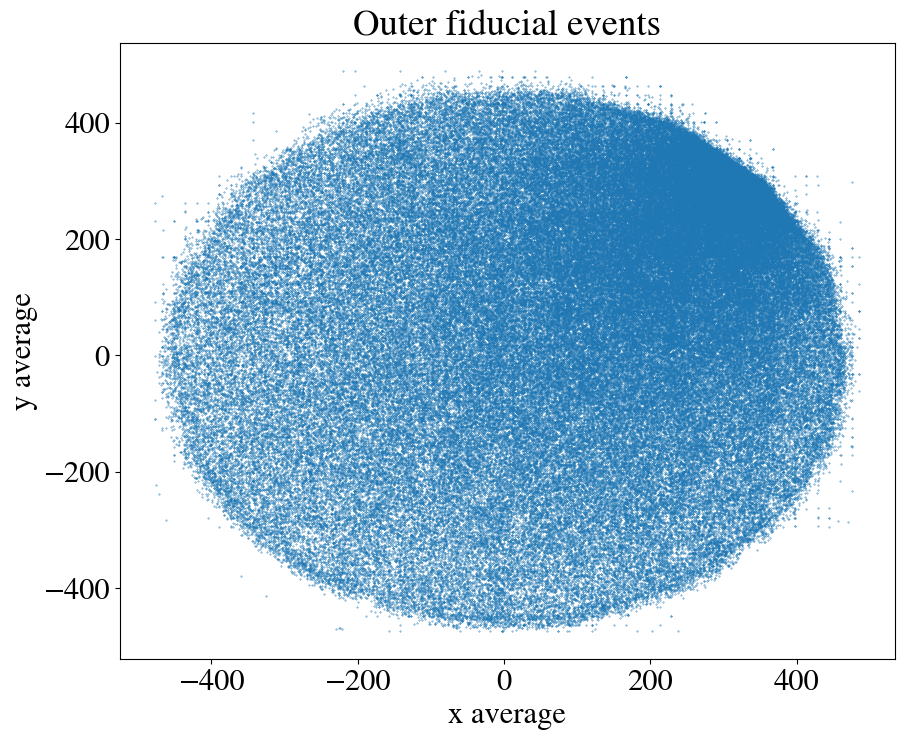

In [10]:
# okay, lets plot the outer fiducial volume events.
# 'x_ave' 'y_ave' 'z_ave' 'r_ave'
plt.scatter(out_fid_hdst.x_ave.values, out_fid_hdst.y_ave.values, s = 0.1)
plt.xlabel('x average')
plt.ylabel('y average')
plt.title('Outer fiducial events')
plt.show()

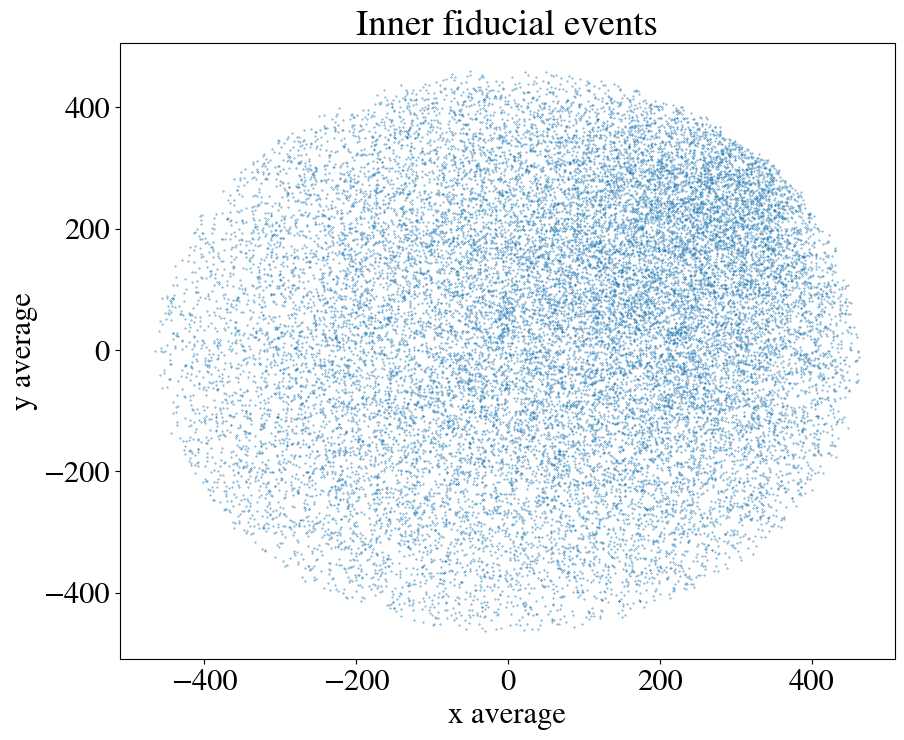

: 

: 

: 

In [ ]:
plt.scatter(fid_hdst.x_ave.values, fid_hdst.y_ave.values, s = 0.1)
plt.xlabel('x average')
plt.ylabel('y average')
plt.title('Inner fiducial events')
plt.show()

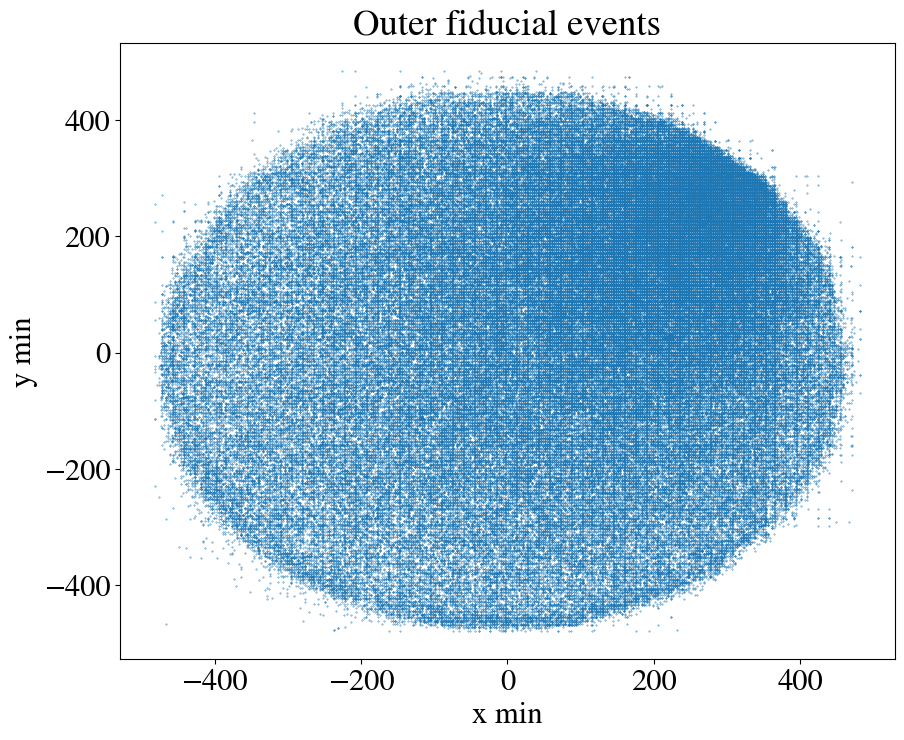

: 

: 

: 

In [ ]:
# okay, lets plot the outer fiducial volume events.
# 'x_ave' 'y_ave' 'z_ave' 'r_ave'
plt.scatter(out_fid_hdst.x_min.values, out_fid_hdst.y_min.values, s = 0.1)
plt.xlabel('x min')
plt.ylabel('y min')
plt.title('Outer fiducial events')
plt.show()

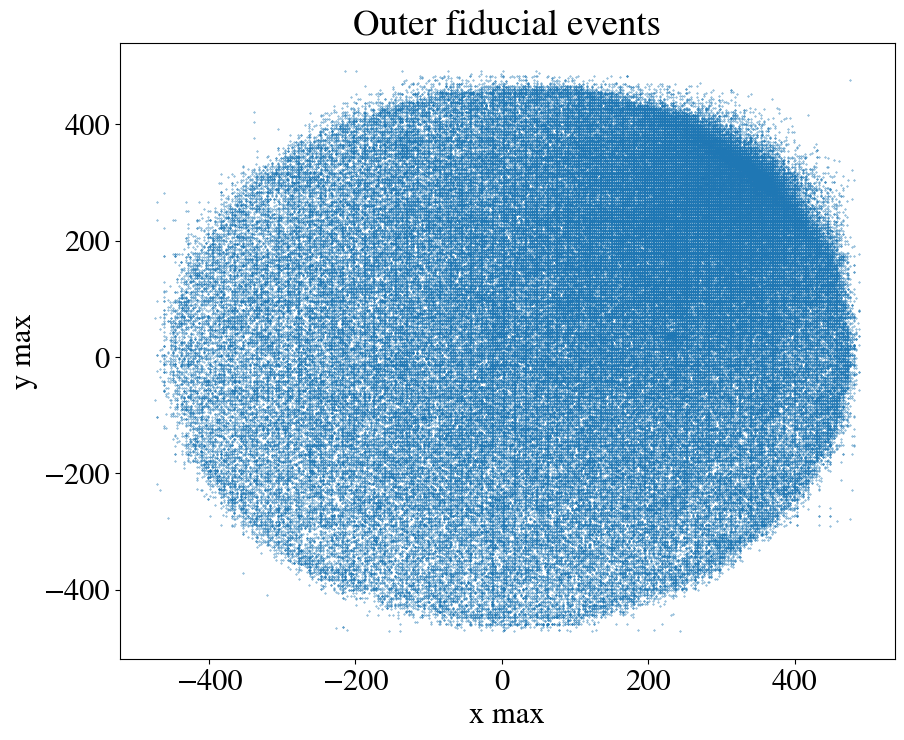

In [12]:
# okay, lets plot the outer fiducial volume events.
# 'x_ave' 'y_ave' 'z_ave' 'r_ave'
plt.scatter(out_fid_hdst.x_max.values, out_fid_hdst.y_max.values, s = 0.1)
plt.xlabel('x max')
plt.ylabel('y max')
plt.title('Outer fiducial events')
plt.show()

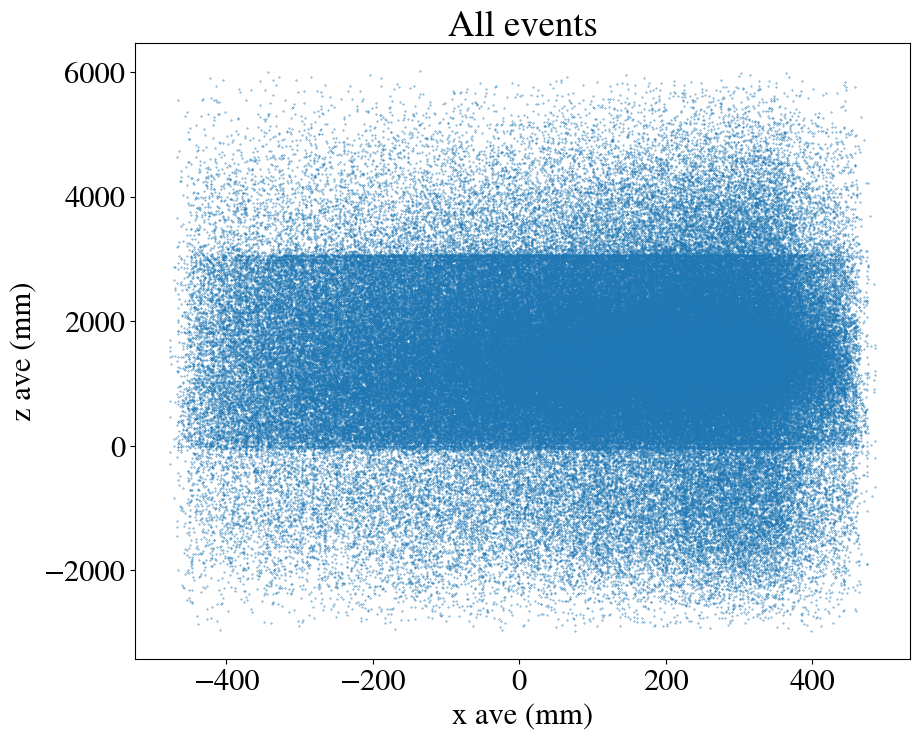

In [18]:
# same plot but along Z
plt.scatter(hdst.x_ave.values, hdst.z_ave.values, s = 0.1)
plt.xlabel('x ave (mm)')
plt.ylabel('z ave (mm)')
plt.title('All events')
plt.show()

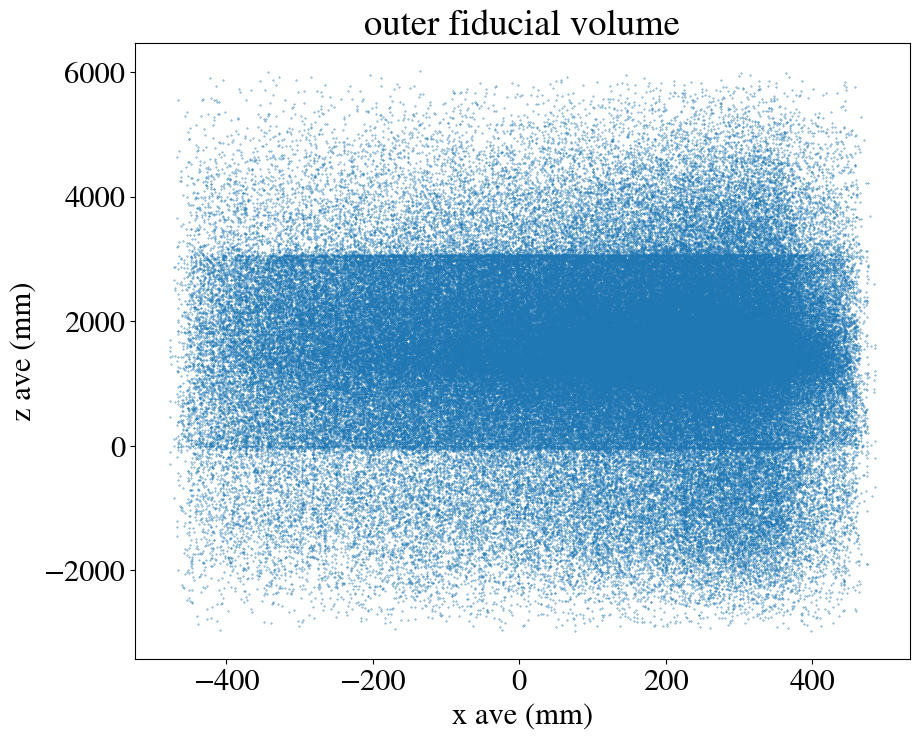

In [17]:
# same plot but along Z
plt.scatter(out_fid_hdst.x_ave.values, out_fid_hdst.z_ave.values, s = 0.1)
plt.xlabel('x ave (mm)')
plt.ylabel('z ave (mm)')
plt.title('outer fiducial volume')
plt.show()

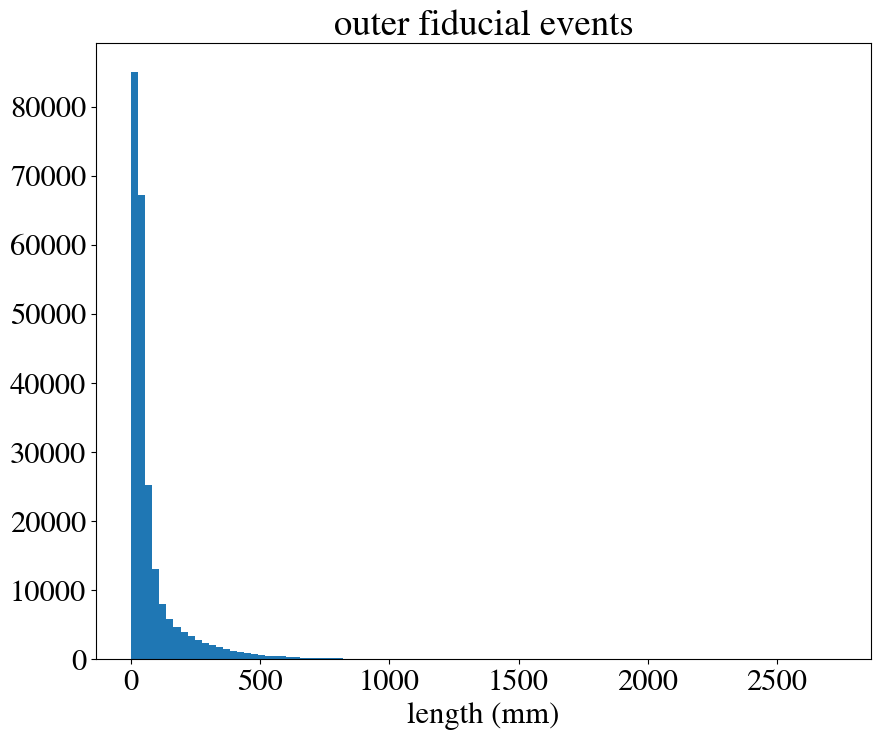

: 

: 

: 

In [ ]:
plt.hist(out_fid_hdst.length.values, bins = 100)
plt.title('outer fiducial events')
plt.xlabel('length (mm)')
plt.show()


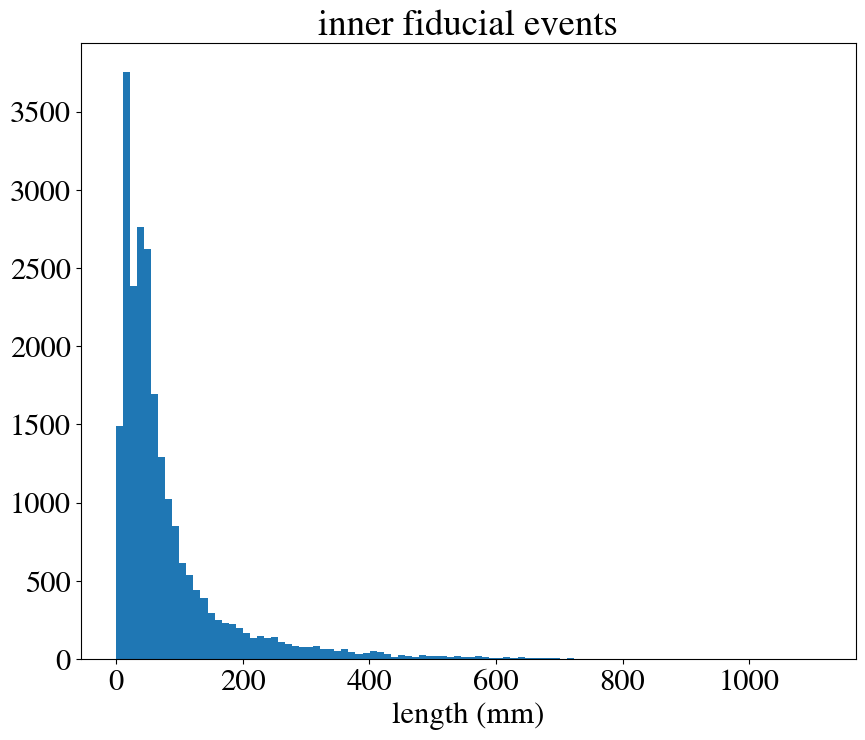

: 

: 

In [ ]:
plt.hist(fid_hdst.length.values, bins = 100)
plt.title('inner fiducial events')
plt.xlabel('length (mm)')
plt.show()

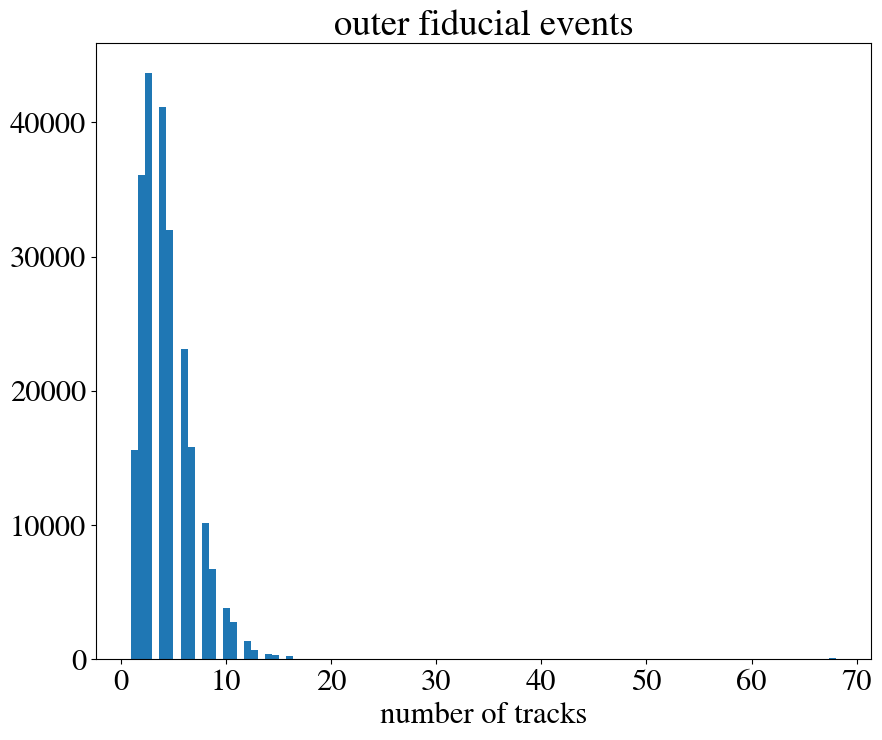

: 

: 

In [ ]:
plt.hist(out_fid_hdst.numb_of_tracks.values, bins = 100)
plt.title('outer fiducial events')
plt.xlabel('number of tracks')
plt.show()

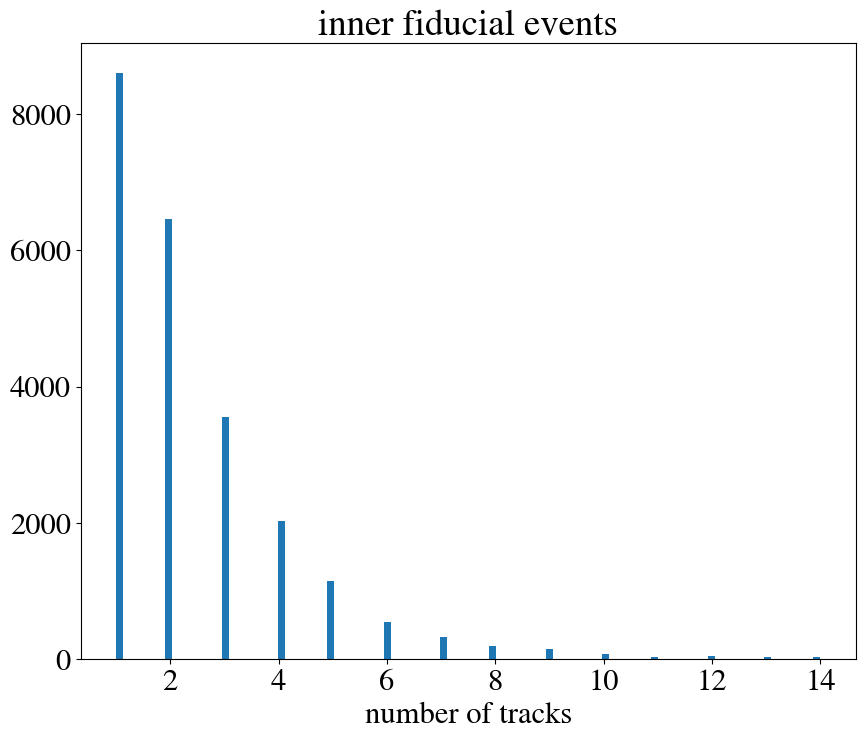

: 

: 

In [ ]:
plt.hist(fid_hdst.numb_of_tracks.values, bins = 100)
plt.title('inner fiducial events')
plt.xlabel('number of tracks')
plt.show()

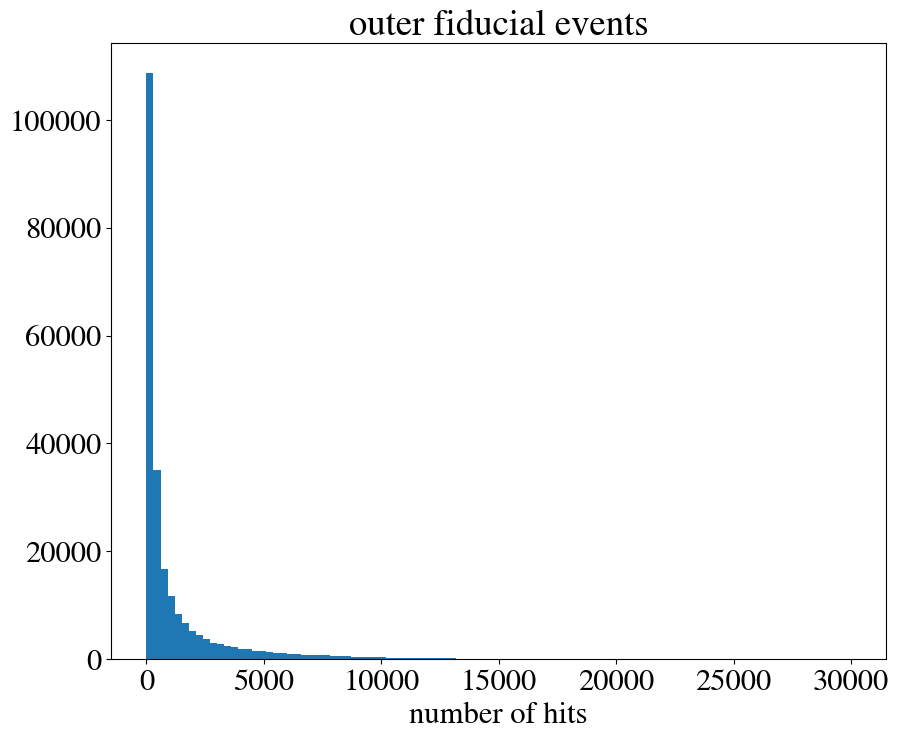

: 

: 

In [ ]:
plt.hist(out_fid_hdst.numb_of_hits.values, range = (0, 30000), bins = 100)
plt.title('outer fiducial events')
plt.xlabel('number of hits')
plt.show()

In [4]:
plt.hist(fid_hdst.numb_of_hits.values, range = (0, 30000), bins = 100)
plt.title('inner fiducial events')
plt.xlabel('number of hits')
plt.show()

NameError: name 'fid_hdst' is not defined

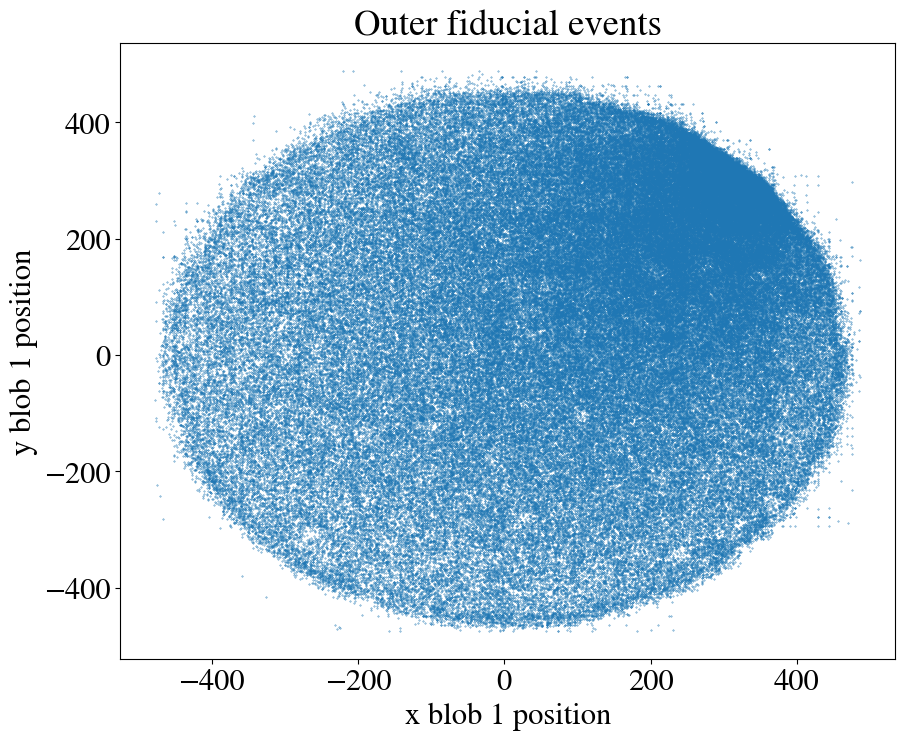

: 

: 

In [ ]:
# okay, lets plot the outer fiducial volume events.
# 'x_ave' 'y_ave' 'z_ave' 'r_ave'
plt.scatter(out_fid_hdst.blob1_x.values, out_fid_hdst.blob1_y.values, s = 0.1)
plt.xlabel('x blob 1 position')
plt.ylabel('y blob 1 position')
plt.title('Outer fiducial events')
plt.show()

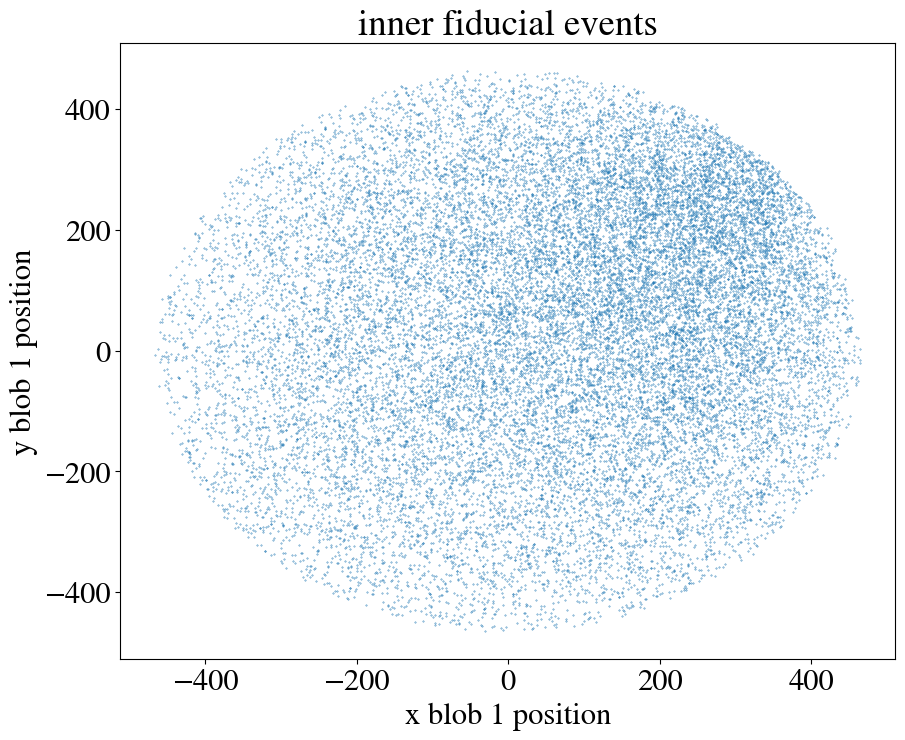

: 

: 

In [ ]:
# okay, lets plot the outer fiducial volume events.
# 'x_ave' 'y_ave' 'z_ave' 'r_ave'
plt.scatter(fid_hdst.blob1_x.values, fid_hdst.blob1_y.values, s = 0.1)
plt.xlabel('x blob 1 position')
plt.ylabel('y blob 1 position')
plt.title('inner fiducial events')
plt.show()

In [8]:
hits = []




folder_path = n100_dir + 'ldc1' + '/'
hits.append(load_data_fast(folder_path, load_file_hits))

hits = pd.concat(hits)

In [9]:
print(n100_dir)

/gluster/data/next/files/TOPOLOGY_John/N100_data/15107/isaura/240425/


In [10]:
soph_hits = []
n100_dir_soph = '/gluster/data/next/files/TOPOLOGY_John/N100_data/15107/sophronia_rebin/trigger_2/'



folder_path = n100_dir_soph + 'ldc1' + '/'
soph_hits.append(load_data_fast(folder_path, load_file_soph_hits))

soph_hits = pd.concat(soph_hits)

# select a couple of events that have a low energy track in there and compare sophronia to beersheba

In [11]:
display(hdst)
low_E_evts = hdst[hdst.energy < 0.05]

,event,trackID,energy,length,numb_of_voxels,numb_of_hits,numb_of_tracks,x_min,y_min,z_min,...,blob1_z,blob2_x,blob2_y,blob2_z,eblob1,eblob2,ovlp_blob_energy,vox_size_x,vox_size_y,vox_size_z
0,8948,0,0.627782,98.488994,91,1584,2,-176.375,273.825,1372.330129,...,1380.533915,-144.312554,321.944293,1457.465196,0.246330,0.168424,0.000000,11.951220,11.802326,11.361525
1,8948,1,0.128133,27.851397,7,215,2,278.625,-168.675,1440.893132,...,1447.827128,294.496045,-150.151347,1466.777666,0.126592,0.124770,0.123228,11.951220,11.802326,11.361525
2,9053,0,0.694676,81.799334,82,1627,3,208.625,316.325,1098.644016,...,1167.480315,220.980848,344.323564,1098.644016,0.160748,0.083288,0.000000,11.904762,11.875000,11.998640
3,9053,1,0.163198,35.995919,14,411,3,-223.875,-96.175,1864.630107,...,1898.521110,-205.877463,-81.943843,1864.630107,0.120636,0.114544,0.071981,11.904762,11.875000,11.998640
4,9053,2,0.042026,11.998640,2,67,3,-211.375,-41.175,-289.029569,...,-283.708164,-203.872606,-40.184434,-272.790899,0.042026,0.042026,0.042026,11.904762,11.875000,11.998640
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
43178,2327534,1,0.051308,23.462873,7,135,2,53.625,136.325,1236.001440,...,1236.001440,69.808557,146.183483,1253.011833,0.051308,0.051308,0.051308,11.500000,11.590909,11.731437
43179,2327632,0,0.491657,64.767506,39,763,4,241.125,8.825,968.453199,...,968.453199,255.534623,25.528730,1027.902532,0.253606,0.131858,0.000000,11.953125,11.875000,11.975607
43180,2327632,1,0.122795,32.647037,11,272,4,-171.375,-161.175,448.628383,...,455.230631,-153.986975,-153.507172,473.079255,0.122603,0.120549,0.120357,11.953125,11.875000,11.975607
43181,2327632,2,0.067528,28.840684,10,241,4,-406.375,118.825,361.499752,...,369.320431,-387.945065,143.319827,388.073352,0.065150,0.064381,0.062003,11.953125,11.875000,11.975607


In [12]:
# take some of these low energy events
low_E_soph_hits = soph_hits[soph_hits.event.isin(low_E_evts.event.unique())]
low_E_hits = hits[hits.event.isin(low_E_evts.event.unique())]

In [13]:
display(low_E_hits)
display(low_E_soph_hits)
# check that the events in one are in the other
print(sorted(low_E_hits.event.unique()) == sorted(low_E_soph_hits.event.unique()) )

,event,time,npeak,Xpeak,Ypeak,nsipm,X,Y,Xrms,Yrms,Z,Q,E,Qc,Ec,track_id,Ep
2181,9053,1.742935e+09,8,-58.767006,11.236777,0,-218.875,-43.675,0.0,0.0,-289.029569,0.000056,0.000056,-1.0,0.000056,-1,NaN
2182,9053,1.742935e+09,8,-58.767006,11.236777,0,-218.875,-41.175,0.0,0.0,-289.029569,0.000084,0.000084,-1.0,0.000084,-1,NaN
2183,9053,1.742935e+09,8,-58.767006,11.236777,0,-218.875,-38.675,0.0,0.0,-289.029569,0.000091,0.000091,-1.0,0.000091,-1,NaN
2184,9053,1.742935e+09,8,-58.767006,11.236777,0,-218.875,-36.175,0.0,0.0,-289.029569,0.000072,0.000072,-1.0,0.000072,-1,NaN
2185,9053,1.742935e+09,8,-58.767006,11.236777,0,-216.375,-46.175,0.0,0.0,-289.029569,0.000053,0.000053,-1.0,0.000053,-1,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
64085671,2328174,1.742965e+09,18,-1.678470,-129.576151,0,1.125,-356.175,0.0,0.0,1725.468658,0.000035,0.000035,-1.0,0.000035,1,0.000035
64085672,2328174,1.742965e+09,18,-1.678470,-129.576151,0,1.125,-353.675,0.0,0.0,1725.468658,0.000030,0.000030,-1.0,0.000030,1,0.000030
64085673,2328174,1.742965e+09,18,-1.678470,-129.576151,0,1.125,-351.175,0.0,0.0,1725.468658,0.000017,0.000017,-1.0,0.000017,1,0.000017
64085674,2328174,1.742965e+09,18,-1.678470,-129.576151,0,3.625,-356.175,0.0,0.0,1725.468658,0.000015,0.000015,-1.0,0.000015,1,0.000015


,event,time,npeak,Xpeak,Ypeak,nsipm,X,Y,Xrms,Yrms,Z,Q,E,Qc,Ec,track_id,Ep
1423,2285362,1.742964e+09,0,-54.833942,5.772696,1,-420.425,260.975,0.0,0.0,95.75300,8.284595,-1.875328,-1.0,NaN,-1,-1.0
1424,2285362,1.742964e+09,0,-54.833942,5.772696,1,-328.125,137.575,0.0,0.0,95.75300,5.456199,-1.235083,-1.0,-0.000003,-1,-1.0
1425,2285362,1.742964e+09,0,-54.833942,5.772696,1,-3.575,-217.575,0.0,0.0,95.75300,5.258577,-1.190349,-1.0,-0.000003,-1,-1.0
1426,2285362,1.742964e+09,0,-54.833942,5.772696,1,10.975,-78.625,0.0,0.0,95.75300,5.934619,-1.343380,-1.0,-0.000003,-1,-1.0
1427,2285362,1.742964e+09,0,-54.833942,5.772696,1,319.975,153.125,0.0,0.0,95.75300,5.390190,-1.220141,-1.0,-0.000003,-1,-1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
30624650,1680037,1.742957e+09,3,-137.372190,72.899982,1,-235.825,91.425,0.0,0.0,1574.85525,6.134688,46.201578,-1.0,0.000146,-1,-1.0
30624651,1680037,1.742957e+09,3,-137.372190,72.899982,1,-220.275,106.975,0.0,0.0,1574.85525,5.036560,37.931348,-1.0,0.000119,-1,-1.0
30624652,1680037,1.742957e+09,3,-137.372190,72.899982,1,26.525,-371.075,0.0,0.0,1574.85525,9.029706,68.004540,-1.0,0.000225,-1,-1.0
30624653,1680037,1.742957e+09,3,-137.372190,72.899982,1,273.325,90.925,0.0,0.0,1574.85525,6.401273,48.209282,-1.0,0.000154,-1,-1.0


True


In [14]:
# set these once and forget
PSF_PATH = '/gluster/data/next/files/TOPOLOGY_John/N100_data/14914/prod_psf/eutropia/merged_psfs/final_psf.psf'
datatype = 'data'
detector_db = '/gluster/data/next/software/IC_311024/IC/invisible_cities/database/localdb.NEXT100DB.sqlite3'
run_number = 15107


deconv_params = dict(
  q_cut           = 10, #5 for 6mm  - 5 for 6mm
  drop_dist       = [16, 16],
  psf_fname       = PSF_PATH,     
  e_cut           = 0.2, #15 for 6mm  - 15 for 6mm
  n_iterations    = 10, #150 for 6mm  - 150 for 6mm
  iteration_tol   = 1e-9,
  sample_width    = [15.55, 15.55],
  bin_size        = [ 1,  1],
  diffusion       = (1., 0.2),
  n_dim           = 2,
  deconv_mode     = DeconvolutionMode.joint,
  satellite_params = dict(satellite_start_iter = 100,
                          satellite_max_size   = 25,
                          e_cut                = 0.9,
                          cut_type             = CutType.rel),
  energy_type     = HitEnergy.Ec,
  cut_type        = CutType.rel)
 # inter_method    = InterpolationMethod.cubic)
#satellite_params = dict(satellite_start_iter = 75,
#                        satellite_max_size   = 3,
#                        e_cut                = 0.2,
#                        cut_type             = CutType.rel)
                
deconv_params_   = {k : v for k, v in deconv_params.items() if k not in ['q_cut', 'drop_dist']}

# Couple of functions used in beersheba.

cut_sensors       = beerfun.cut_over_Q   (deconv_params['q_cut'    ], ['E', 'Ec'])
drop_sensors      = beerfun.drop_isolated(deconv_params['drop_dist'], ['E', 'Ec'])


In [15]:
display(hdst[hdst.event == 9053])
display(hdst[hdst.event == 9053].numb_of_tracks.unique()[0])

,event,trackID,energy,length,numb_of_voxels,numb_of_hits,numb_of_tracks,x_min,y_min,z_min,...,blob1_z,blob2_x,blob2_y,blob2_z,eblob1,eblob2,ovlp_blob_energy,vox_size_x,vox_size_y,vox_size_z
2,9053,0,0.694676,81.799334,82,1627,3,208.625,316.325,1098.644016,...,1167.480315,220.980848,344.323564,1098.644016,0.160748,0.083288,0.000000,11.904762,11.875,11.99864
3,9053,1,0.163198,35.995919,14,411,3,-223.875,-96.175,1864.630107,...,1898.521110,-205.877463,-81.943843,1864.630107,0.120636,0.114544,0.071981,11.904762,11.875,11.99864
4,9053,2,0.042026,11.998640,2,67,3,-211.375,-41.175,-289.029569,...,-283.708164,-203.872606,-40.184434,-272.790899,0.042026,0.042026,0.042026,11.904762,11.875,11.99864


3

EVENT 9053
Number of tracks: 3
Energy of the event: 0.8999005934395499
event 9053 pre beersheba
Time spent in cut_over_Q: 0.1755688190460205 s
Time spent in drop_isolated: 0.04771590232849121 s


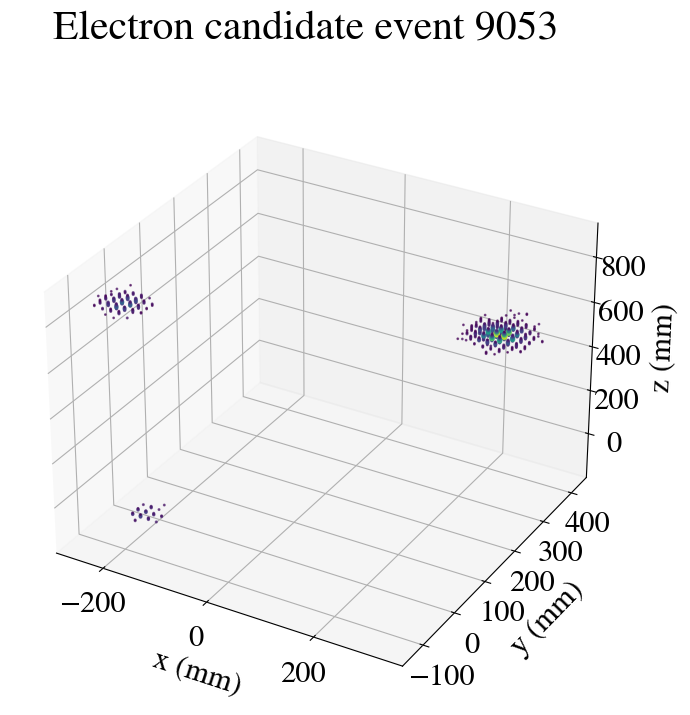

event 9053 post beersheba


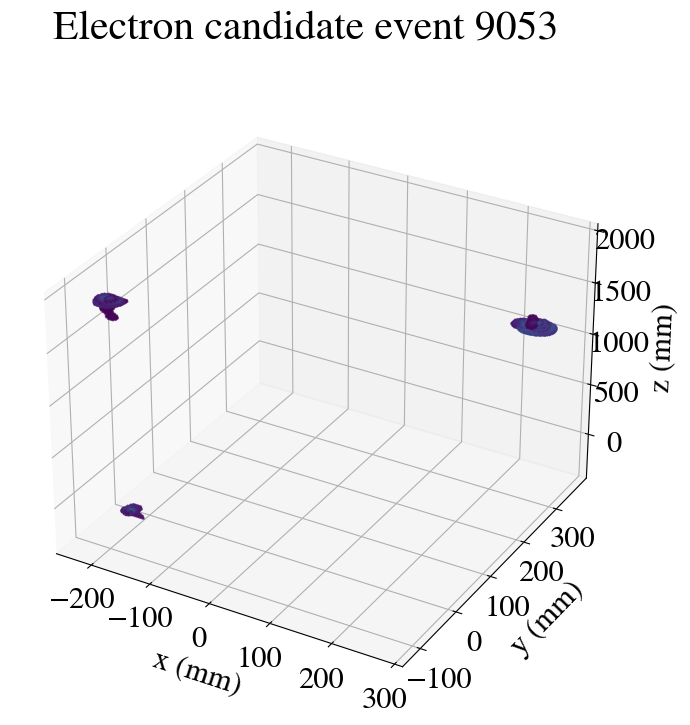

EVENT 9319
Number of tracks: 5
Energy of the event: 0.634157567721303
event 9319 pre beersheba
Time spent in cut_over_Q: 0.025551557540893555 s
Time spent in drop_isolated: 0.02458810806274414 s


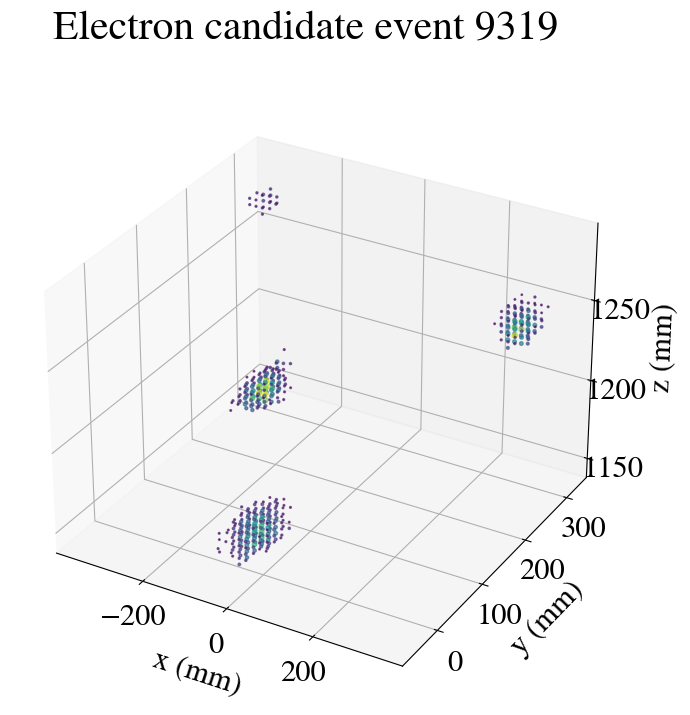

event 9319 post beersheba


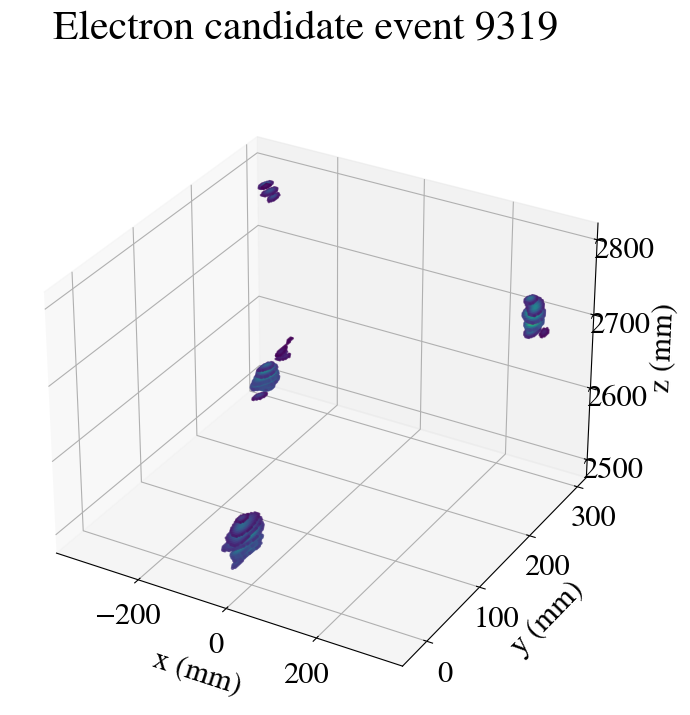

EVENT 4839
Number of tracks: 2
Energy of the event: 0.6432359654105734
event 4839 pre beersheba
Time spent in cut_over_Q: 0.08708620071411133 s
Time spent in drop_isolated: 0.023626089096069336 s


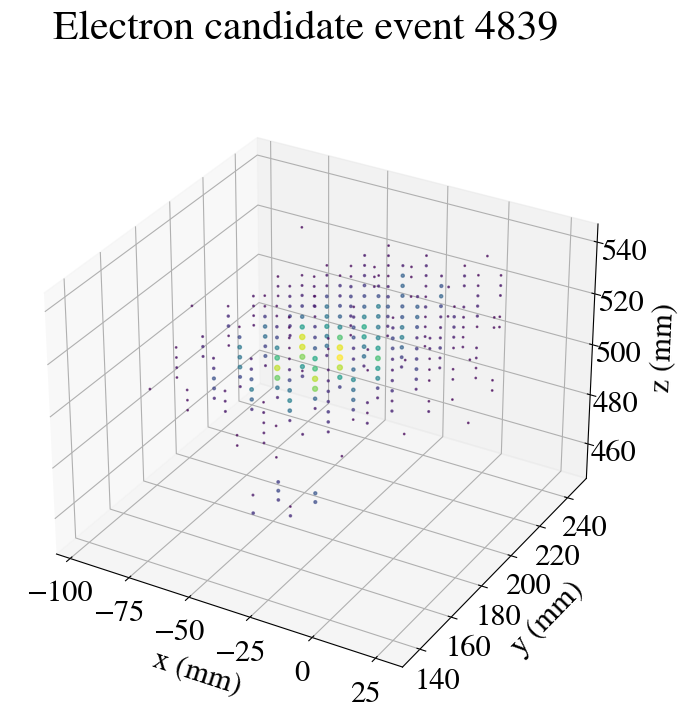

event 4839 post beersheba


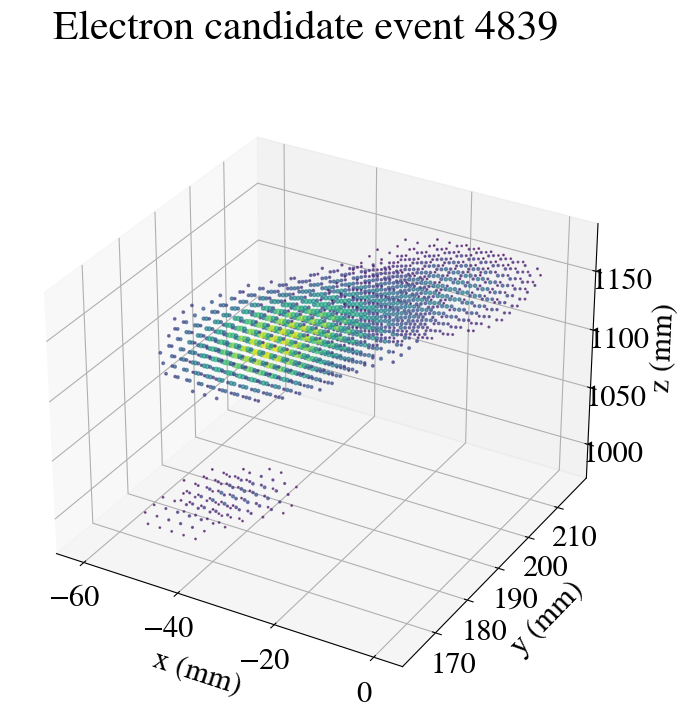

EVENT 4916
Number of tracks: 2
Energy of the event: 0.6188318694311326
event 4916 pre beersheba
Time spent in cut_over_Q: 0.1292581558227539 s
Time spent in drop_isolated: 0.01943230628967285 s


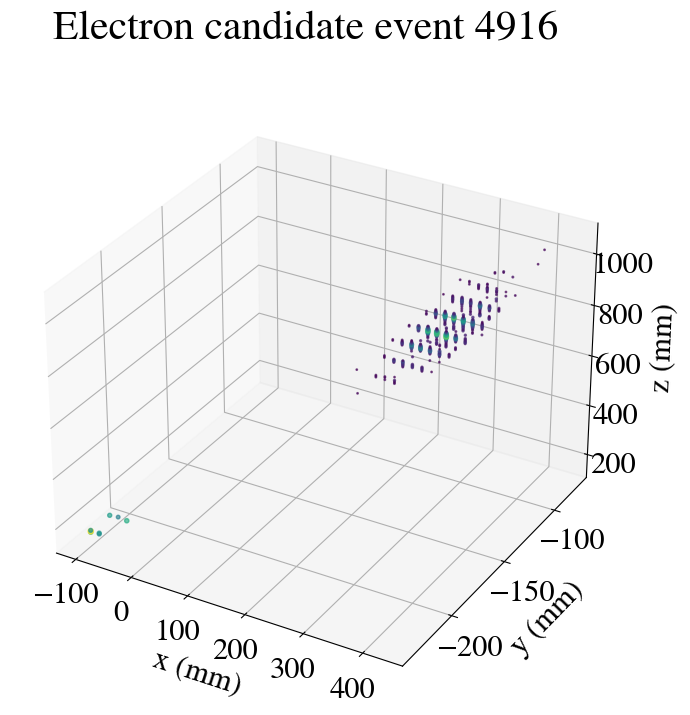

event 4916 post beersheba


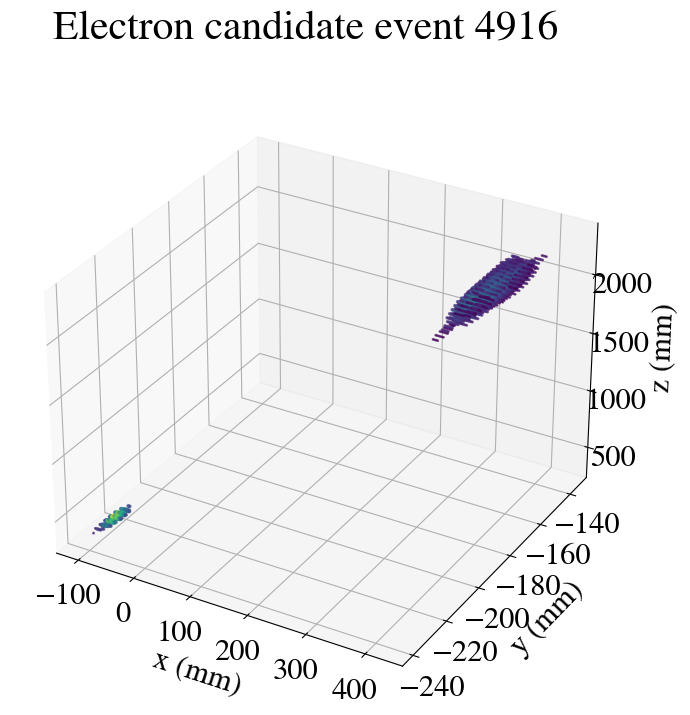

EVENT 5119
Number of tracks: 4
Energy of the event: 2.1062159767888957
event 5119 pre beersheba
Time spent in cut_over_Q: 0.019794940948486328 s
Time spent in drop_isolated: 0.041683197021484375 s


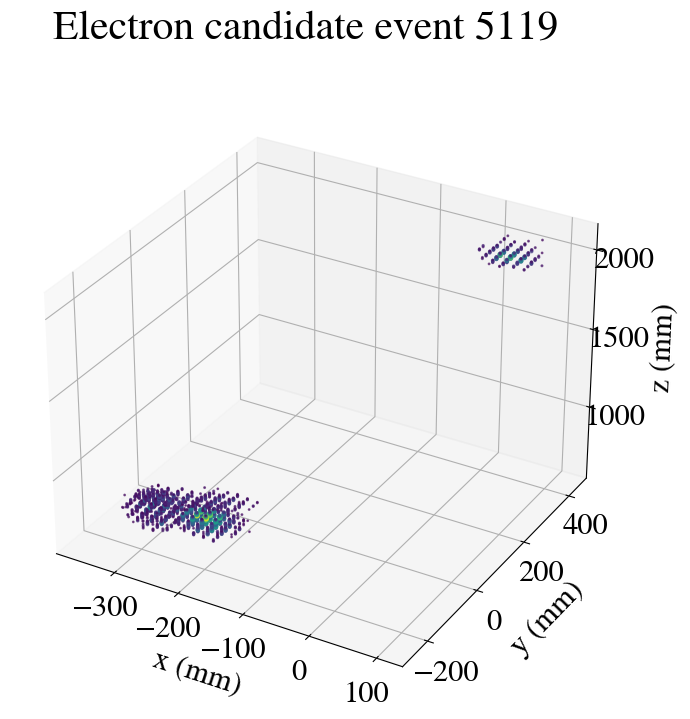

event 5119 post beersheba


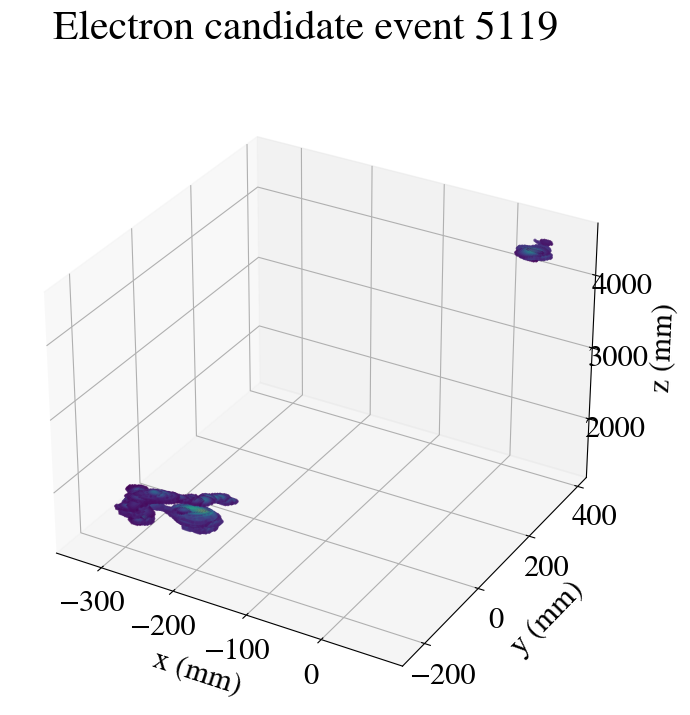

EVENT 5126
Number of tracks: 12
Energy of the event: 1.7465809446856653
event 5126 pre beersheba
Time spent in cut_over_Q: 0.04485154151916504 s
Time spent in drop_isolated: 0.05151224136352539 s


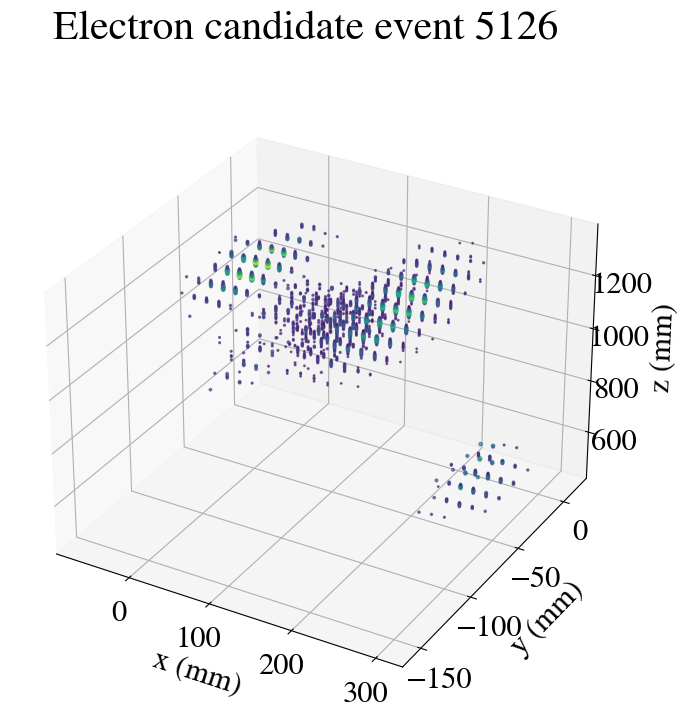

event 5126 post beersheba


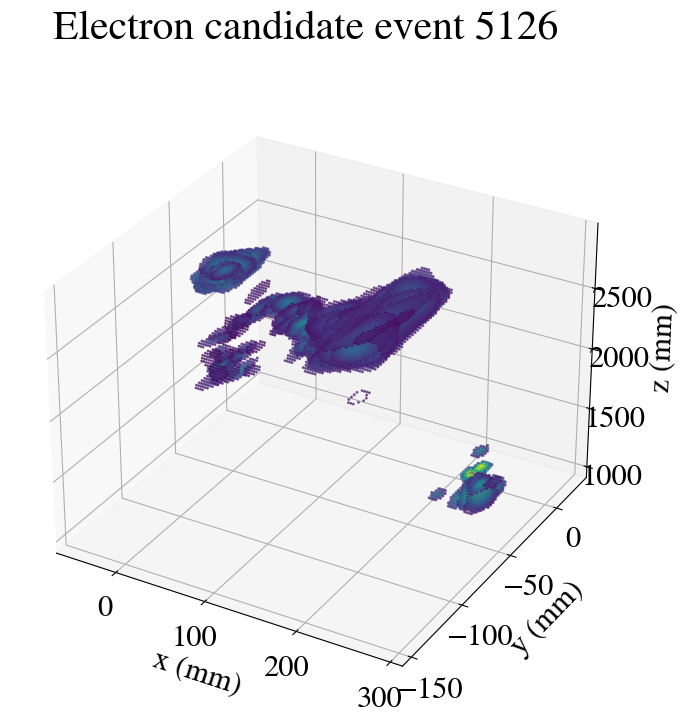

EVENT 7926
Number of tracks: 4
Energy of the event: 0.569173525630193
event 7926 pre beersheba
Time spent in cut_over_Q: 0.1761159896850586 s
Time spent in drop_isolated: 0.02926802635192871 s


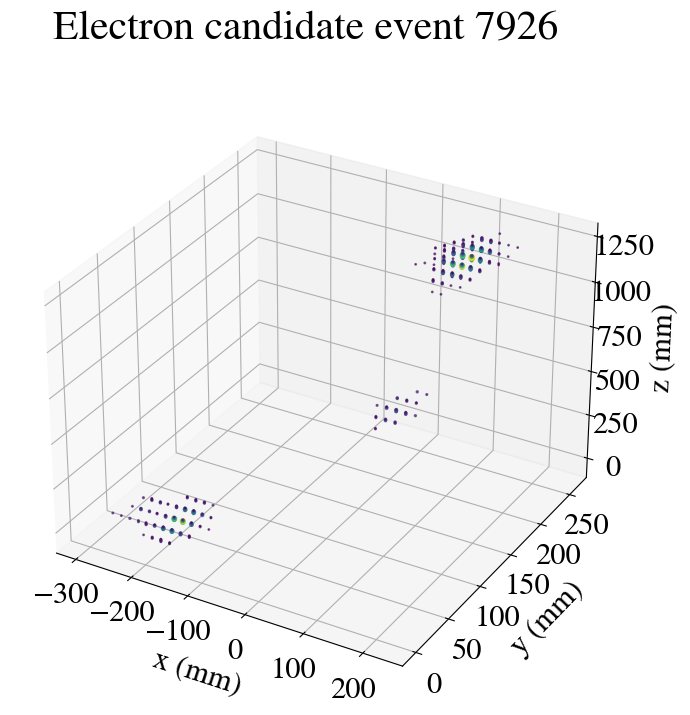

event 7926 post beersheba


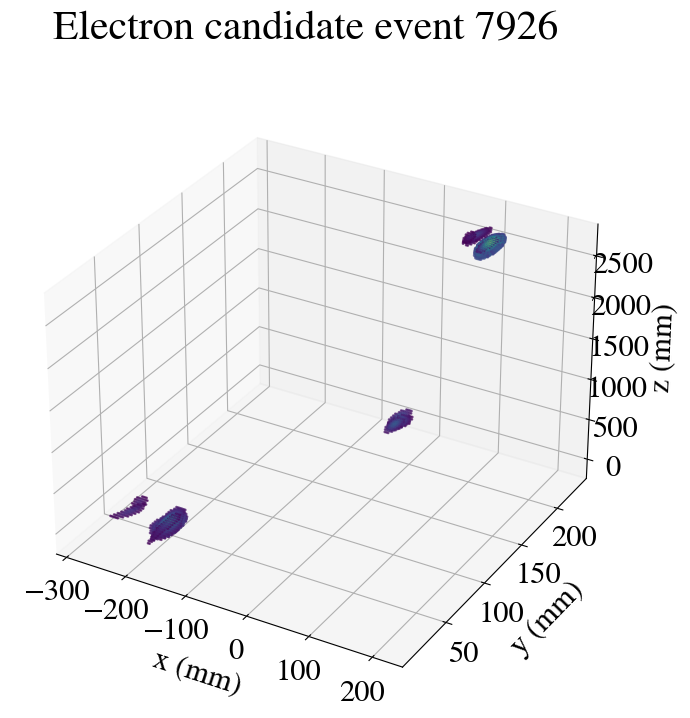

EVENT 11825
Number of tracks: 5
Energy of the event: 1.7551705806547417
event 11825 pre beersheba
Time spent in cut_over_Q: 0.03333878517150879 s
Time spent in drop_isolated: 0.034684181213378906 s


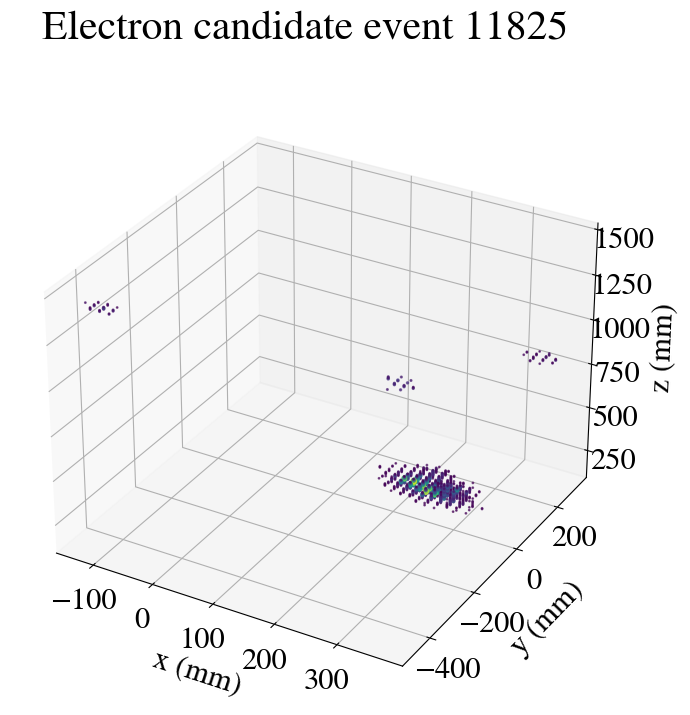

event 11825 post beersheba


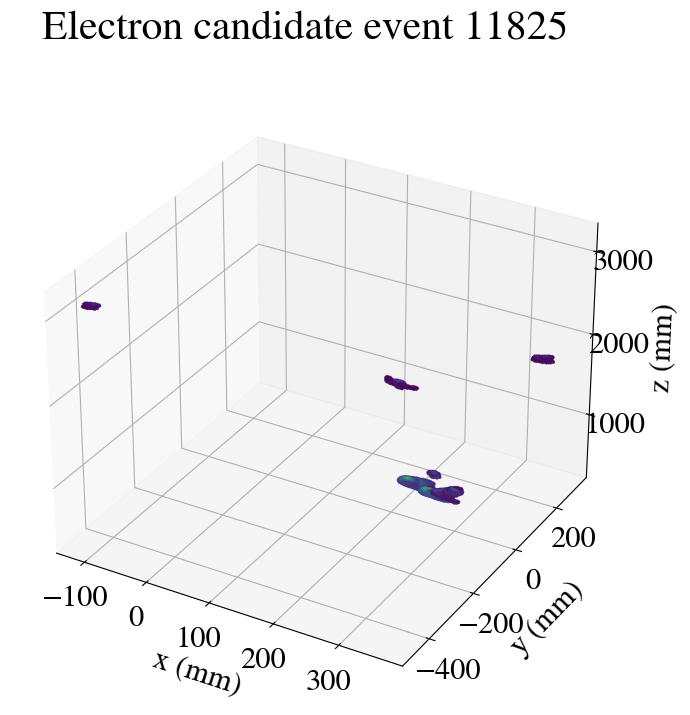

EVENT 11937
Number of tracks: 3
Energy of the event: 0.41531824115619825
event 11937 pre beersheba
Time spent in cut_over_Q: 0.34023118019104004 s
Time spent in drop_isolated: 0.04550290107727051 s


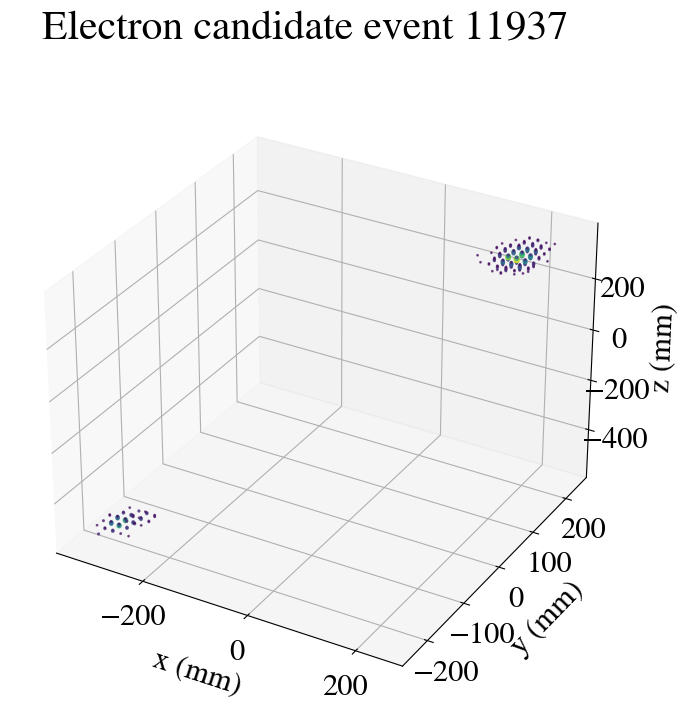

event 11937 post beersheba


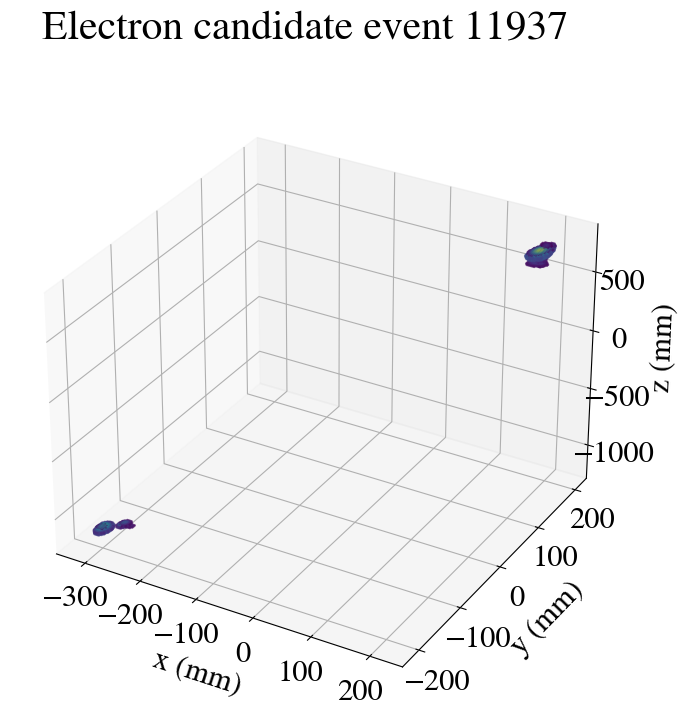

EVENT 14184
Number of tracks: 3
Energy of the event: 0.5434552033508356
event 14184 pre beersheba
Time spent in cut_over_Q: 0.030633926391601562 s
Time spent in drop_isolated: 0.025108814239501953 s


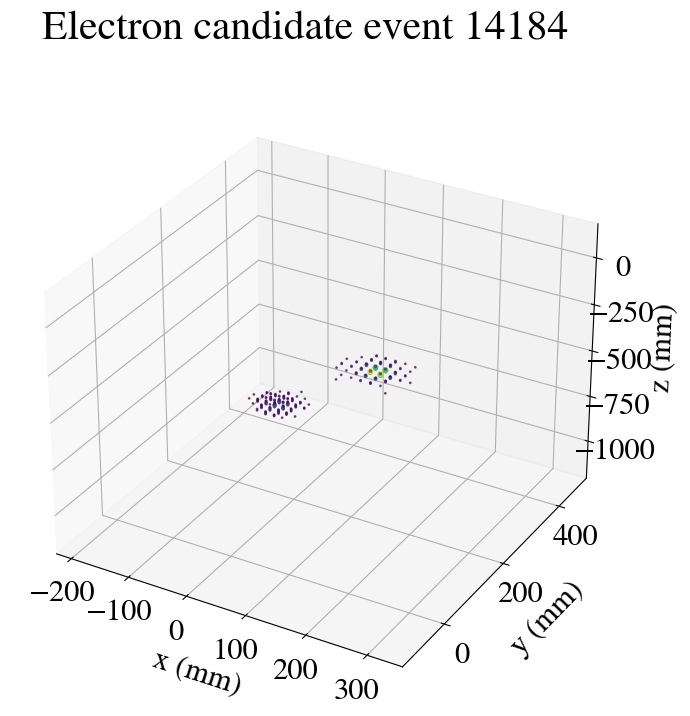

event 14184 post beersheba


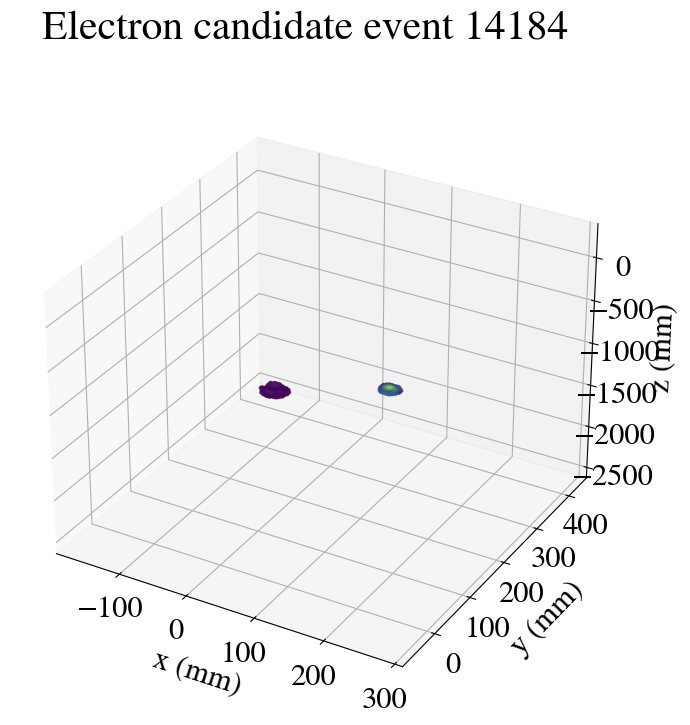

EVENT 8822
Number of tracks: 2
Energy of the event: 0.3696114883250743
event 8822 pre beersheba
Time spent in cut_over_Q: 0.2890133857727051 s
Time spent in drop_isolated: 0.04885244369506836 s


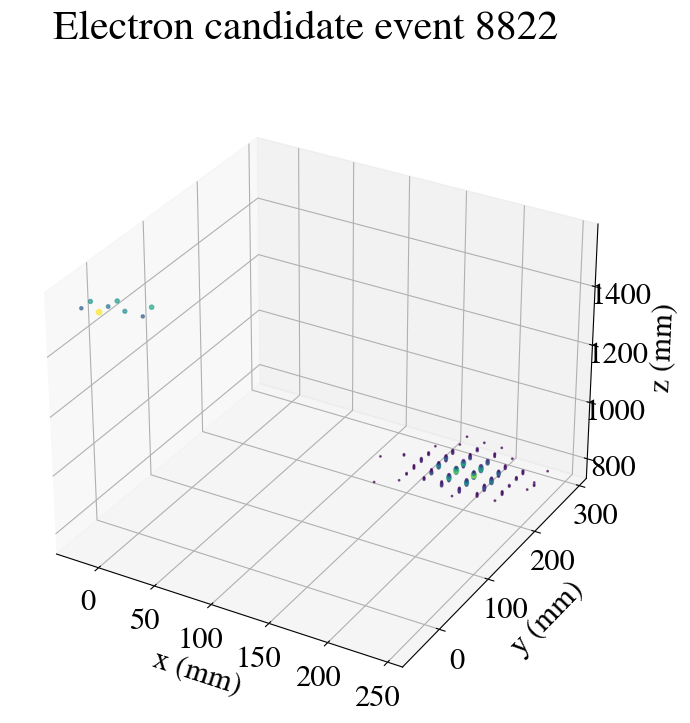

event 8822 post beersheba


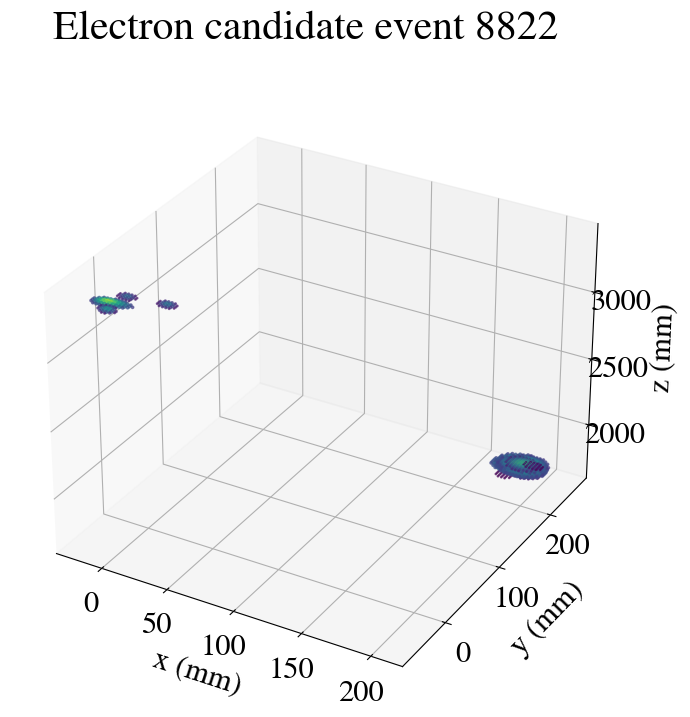

EVENT 16662
Number of tracks: 4
Energy of the event: 0.5794085304545424
event 16662 pre beersheba
Time spent in cut_over_Q: 0.1477961540222168 s
Time spent in drop_isolated: 0.02381443977355957 s


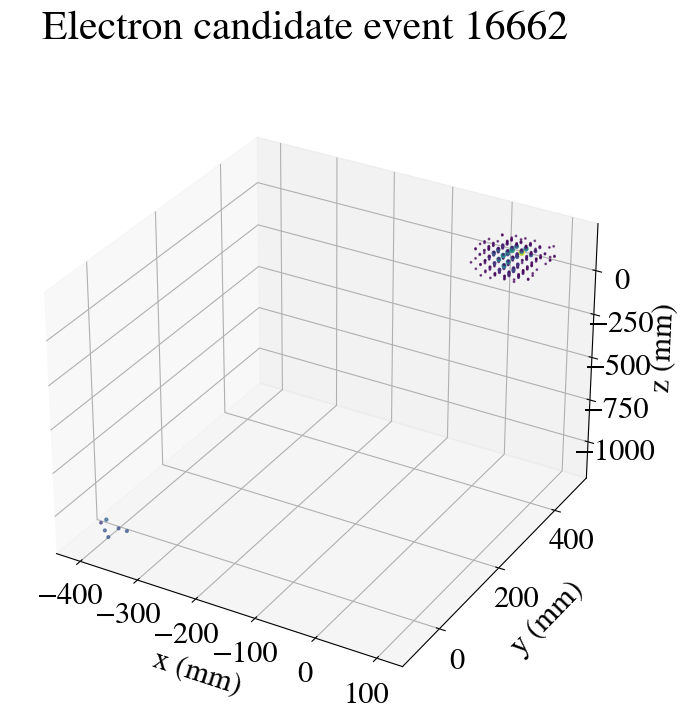

event 16662 post beersheba


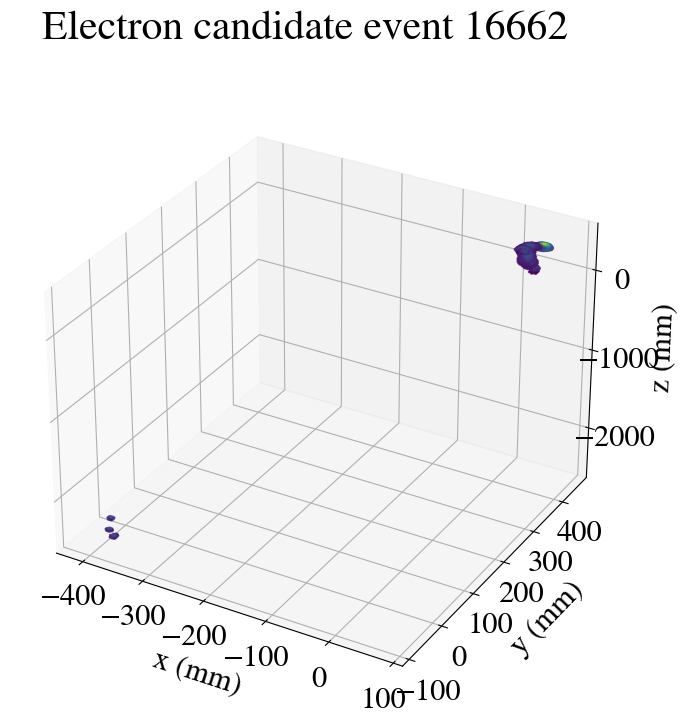

EVENT 22696
Number of tracks: 4
Energy of the event: 0.4880977703915081
event 22696 pre beersheba
Time spent in cut_over_Q: 0.4022231101989746 s
Time spent in drop_isolated: 0.07513976097106934 s


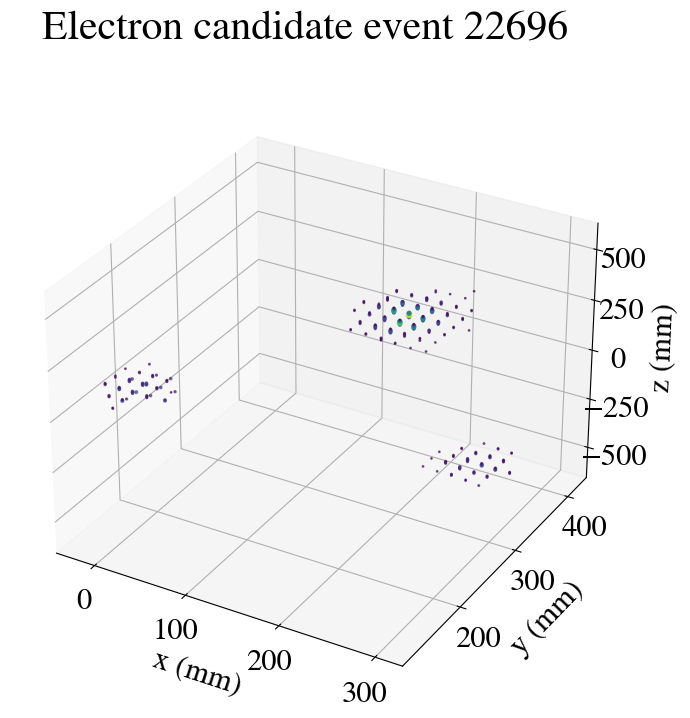

event 22696 post beersheba


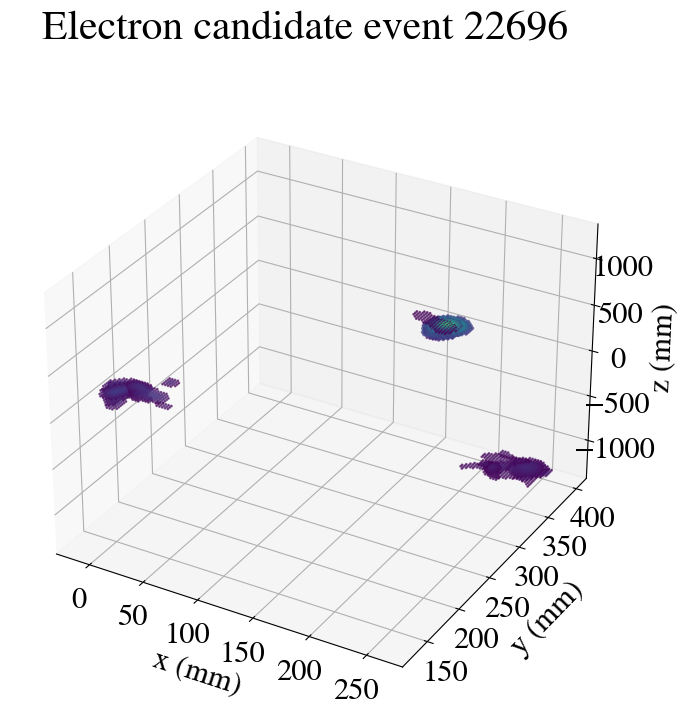

EVENT 22710
Number of tracks: 2
Energy of the event: 0.5638823651599377
event 22710 pre beersheba
Time spent in cut_over_Q: 0.06161332130432129 s
Time spent in drop_isolated: 0.03748321533203125 s


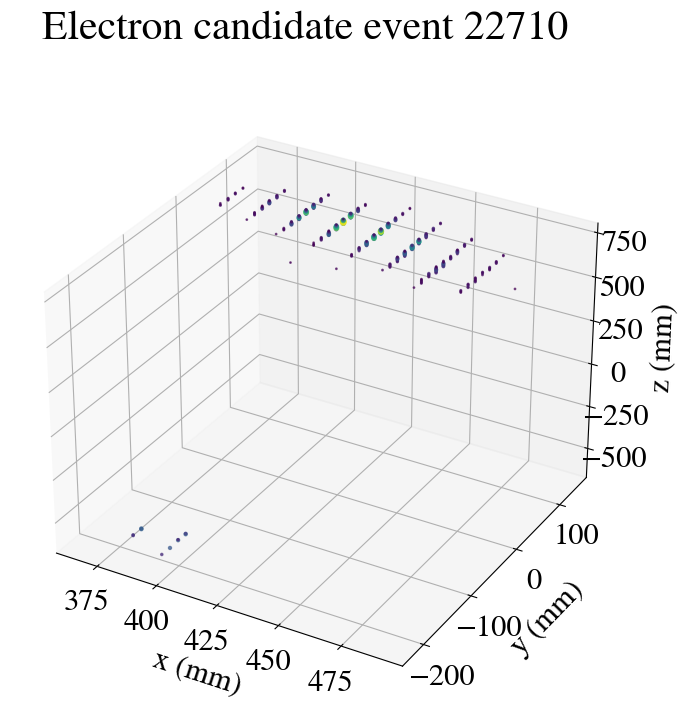

event 22710 post beersheba


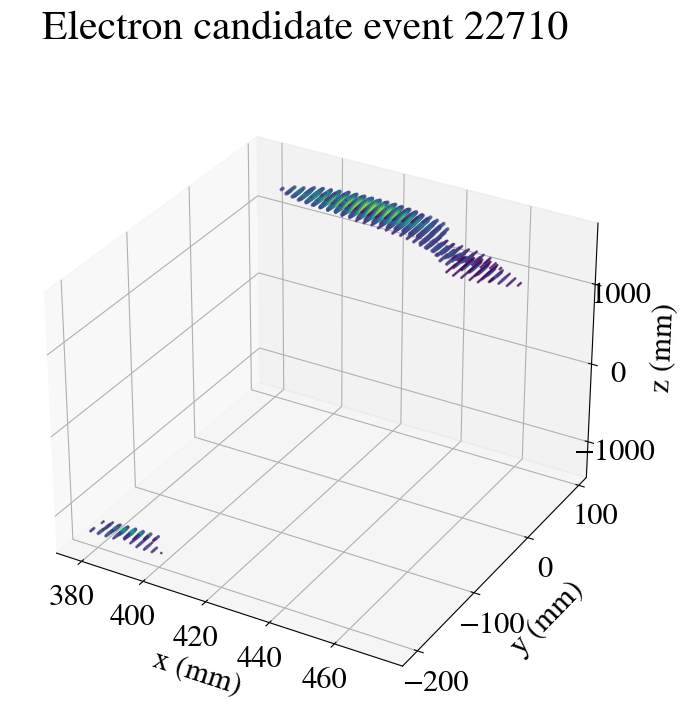

EVENT 22934
Number of tracks: 6
Energy of the event: 0.7829974156584135
event 22934 pre beersheba
Time spent in cut_over_Q: 0.15900182723999023 s
Time spent in drop_isolated: 0.055121660232543945 s


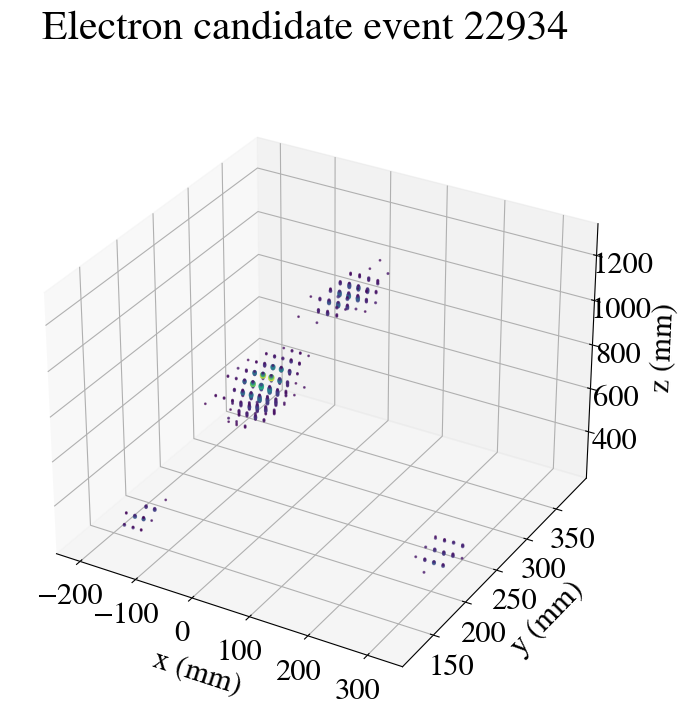

event 22934 post beersheba


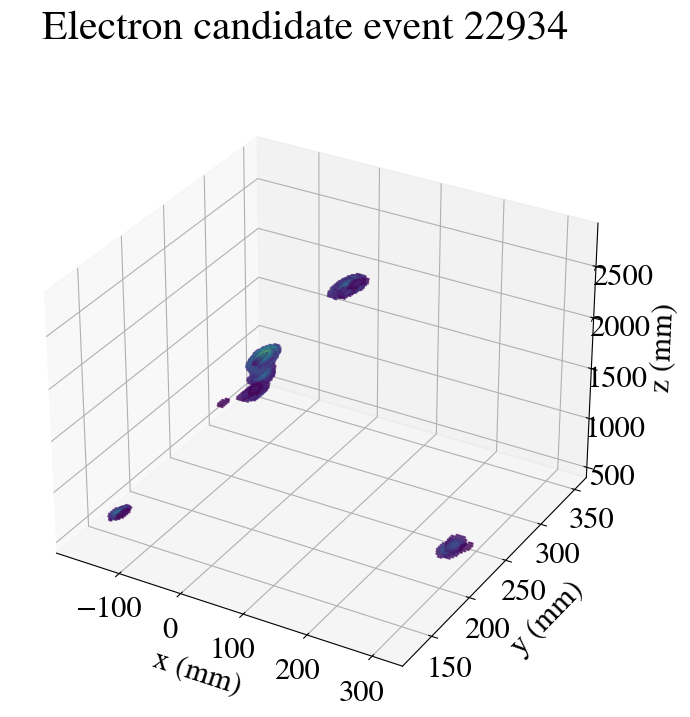

EVENT 23018
Number of tracks: 2
Energy of the event: 0.42489514717930893
event 23018 pre beersheba
Time spent in cut_over_Q: 0.3213369846343994 s
Time spent in drop_isolated: 0.03242778778076172 s


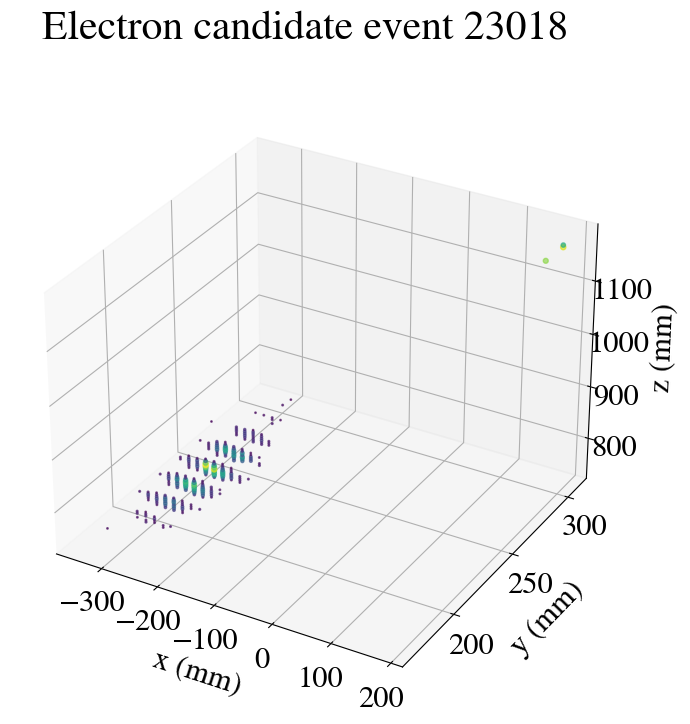

event 23018 post beersheba


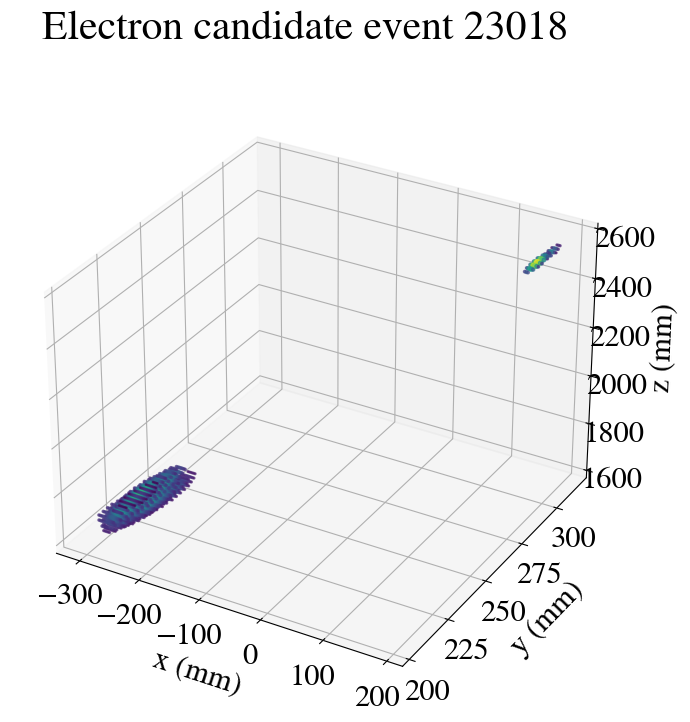

EVENT 16368
Number of tracks: 7
Energy of the event: 3.550473274323997
event 16368 pre beersheba
Time spent in cut_over_Q: 0.06569743156433105 s
Time spent in drop_isolated: 0.10137200355529785 s


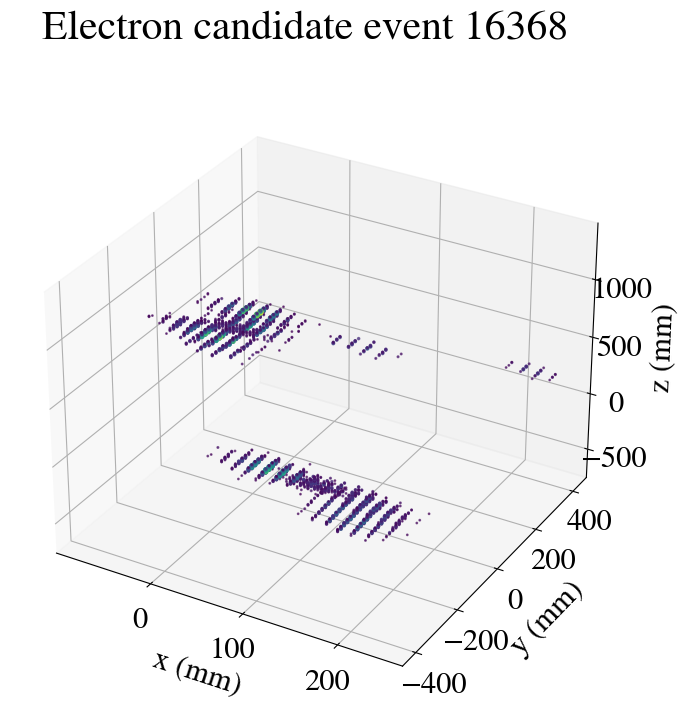

event 16368 post beersheba


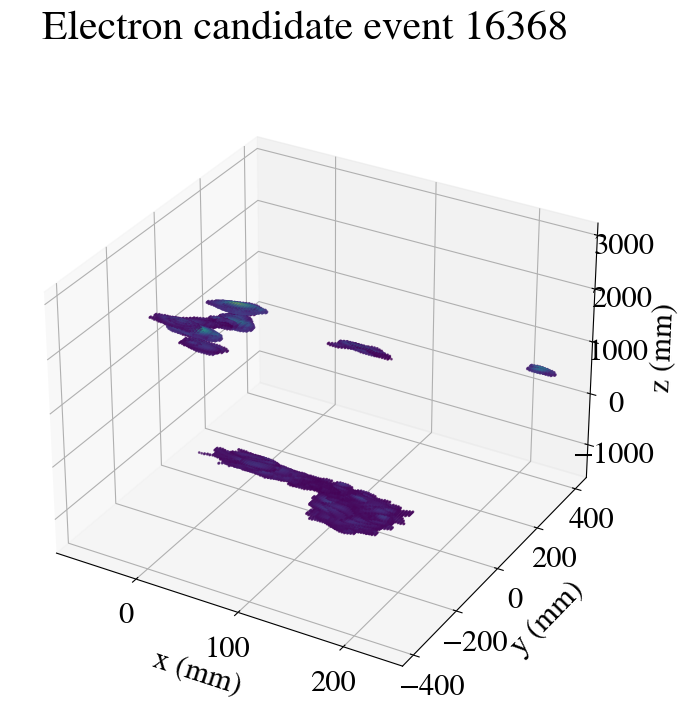

EVENT 19917
Number of tracks: 2
Energy of the event: 0.6050410368424681
event 19917 pre beersheba
Time spent in cut_over_Q: 0.15721368789672852 s
Time spent in drop_isolated: 0.02430558204650879 s


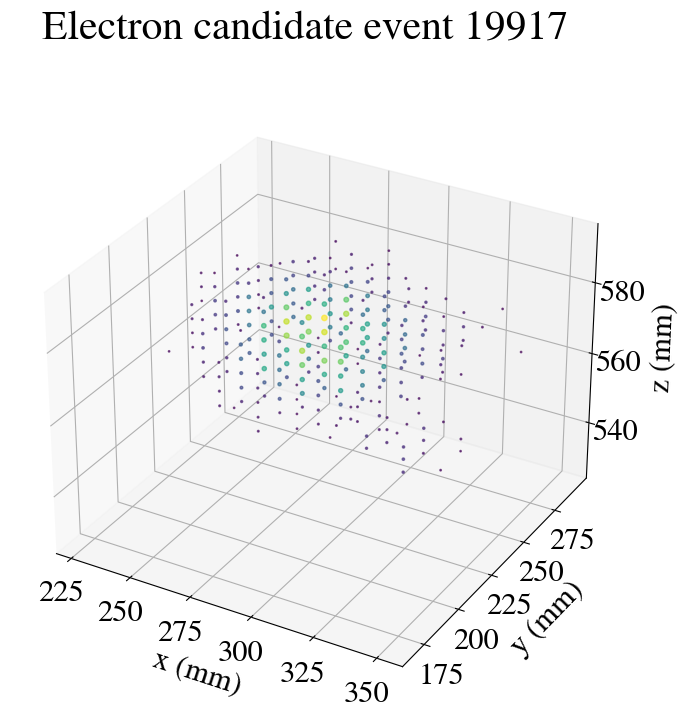

event 19917 post beersheba


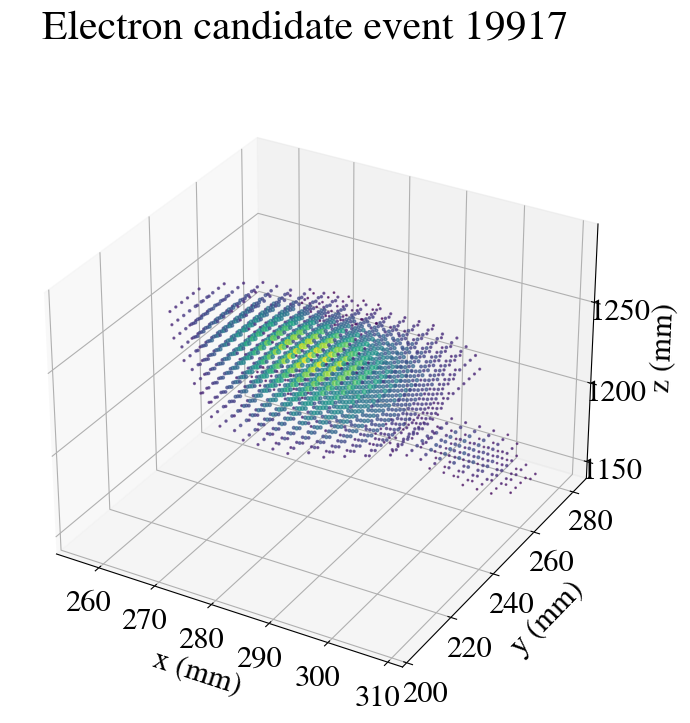

EVENT 20078
Number of tracks: 3
Energy of the event: 0.6048174859834308
event 20078 pre beersheba
Time spent in cut_over_Q: 0.0597681999206543 s
Time spent in drop_isolated: 0.015598297119140625 s


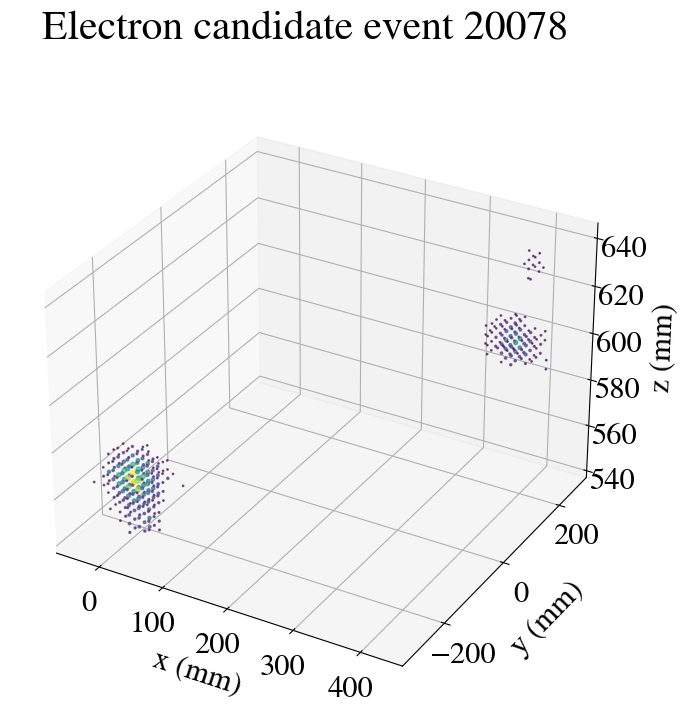

event 20078 post beersheba


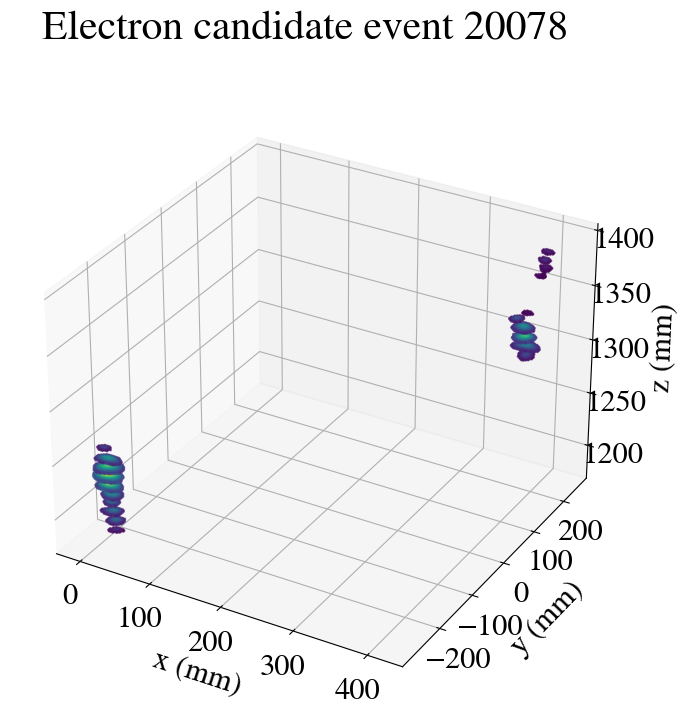

EVENT 20141
Number of tracks: 3
Energy of the event: 0.611983840824108
event 20141 pre beersheba
Time spent in cut_over_Q: 0.3114347457885742 s
Time spent in drop_isolated: 0.06785845756530762 s


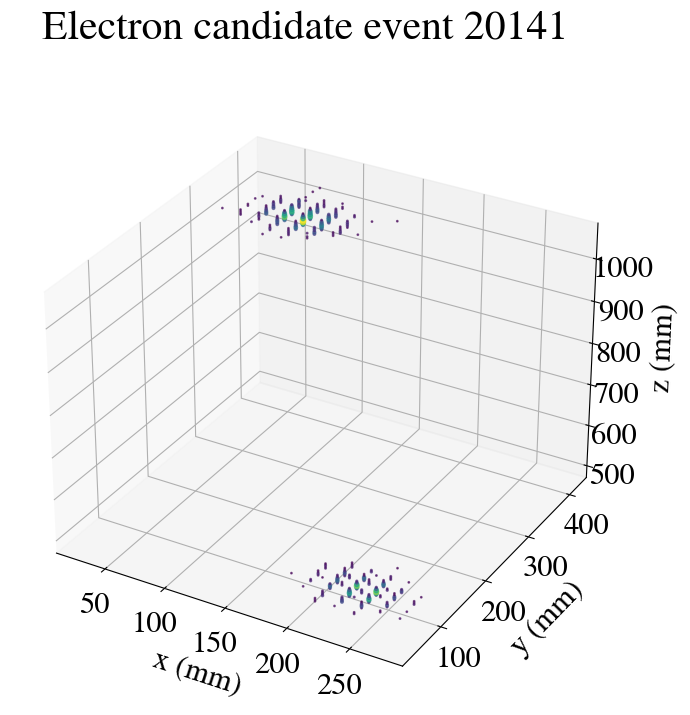

event 20141 post beersheba


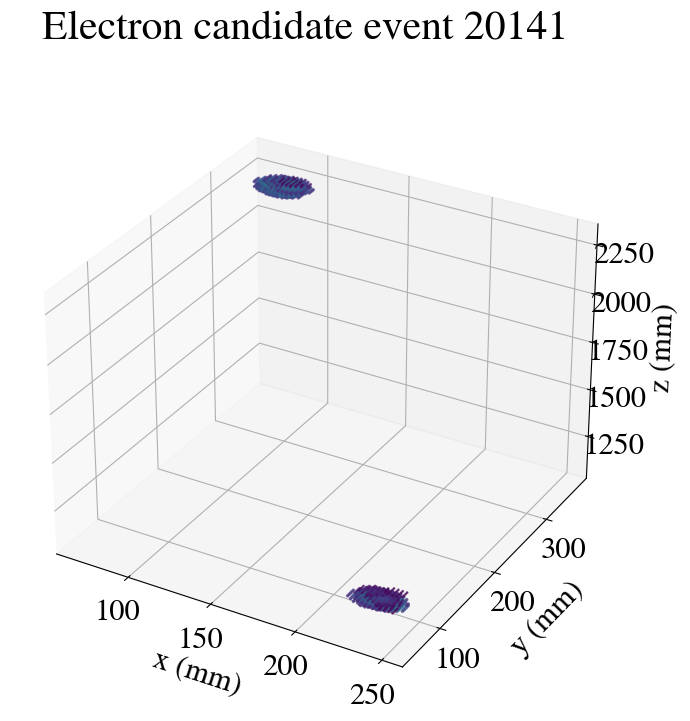

EVENT 20211
Number of tracks: 4
Energy of the event: 0.4962566332246194
event 20211 pre beersheba
Time spent in cut_over_Q: 0.2420201301574707 s
Time spent in drop_isolated: 0.03554964065551758 s


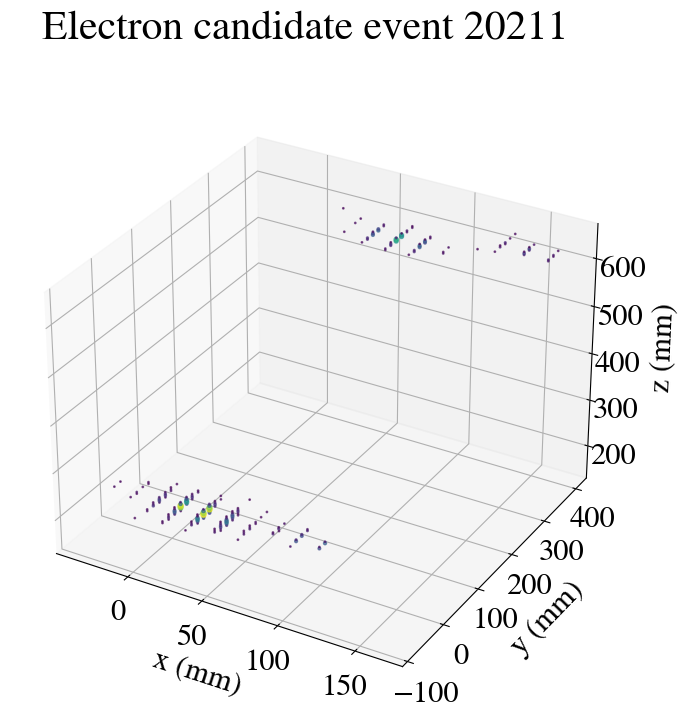

event 20211 post beersheba


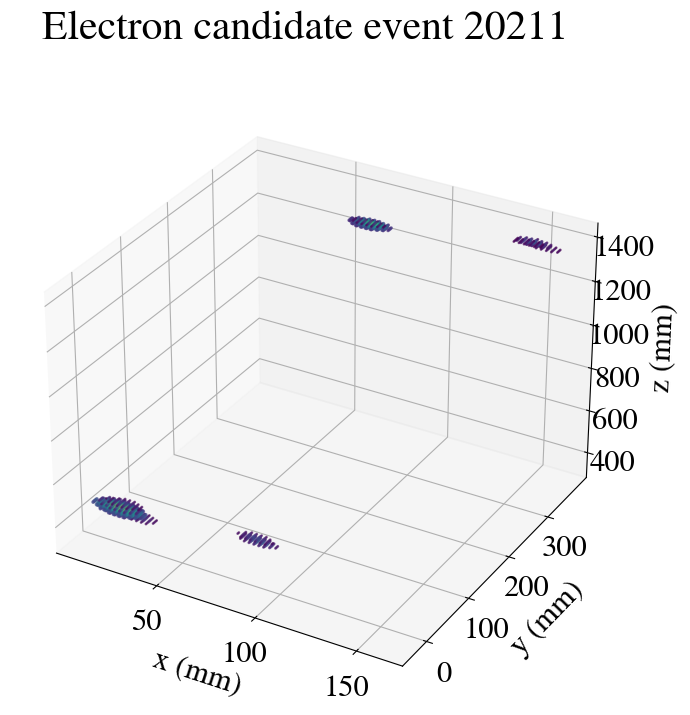

EVENT 20393
Number of tracks: 5
Energy of the event: 1.0134853549534544
event 20393 pre beersheba
Time spent in cut_over_Q: 0.07018518447875977 s
Time spent in drop_isolated: 0.06133460998535156 s


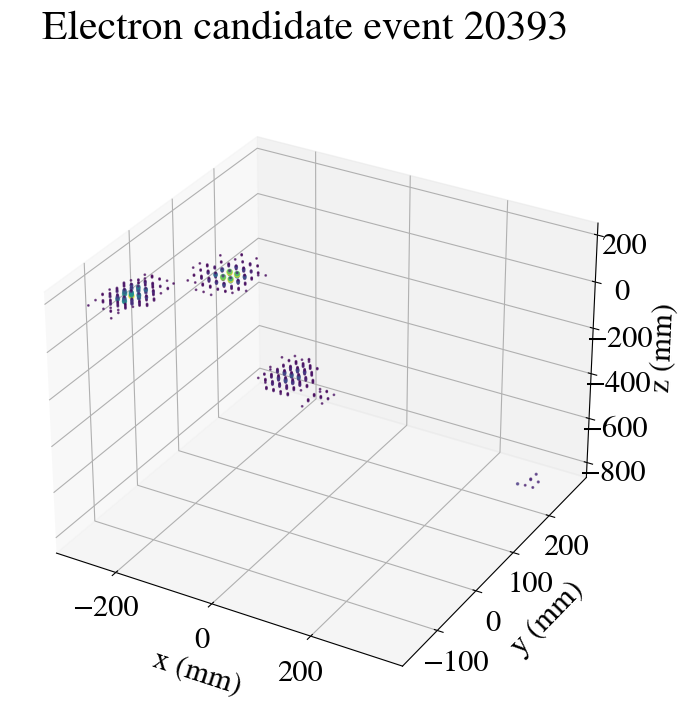

event 20393 post beersheba


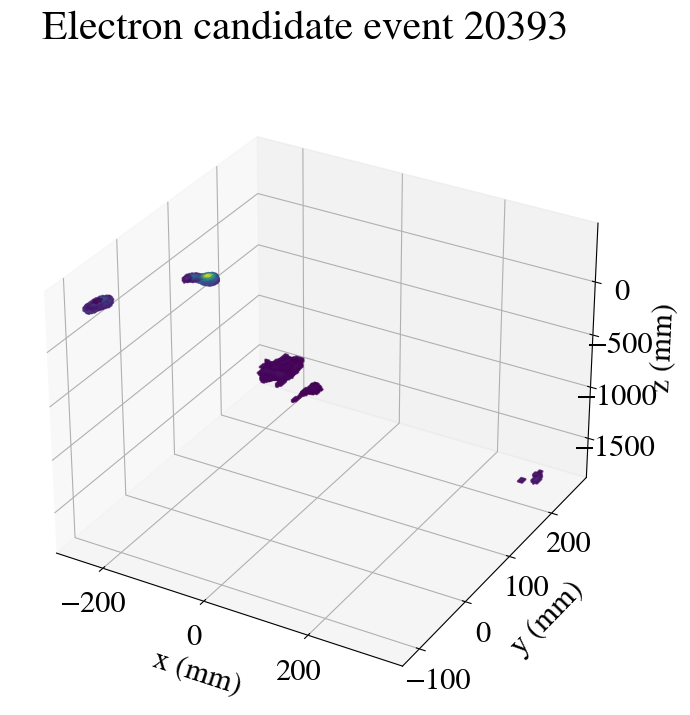

In [16]:
stopper = 20

for i, evt in enumerate(low_E_hits.event.unique()):
    print(f"EVENT {evt}\nNumber of tracks: {hdst[hdst.event == evt].numb_of_tracks.unique()[0]}")
    print(f"Energy of the event: {hdst[hdst.event == evt].energy.sum()}")
    print(f"event {evt} pre beersheba")
    func.plotter_3d(low_E_soph_hits, evt, cut_n_drop = True, clrbar = False, cut_sensors = cut_sensors, drop_sensors = drop_sensors)
    print(f"event {evt} post beersheba")
    func.plotter_3d(low_E_hits, evt, cut_n_drop = False, clrbar = False)
    
    if i > stopper:
        break


In [17]:
# how many of the events with low energy as a total exist within the window we care about?
low_E_energy = low_E_hits.groupby('event').sum()
low_E_energy = low_E_energy[low_E_energy.E > 1.5]



In [19]:
display(low_E_hits)
display(low_E_energy)

,event,time,npeak,Xpeak,Ypeak,nsipm,X,Y,Xrms,Yrms,Z,Q,E,Qc,Ec,track_id,Ep
2181,9053,1.742935e+09,8,-58.767006,11.236777,0,-218.875,-43.675,0.0,0.0,-289.029569,0.000056,0.000056,-1.0,0.000056,-1,NaN
2182,9053,1.742935e+09,8,-58.767006,11.236777,0,-218.875,-41.175,0.0,0.0,-289.029569,0.000084,0.000084,-1.0,0.000084,-1,NaN
2183,9053,1.742935e+09,8,-58.767006,11.236777,0,-218.875,-38.675,0.0,0.0,-289.029569,0.000091,0.000091,-1.0,0.000091,-1,NaN
2184,9053,1.742935e+09,8,-58.767006,11.236777,0,-218.875,-36.175,0.0,0.0,-289.029569,0.000072,0.000072,-1.0,0.000072,-1,NaN
2185,9053,1.742935e+09,8,-58.767006,11.236777,0,-216.375,-46.175,0.0,0.0,-289.029569,0.000053,0.000053,-1.0,0.000053,-1,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
64085671,2328174,1.742965e+09,18,-1.678470,-129.576151,0,1.125,-356.175,0.0,0.0,1725.468658,0.000035,0.000035,-1.0,0.000035,1,0.000035
64085672,2328174,1.742965e+09,18,-1.678470,-129.576151,0,1.125,-353.675,0.0,0.0,1725.468658,0.000030,0.000030,-1.0,0.000030,1,0.000030
64085673,2328174,1.742965e+09,18,-1.678470,-129.576151,0,1.125,-351.175,0.0,0.0,1725.468658,0.000017,0.000017,-1.0,0.000017,1,0.000017
64085674,2328174,1.742965e+09,18,-1.678470,-129.576151,0,3.625,-356.175,0.0,0.0,1725.468658,0.000015,0.000015,-1.0,0.000015,1,0.000015


,time,npeak,Xpeak,Ypeak,nsipm,X,Y,Xrms,Yrms,Z,Q,E,Qc,Ec,track_id,Ep
event,,,,,,,,,,,,,,,,
1325,9.711635e+12,5042.0,-6.803560e+05,-5.474630e+05,0.0,-1651026.500,-1335947.100,0.0,0.0,1.672496e+06,1.965410,1.965410,-5572.0,1.965410,3029,1.965410
2963,2.172046e+13,100210.0,-3.552268e+05,2.172108e+05,0.0,-745197.750,125177.150,0.0,0.0,3.287773e+07,2.753516,2.753516,-12462.0,2.753516,7345,2.753516
4020,2.027557e+13,171.0,1.359470e+06,-4.571685e+05,0.0,2316294.625,-699726.275,0.0,0.0,1.669041e+07,2.330728,2.330728,-11633.0,2.330728,4288,2.330728
5119,2.023374e+13,1100.0,-1.230440e+06,-3.568611e+05,0.0,-2712597.375,-1046268.075,0.0,0.0,2.163631e+07,2.106216,2.106216,-11609.0,2.106216,2329,2.106216
5126,2.980071e+13,51945.0,1.454647e+06,-4.639774e+05,0.0,2480160.250,-1228522.650,0.0,0.0,4.421022e+07,1.746581,1.746581,-17098.0,1.746581,8749,1.746581
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2323974,1.726233e+13,28213.0,9.512544e+05,1.383417e+06,0.0,1975879.500,2714245.300,0.0,0.0,1.322943e+07,2.377131,2.377131,-9904.0,2.377131,12952,2.377131
2325003,1.433240e+13,243311.0,2.319268e+05,1.272392e+06,0.0,382293.375,2839447.975,0.0,0.0,2.820251e+07,1.840416,1.840416,-8223.0,1.840416,4915,1.840416
2325017,1.111837e+13,9645.0,5.781569e+05,1.012567e+06,0.0,976783.875,1733647.175,0.0,0.0,9.426493e+06,2.059815,2.059815,-6379.0,2.059815,218,2.059815


In [20]:
DEP_E_hits = low_E_hits[low_E_hits.event.isin(low_E_energy.reset_index().event.values)]
# group low_E_hits by event and sum their energy

display(DEP_E_hits)

,event,time,npeak,Xpeak,Ypeak,nsipm,X,Y,Xrms,Yrms,Z,Q,E,Qc,Ec,track_id,Ep
13105,5119,1.742935e+09,0,-121.380348,-57.524002,0,-233.875,-123.675,0.0,0.0,1381.263233,0.000071,0.000071,-1.0,0.000071,0,0.000071
13106,5119,1.742935e+09,0,-121.380348,-57.524002,0,-233.875,-121.175,0.0,0.0,1381.263233,0.000088,0.000088,-1.0,0.000088,0,0.000088
13107,5119,1.742935e+09,0,-121.380348,-57.524002,0,-233.875,-118.675,0.0,0.0,1381.263233,0.000090,0.000090,-1.0,0.000090,0,0.000090
13108,5119,1.742935e+09,0,-121.380348,-57.524002,0,-233.875,-116.175,0.0,0.0,1381.263233,0.000076,0.000076,-1.0,0.000076,0,0.000076
13109,5119,1.742935e+09,0,-121.380348,-57.524002,0,-231.375,-123.675,0.0,0.0,1381.263233,0.000098,0.000098,-1.0,0.000098,0,0.000098
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
64052569,2326389,1.742965e+09,1,37.819114,114.405563,0,248.625,348.825,0.0,0.0,1030.269465,0.000071,0.000071,-1.0,0.000071,-1,NaN
64052570,2326389,1.742965e+09,1,37.819114,114.405563,0,248.625,351.325,0.0,0.0,1030.269465,0.000054,0.000054,-1.0,0.000054,-1,NaN
64052571,2326389,1.742965e+09,1,37.819114,114.405563,0,248.625,353.825,0.0,0.0,1030.269465,0.000031,0.000031,-1.0,0.000031,-1,NaN
64052572,2326389,1.742965e+09,1,37.819114,114.405563,0,251.125,346.325,0.0,0.0,1030.269465,0.000030,0.000030,-1.0,0.000030,-1,NaN


EVENT 5119
Number of tracks: 4
Energy of the event: 2.1062159767888957
event 5119 pre beersheba
Time spent in cut_over_Q: 0.030426740646362305 s
Time spent in drop_isolated: 0.05451011657714844 s


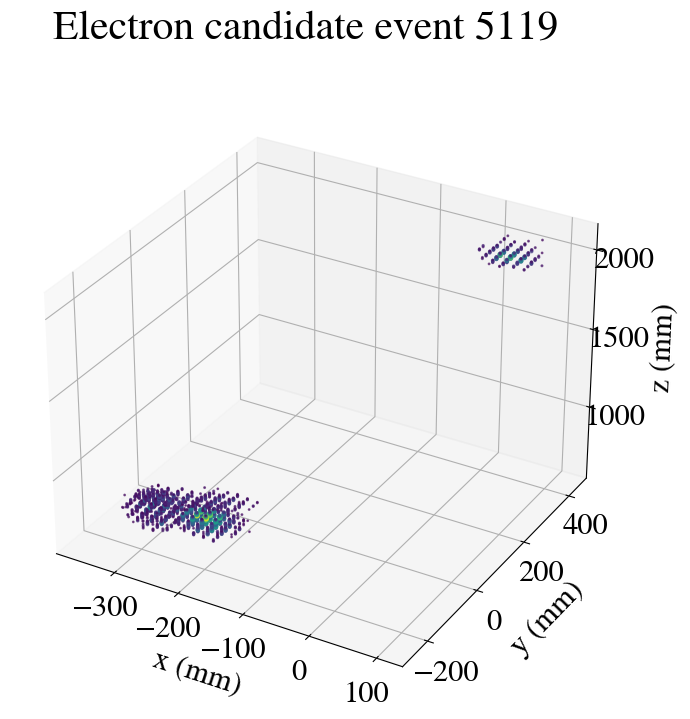

event 5119 post beersheba


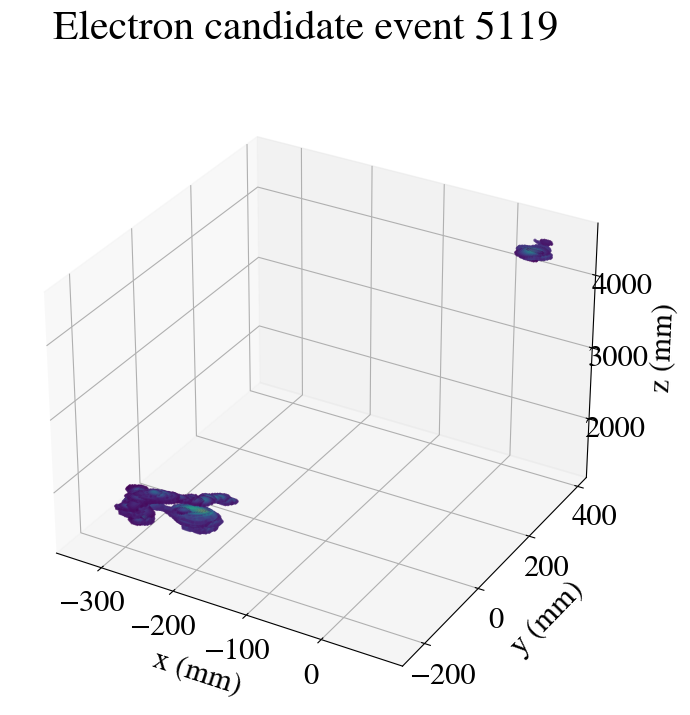

EVENT 5126
Number of tracks: 12
Energy of the event: 1.7465809446856653
event 5126 pre beersheba
Time spent in cut_over_Q: 0.07825255393981934 s
Time spent in drop_isolated: 0.0972747802734375 s


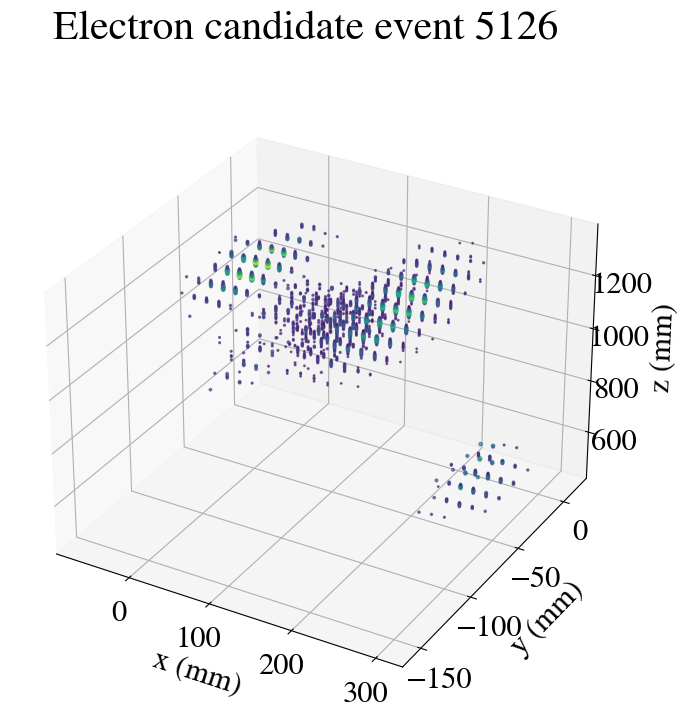

event 5126 post beersheba


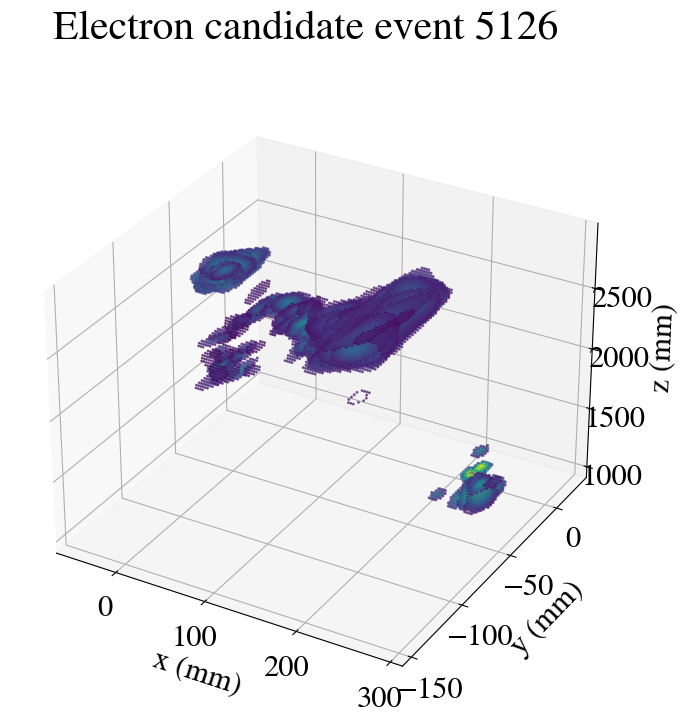

EVENT 11825
Number of tracks: 5
Energy of the event: 1.7551705806547417
event 11825 pre beersheba
Time spent in cut_over_Q: 0.038590431213378906 s
Time spent in drop_isolated: 0.03987550735473633 s


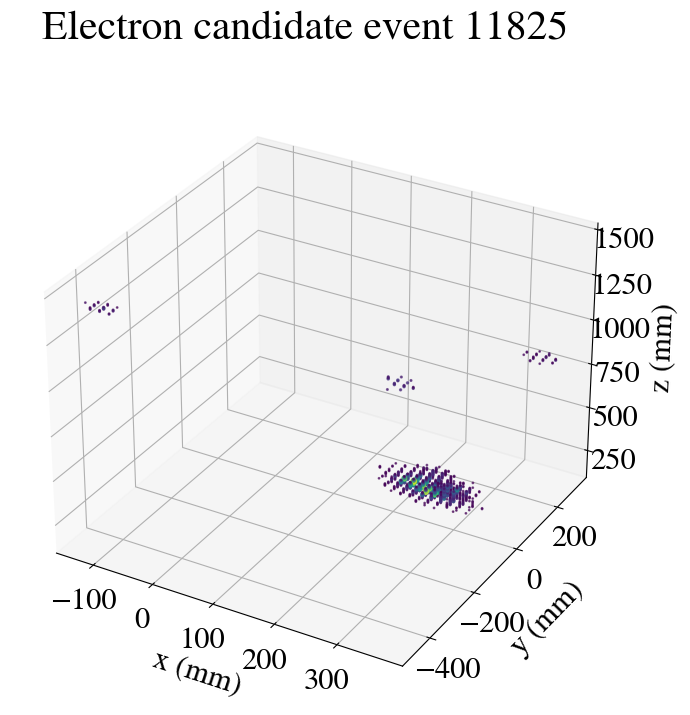

event 11825 post beersheba


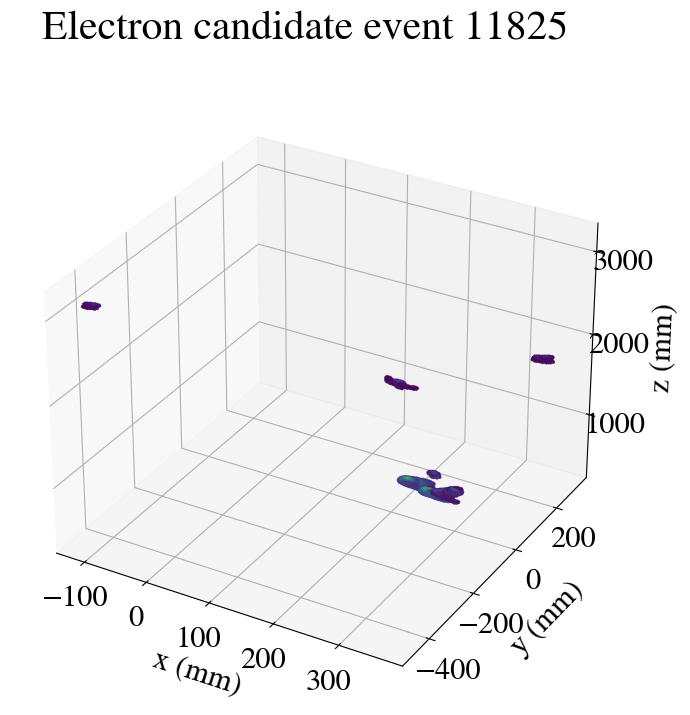

EVENT 16368
Number of tracks: 7
Energy of the event: 3.550473274323997
event 16368 pre beersheba
Time spent in cut_over_Q: 0.06190347671508789 s
Time spent in drop_isolated: 0.23006582260131836 s


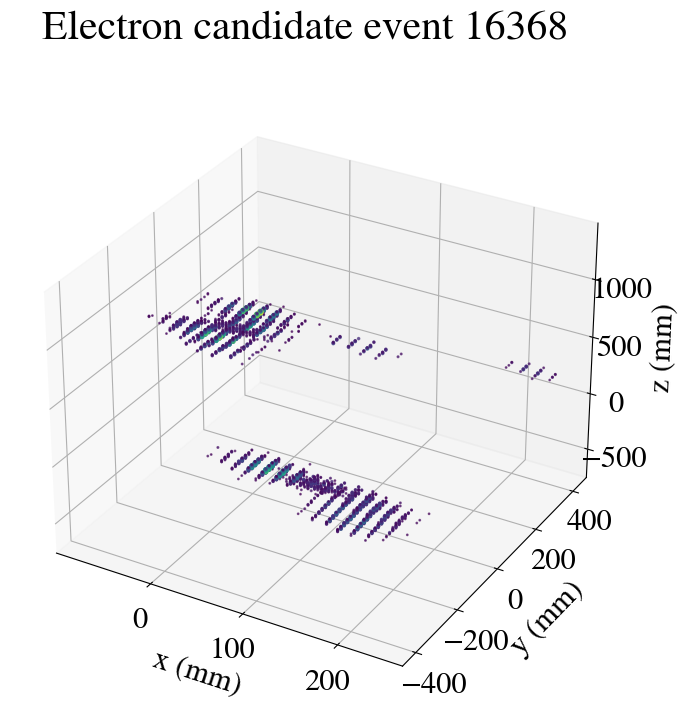

event 16368 post beersheba


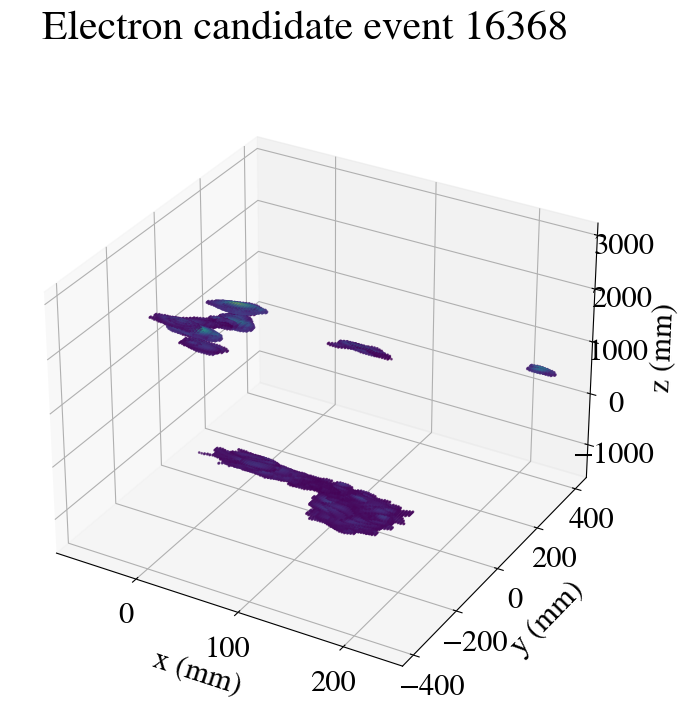

EVENT 27946
Number of tracks: 3
Energy of the event: 2.2460487399306777
event 27946 pre beersheba
Time spent in cut_over_Q: 0.05719494819641113 s
Time spent in drop_isolated: 0.09907174110412598 s


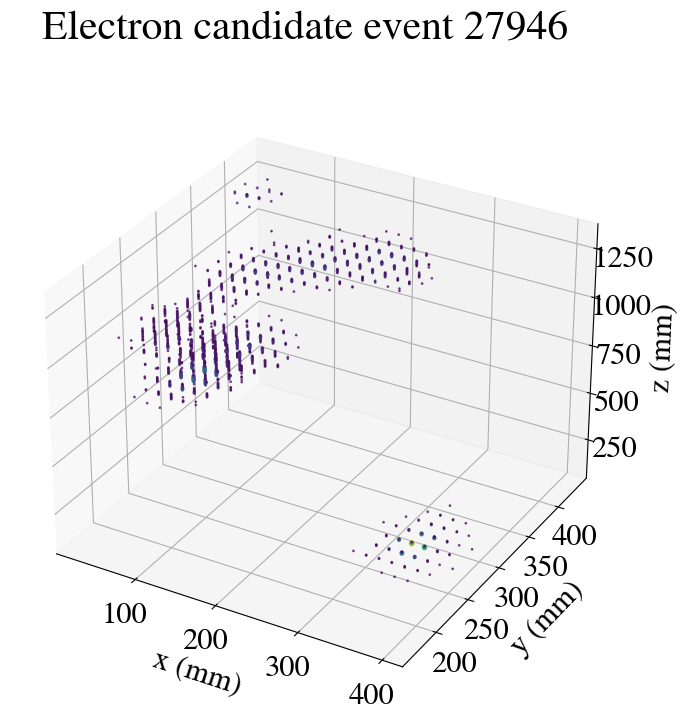

event 27946 post beersheba


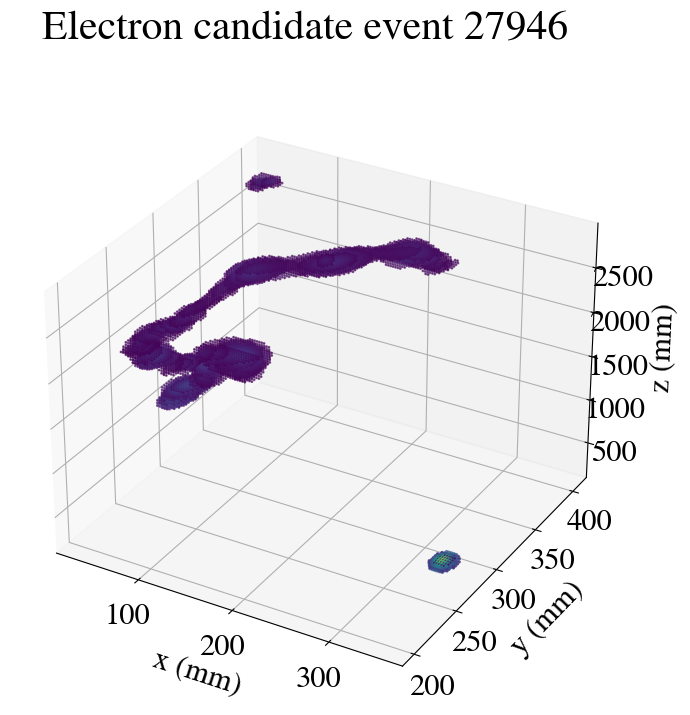

EVENT 19833
Number of tracks: 11
Energy of the event: 2.2035745393515915
event 19833 pre beersheba
Time spent in cut_over_Q: 0.18930959701538086 s
Time spent in drop_isolated: 0.0803978443145752 s


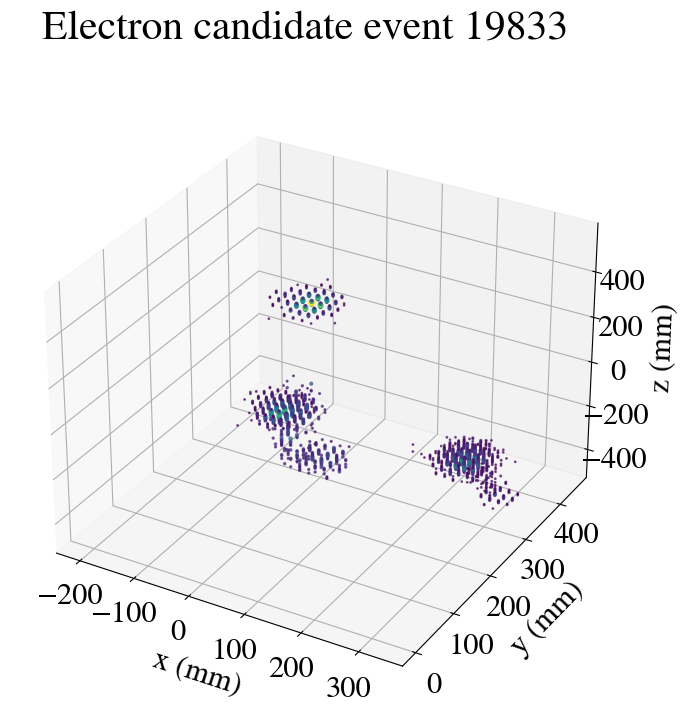

event 19833 post beersheba


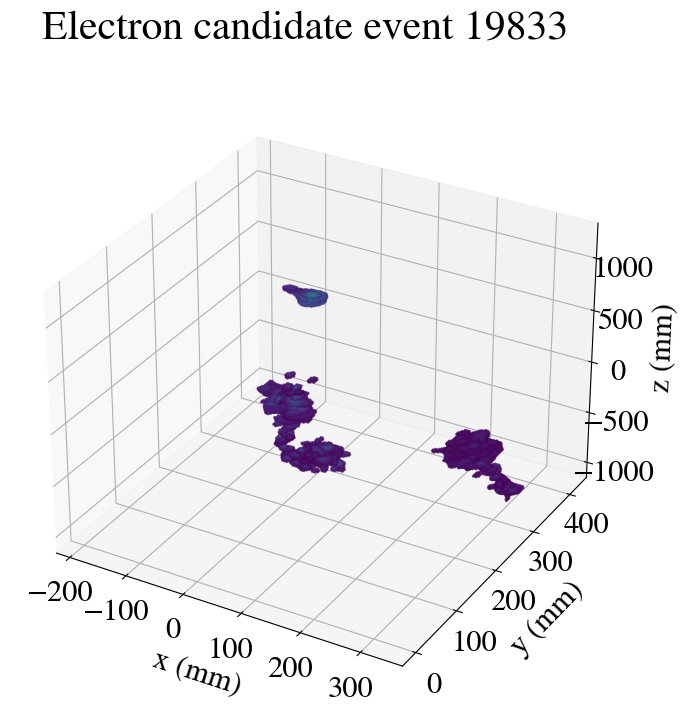

EVENT 28695
Number of tracks: 4
Energy of the event: 2.674367696472633
event 28695 pre beersheba
Time spent in cut_over_Q: 0.06565308570861816 s
Time spent in drop_isolated: 0.08672618865966797 s


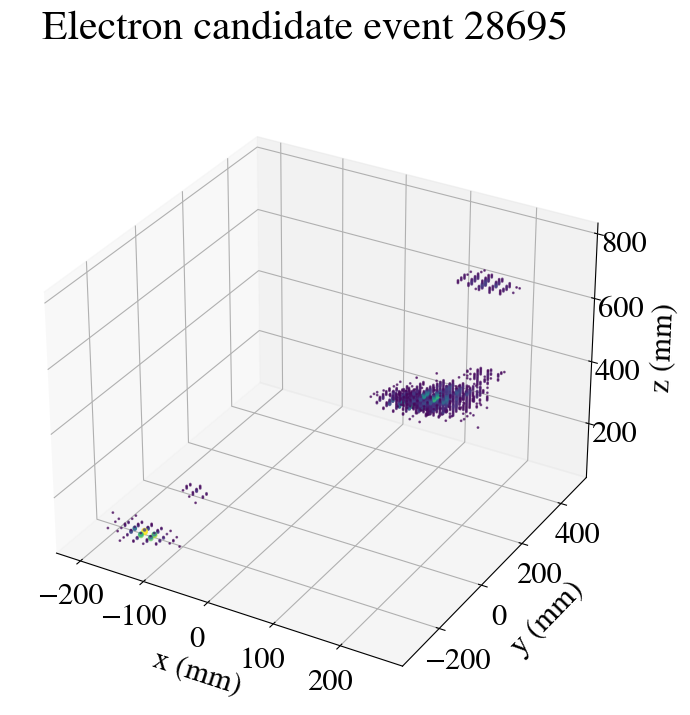

event 28695 post beersheba


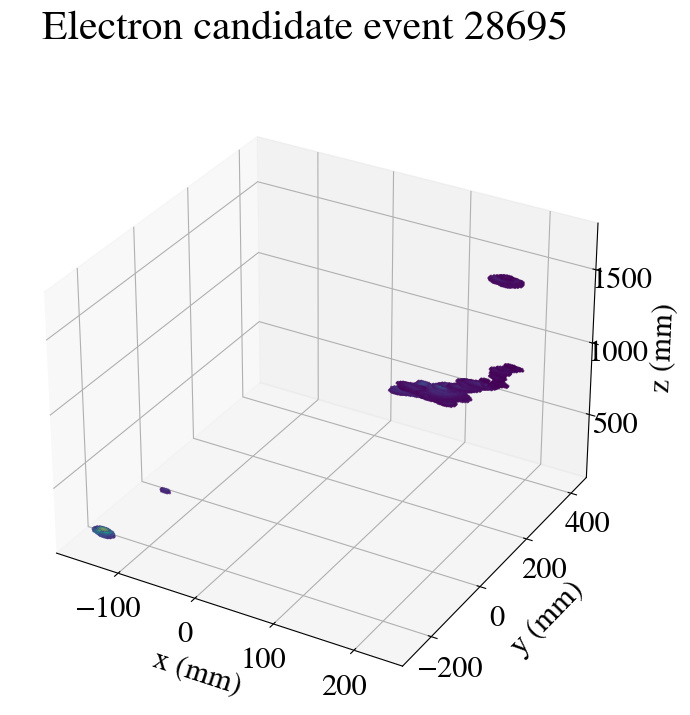

EVENT 25944
Number of tracks: 5
Energy of the event: 2.220332832266139
event 25944 pre beersheba
Time spent in cut_over_Q: 0.0554659366607666 s
Time spent in drop_isolated: 0.09857964515686035 s


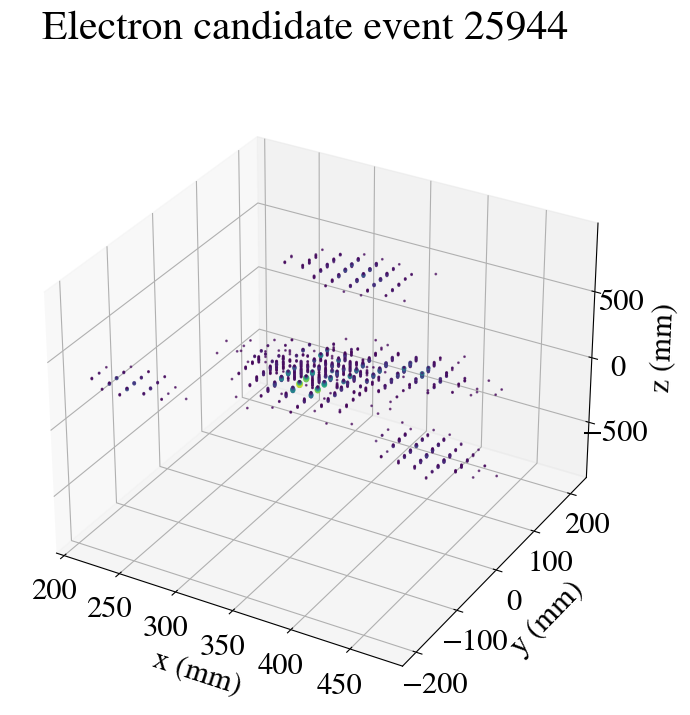

event 25944 post beersheba


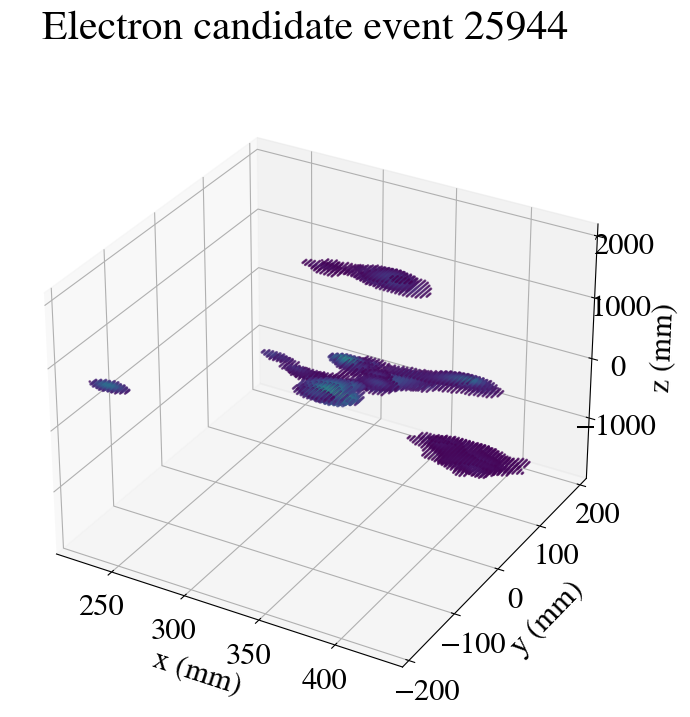

EVENT 32244
Number of tracks: 4
Energy of the event: 2.2853777003803226
event 32244 pre beersheba
Time spent in cut_over_Q: 0.23813223838806152 s
Time spent in drop_isolated: 0.0964655876159668 s


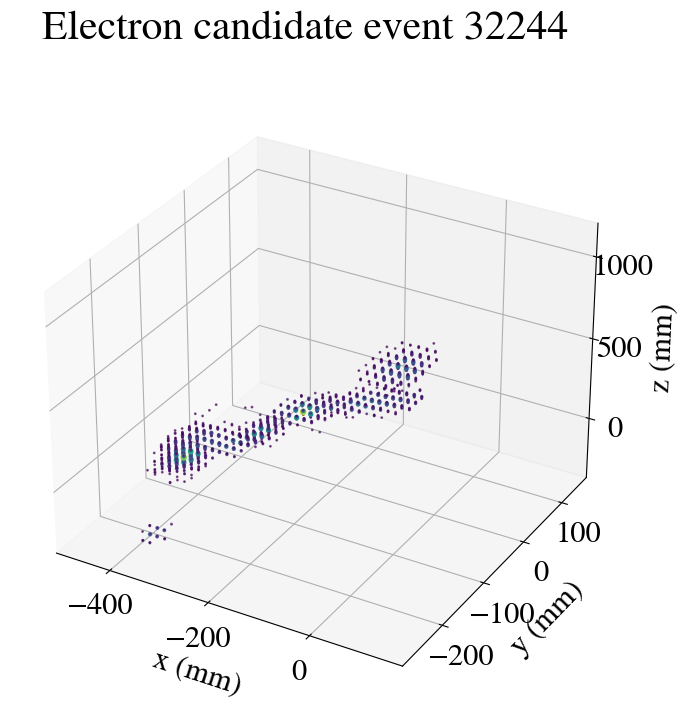

event 32244 post beersheba


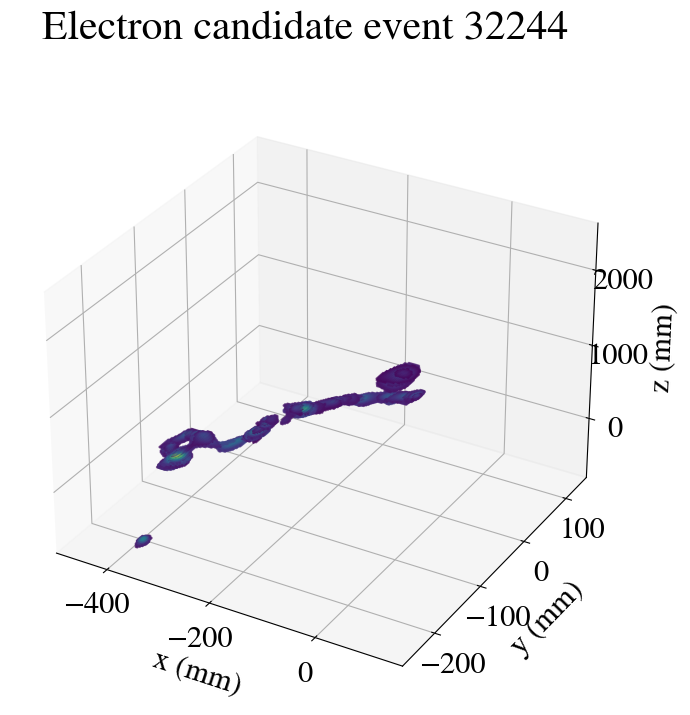

EVENT 39461
Number of tracks: 4
Energy of the event: 1.7039357746196528
event 39461 pre beersheba
Time spent in cut_over_Q: 0.04306650161743164 s
Time spent in drop_isolated: 0.05909538269042969 s


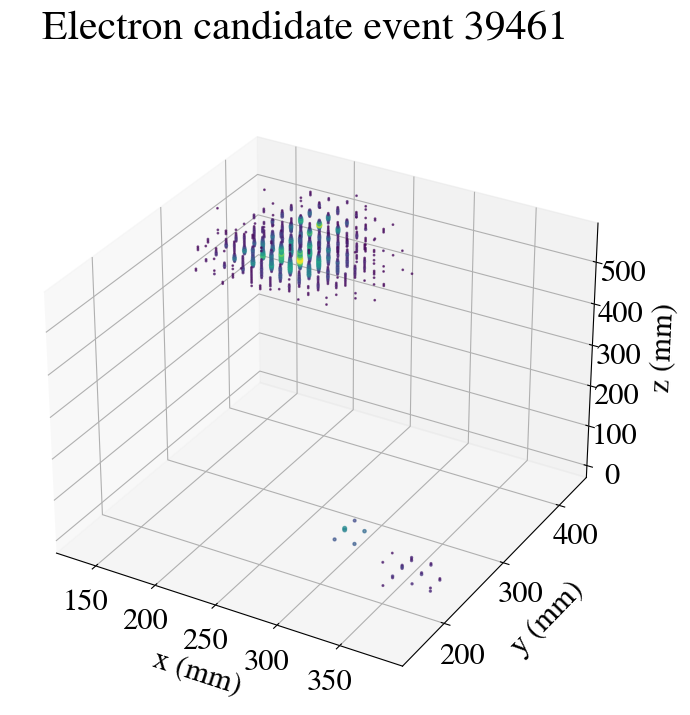

event 39461 post beersheba


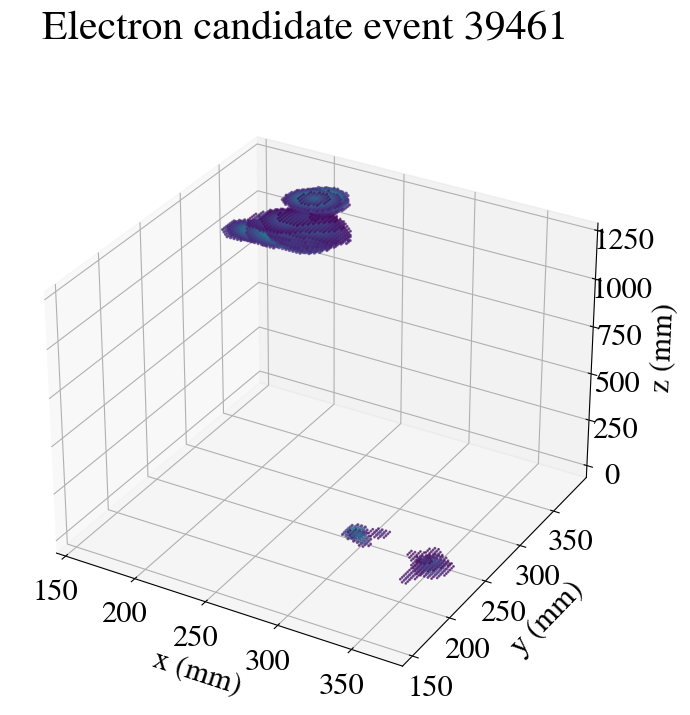

EVENT 39706
Number of tracks: 4
Energy of the event: 2.3481771142686356
event 39706 pre beersheba
Time spent in cut_over_Q: 0.01794910430908203 s
Time spent in drop_isolated: 0.07381200790405273 s


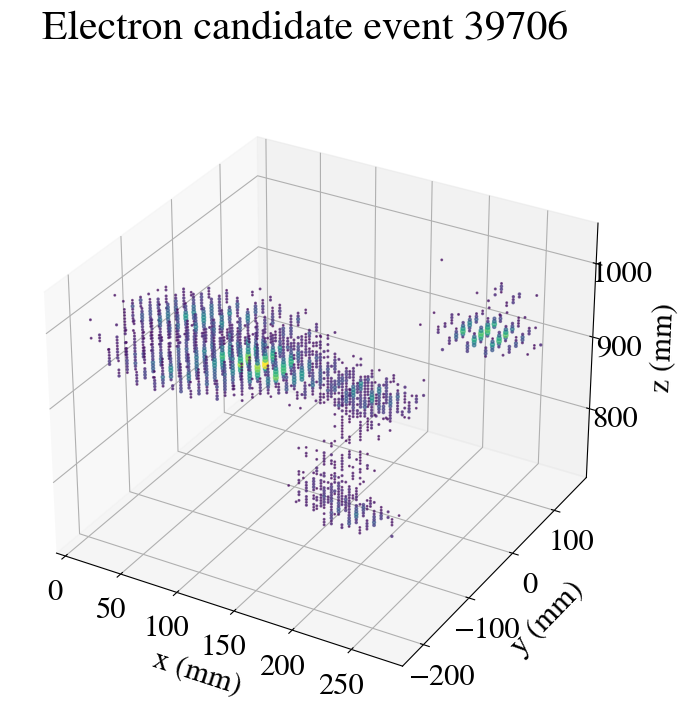

event 39706 post beersheba


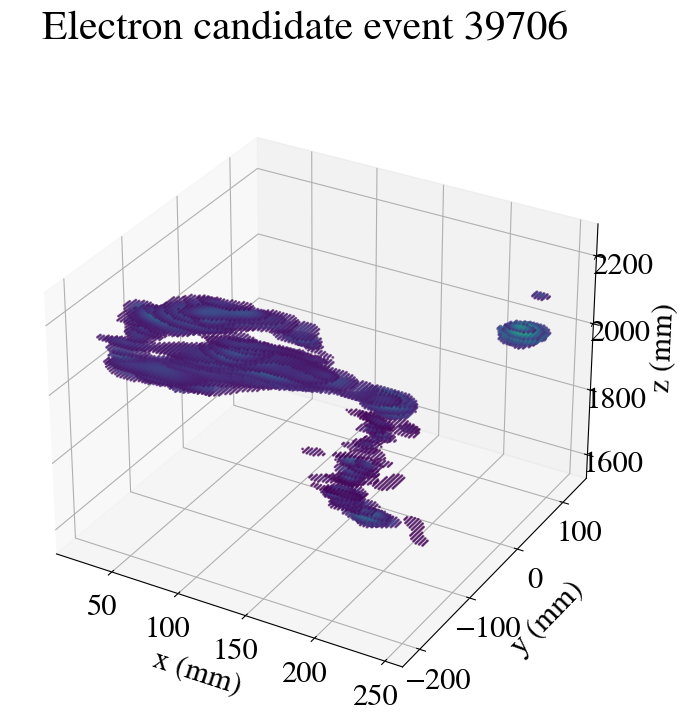

EVENT 35793
Number of tracks: 6
Energy of the event: 2.718338505156302
event 35793 pre beersheba
Time spent in cut_over_Q: 0.21668219566345215 s
Time spent in drop_isolated: 0.0746147632598877 s


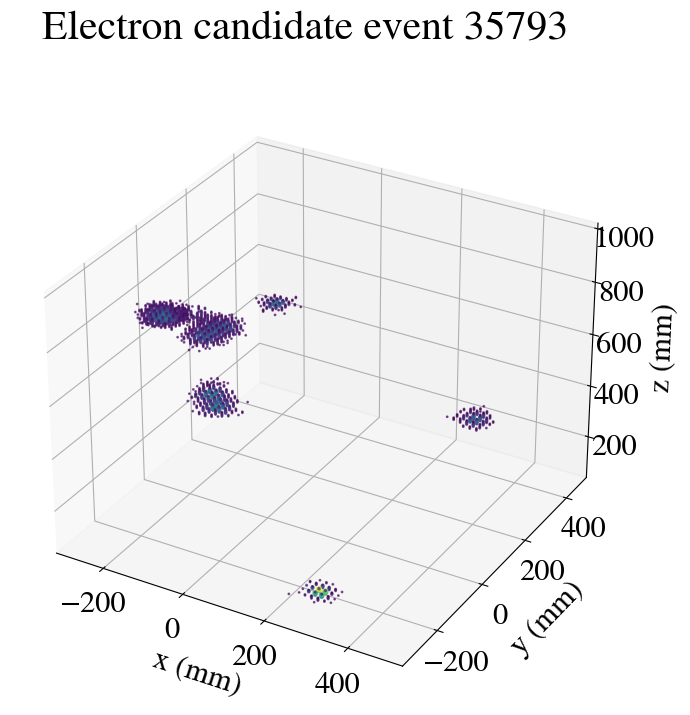

event 35793 post beersheba


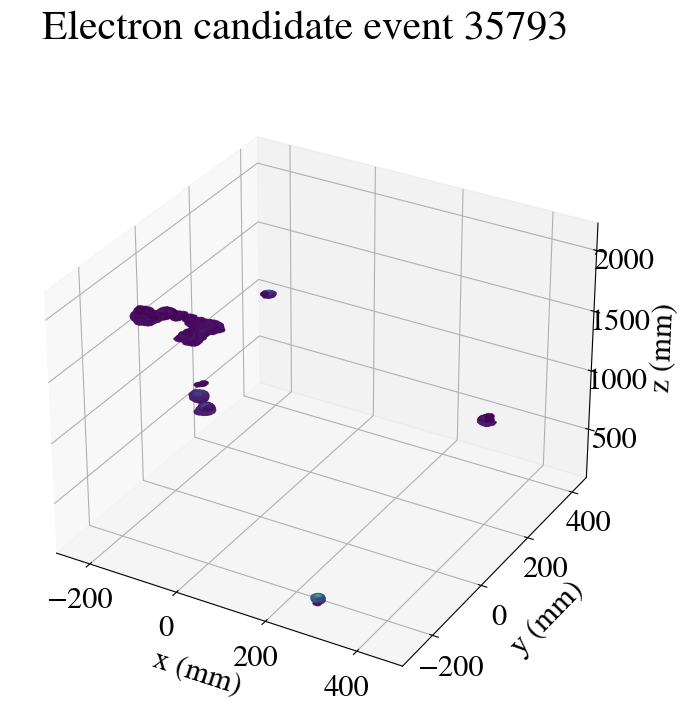

EVENT 41750
Number of tracks: 5
Energy of the event: 2.318050116383399
event 41750 pre beersheba
Time spent in cut_over_Q: 0.2846674919128418 s
Time spent in drop_isolated: 0.09883332252502441 s


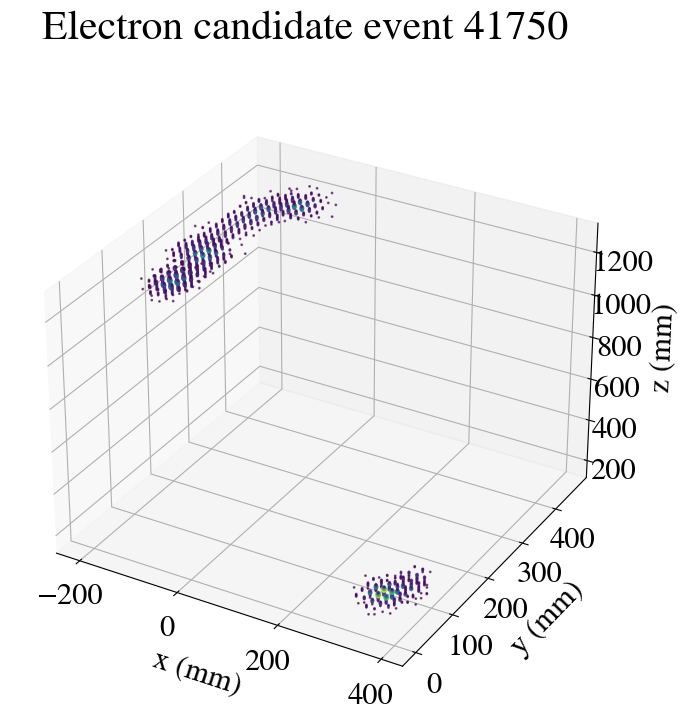

event 41750 post beersheba


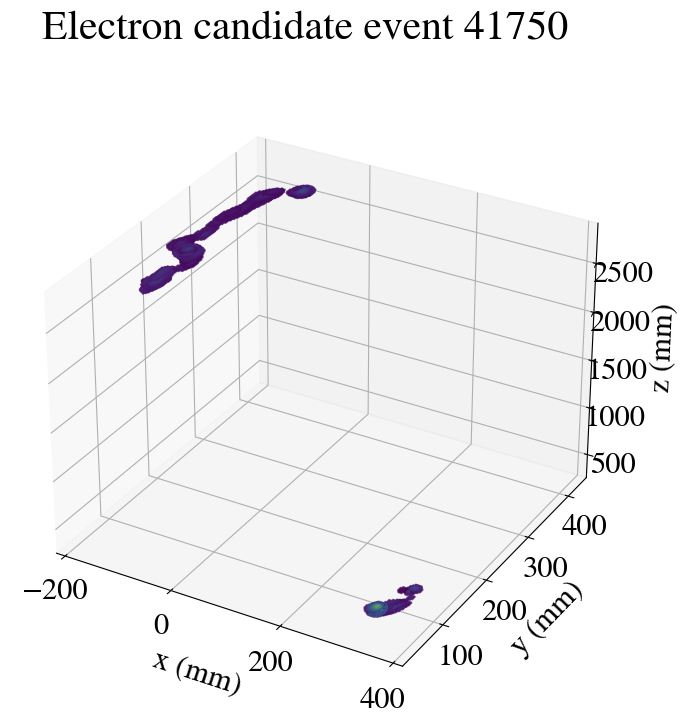

EVENT 45243
Number of tracks: 6
Energy of the event: 1.6995309952072728
event 45243 pre beersheba
Time spent in cut_over_Q: 0.02360987663269043 s
Time spent in drop_isolated: 0.04359698295593262 s


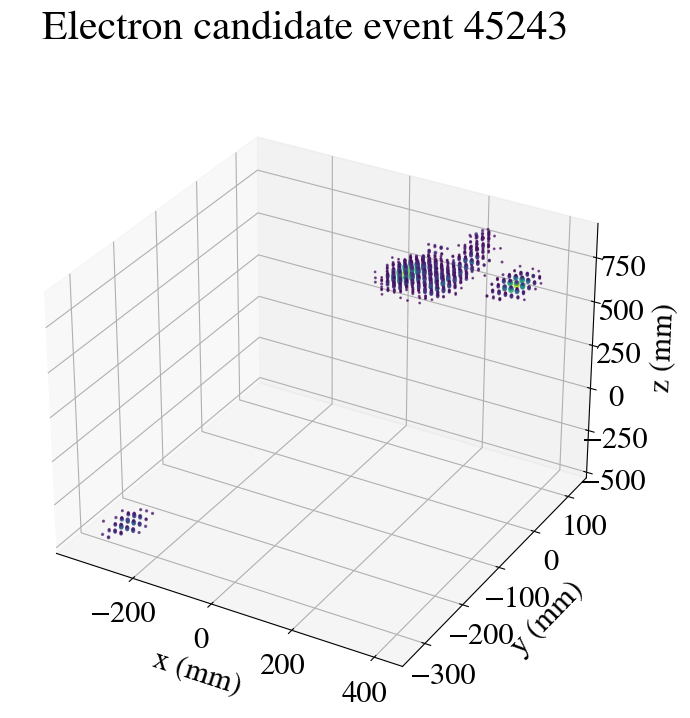

event 45243 post beersheba


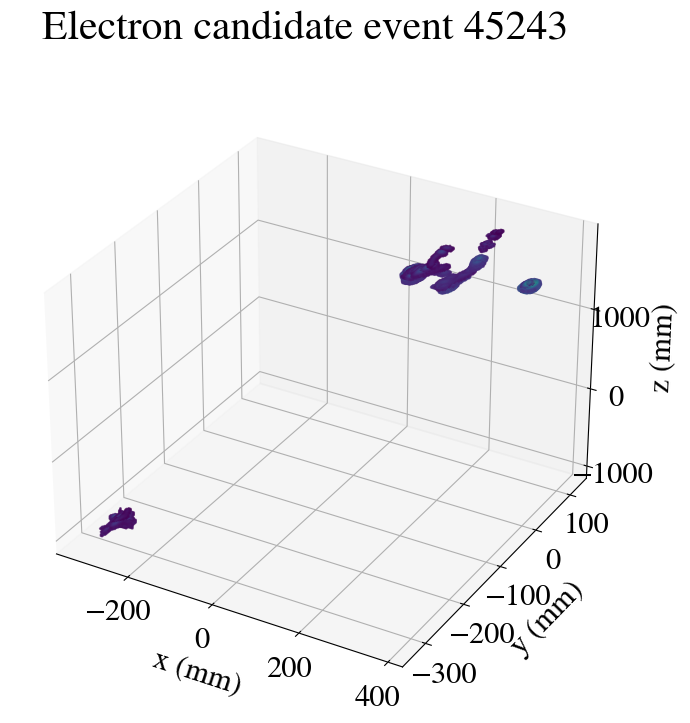

EVENT 53643
Number of tracks: 5
Energy of the event: 1.6995276167302917
event 53643 pre beersheba
Time spent in cut_over_Q: 0.04040193557739258 s
Time spent in drop_isolated: 0.060280799865722656 s


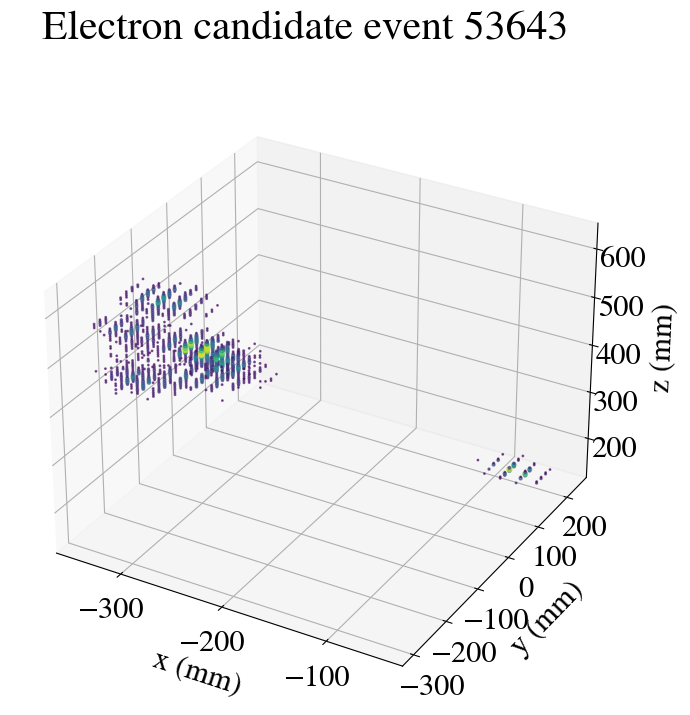

event 53643 post beersheba


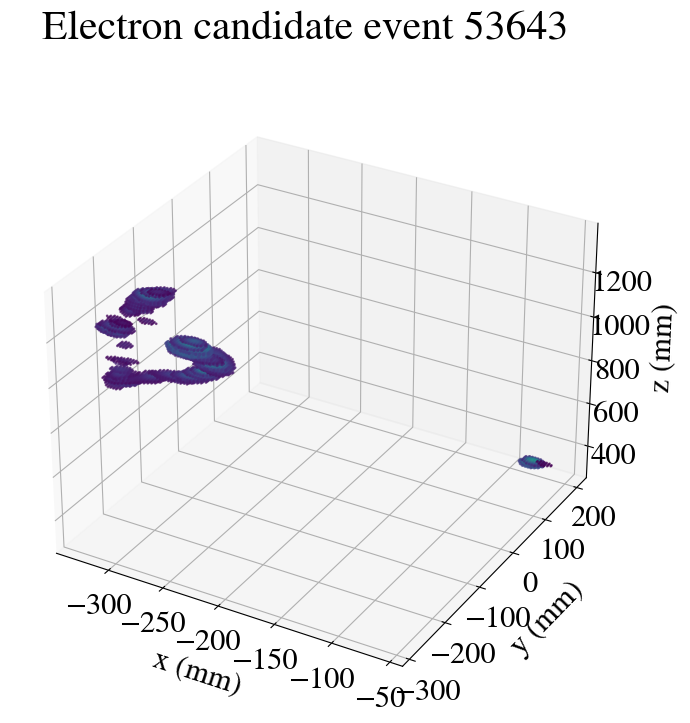

EVENT 47672
Number of tracks: 10
Energy of the event: 1.6084519010896408
event 47672 pre beersheba
Time spent in cut_over_Q: 0.2020106315612793 s
Time spent in drop_isolated: 0.05258321762084961 s


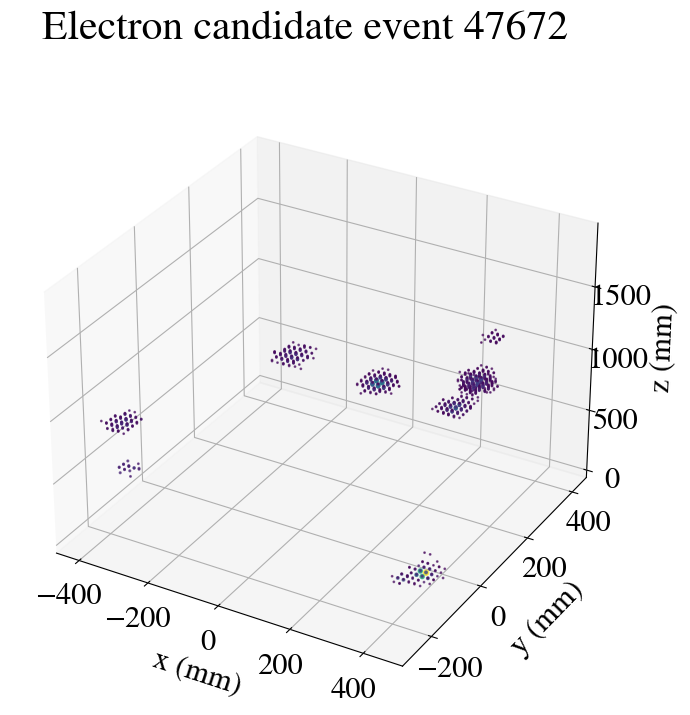

event 47672 post beersheba


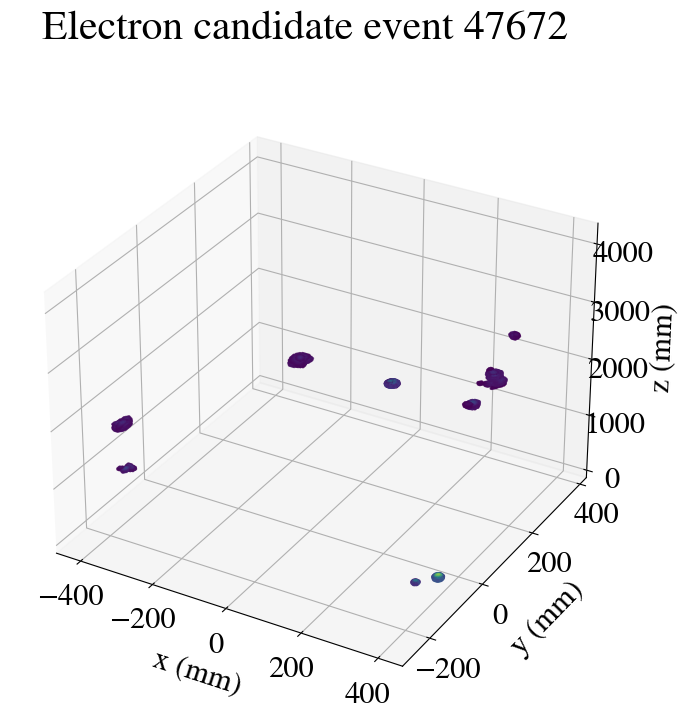

EVENT 48057
Number of tracks: 3
Energy of the event: 1.8009575577958332
event 48057 pre beersheba
Time spent in cut_over_Q: 0.03243422508239746 s
Time spent in drop_isolated: 0.11060428619384766 s


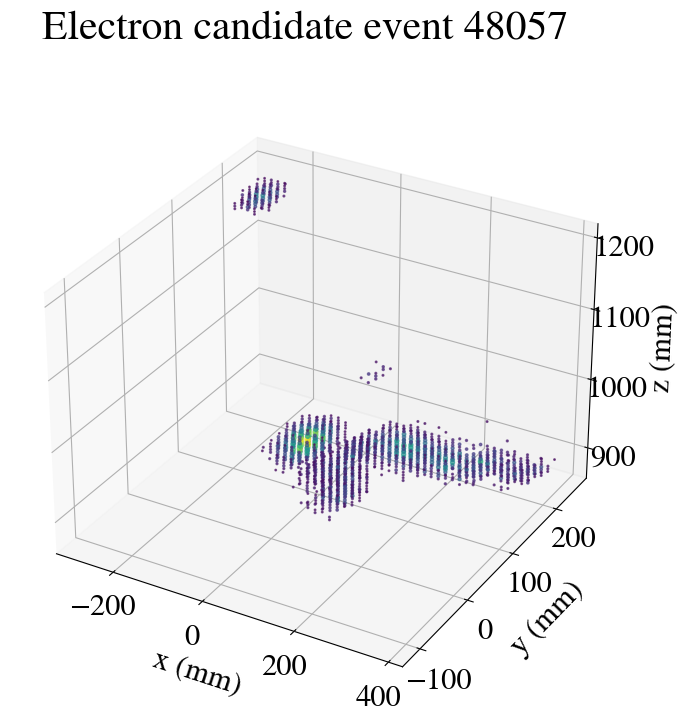

event 48057 post beersheba


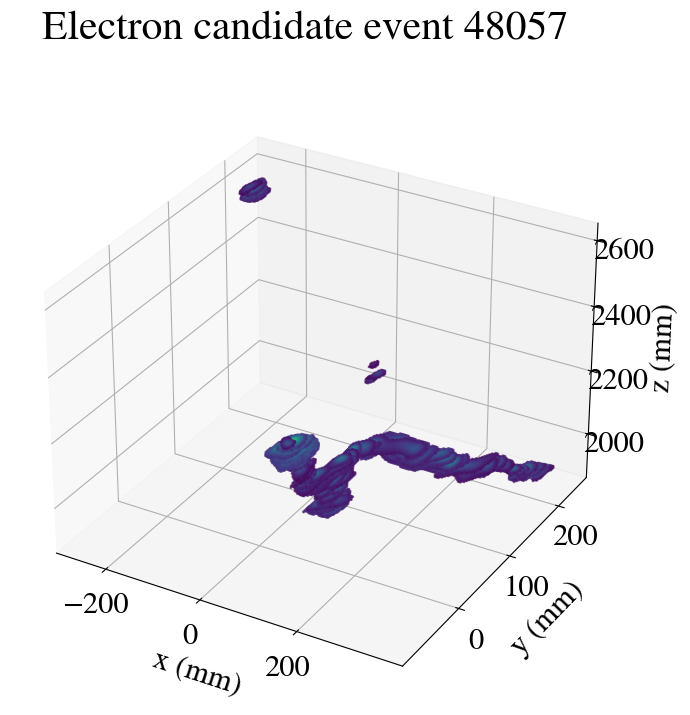

EVENT 48288
Number of tracks: 5
Energy of the event: 1.6065610796554557
event 48288 pre beersheba
Time spent in cut_over_Q: 0.026936769485473633 s
Time spent in drop_isolated: 0.03715682029724121 s


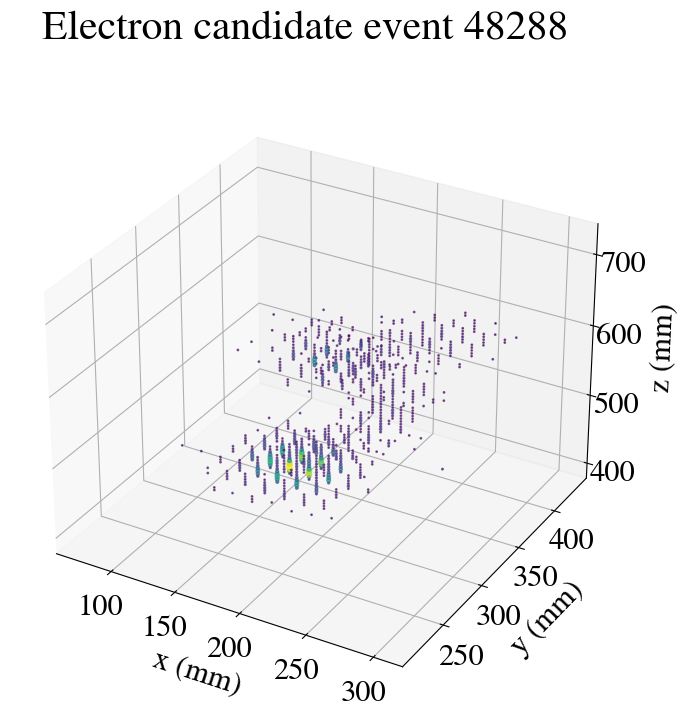

event 48288 post beersheba


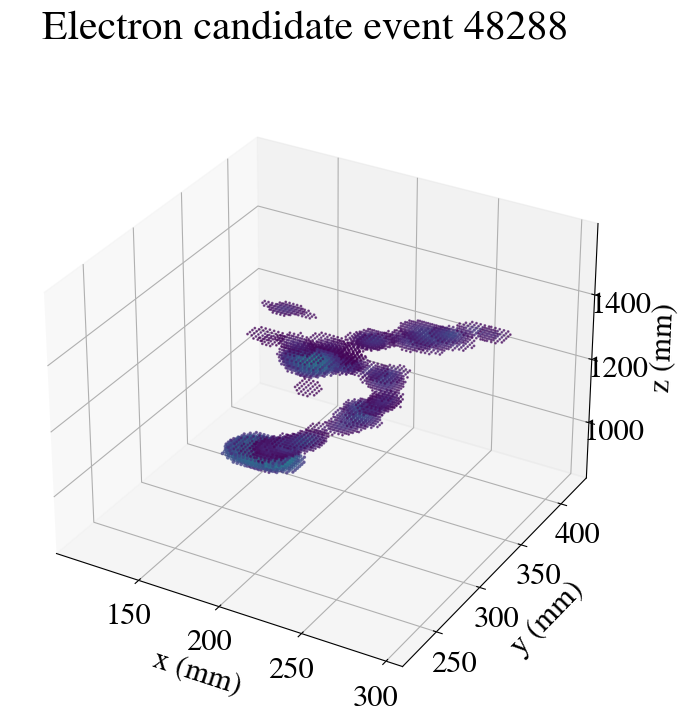

EVENT 55498
Number of tracks: 6
Energy of the event: 2.042192055213049
event 55498 pre beersheba
Time spent in cut_over_Q: 0.2308347225189209 s
Time spent in drop_isolated: 0.07283163070678711 s


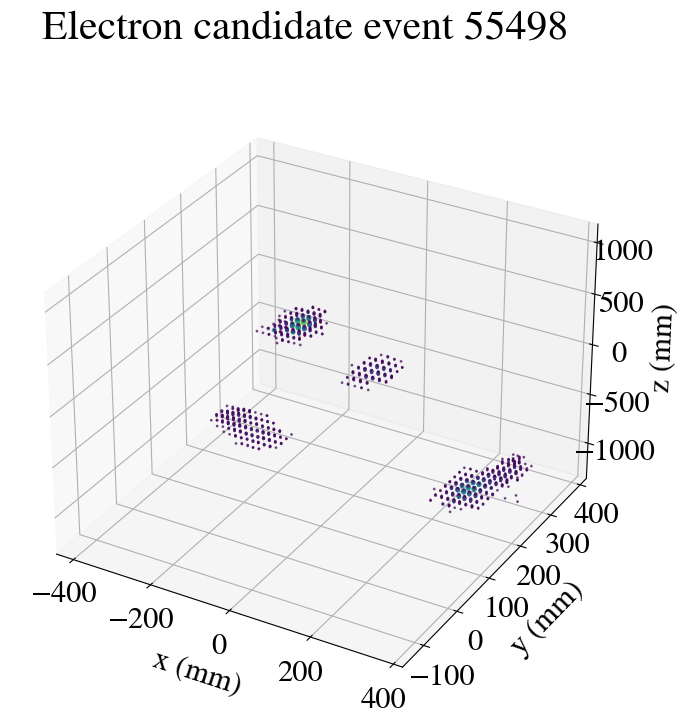

event 55498 post beersheba


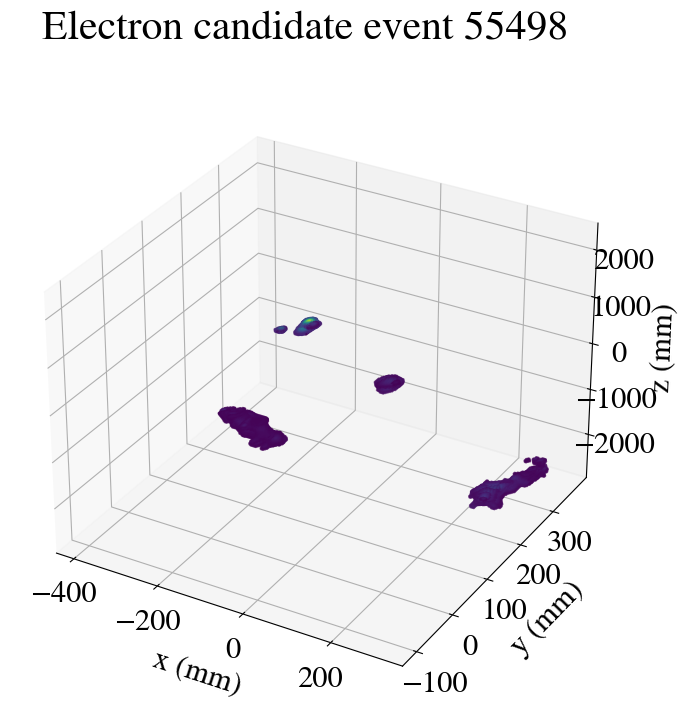

EVENT 55673
Number of tracks: 7
Energy of the event: 1.9465229676168496
event 55673 pre beersheba
Time spent in cut_over_Q: 0.04761791229248047 s
Time spent in drop_isolated: 0.05194830894470215 s


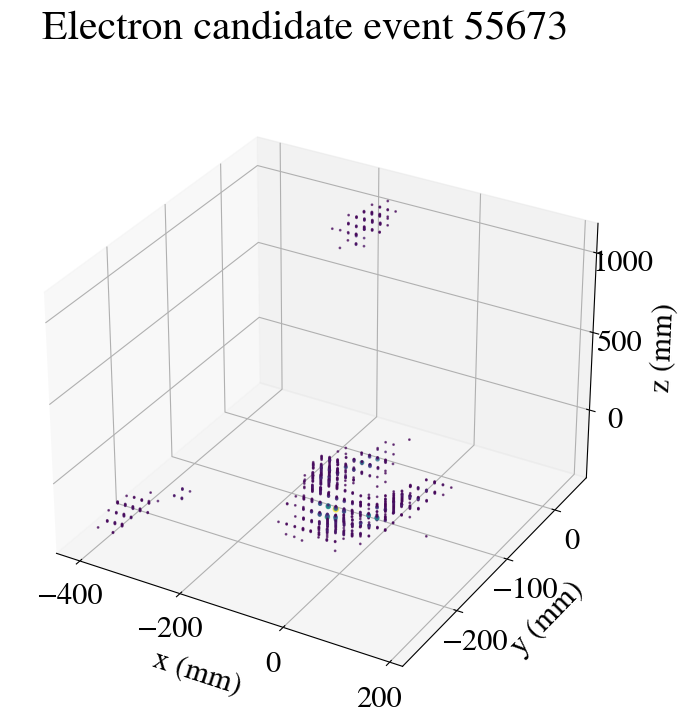

event 55673 post beersheba


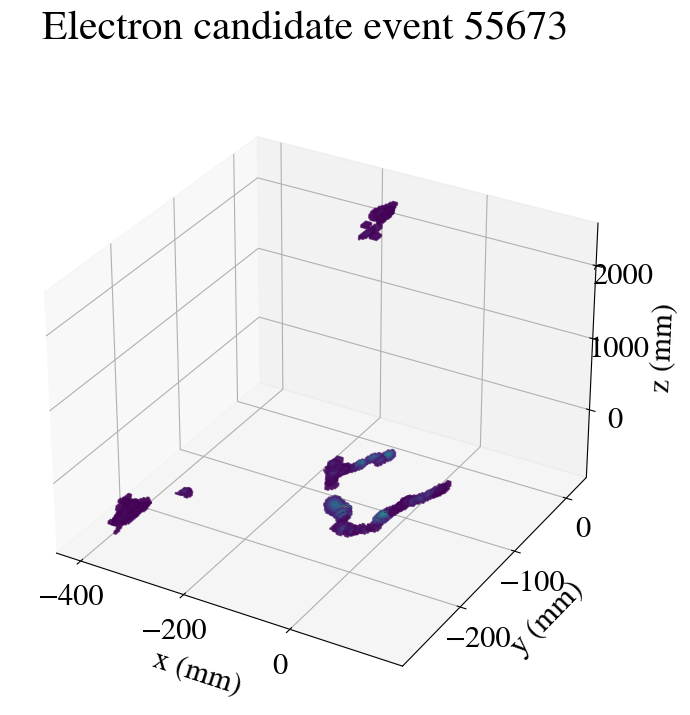

EVENT 60615
Number of tracks: 6
Energy of the event: 1.6665020013809821
event 60615 pre beersheba
Time spent in cut_over_Q: 0.0766298770904541 s
Time spent in drop_isolated: 0.09745478630065918 s


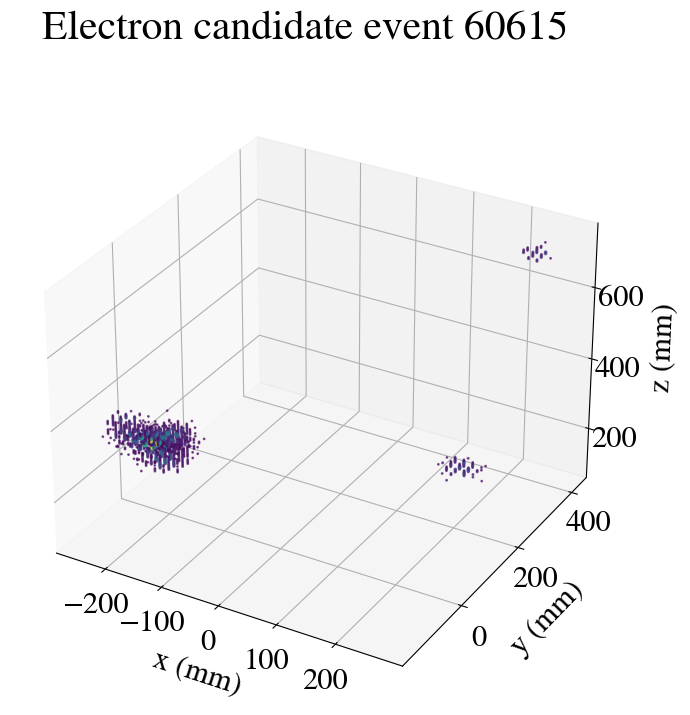

event 60615 post beersheba


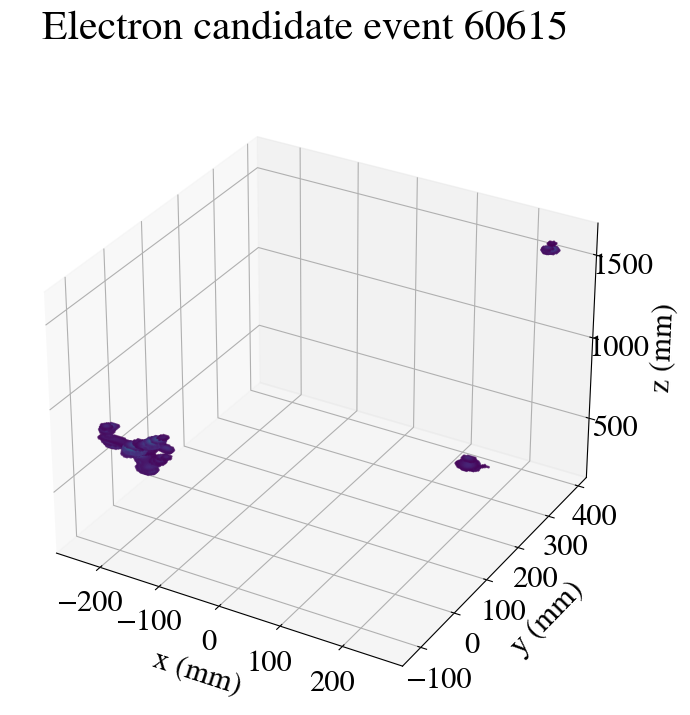

EVENT 53734
Number of tracks: 9
Energy of the event: 2.373151869623574
event 53734 pre beersheba
Time spent in cut_over_Q: 0.07173609733581543 s
Time spent in drop_isolated: 0.07483720779418945 s


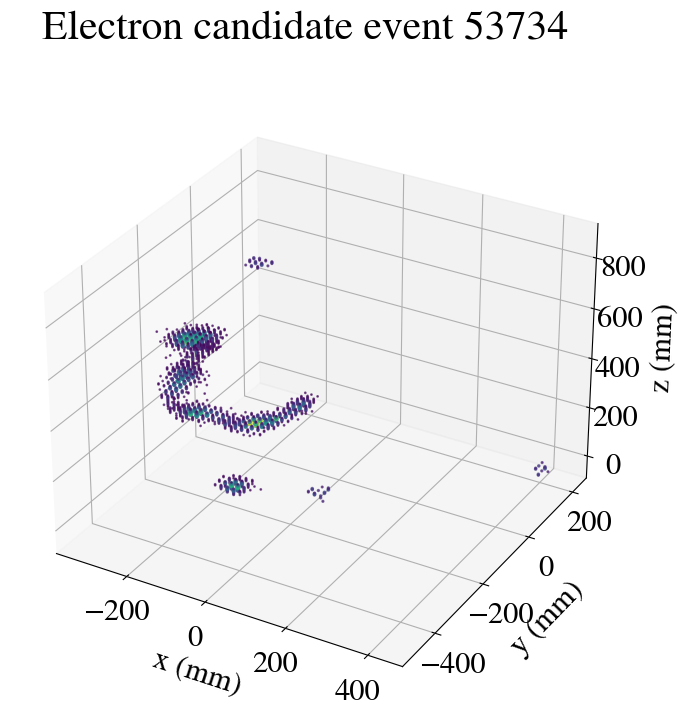

event 53734 post beersheba


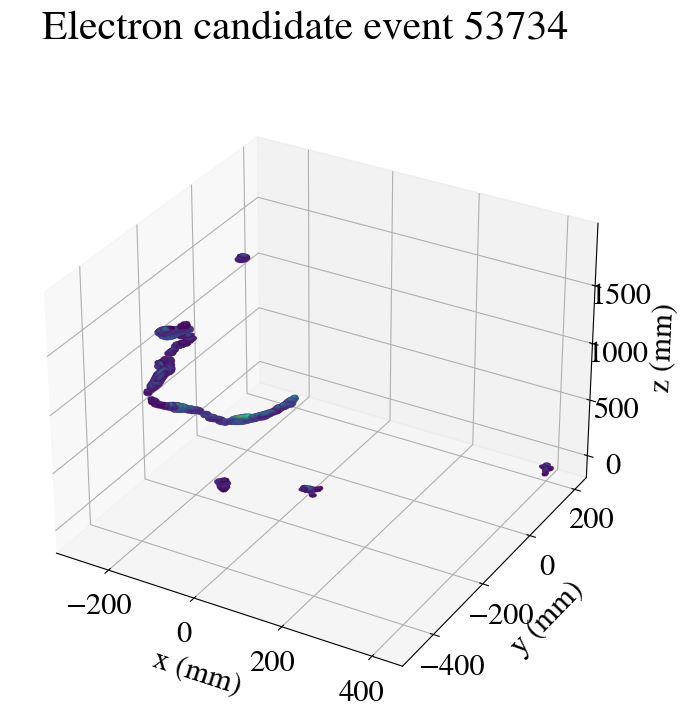

In [22]:
stopper = 20

for i, evt in enumerate(DEP_E_hits.event.unique()):
    print(f"EVENT {evt}\nNumber of tracks: {hdst[hdst.event == evt].numb_of_tracks.unique()[0]}")
    print(f"Energy of the event: {hdst[hdst.event == evt].energy.sum()}")
    print(f"event {evt} pre beersheba")
    func.plotter_3d(low_E_soph_hits, evt, cut_n_drop = True, clrbar = False, cut_sensors = cut_sensors, drop_sensors = drop_sensors)
    print(f"event {evt} post beersheba")
    func.plotter_3d(low_E_hits, evt, cut_n_drop = False, clrbar = False)
    
    if i > stopper:
        break

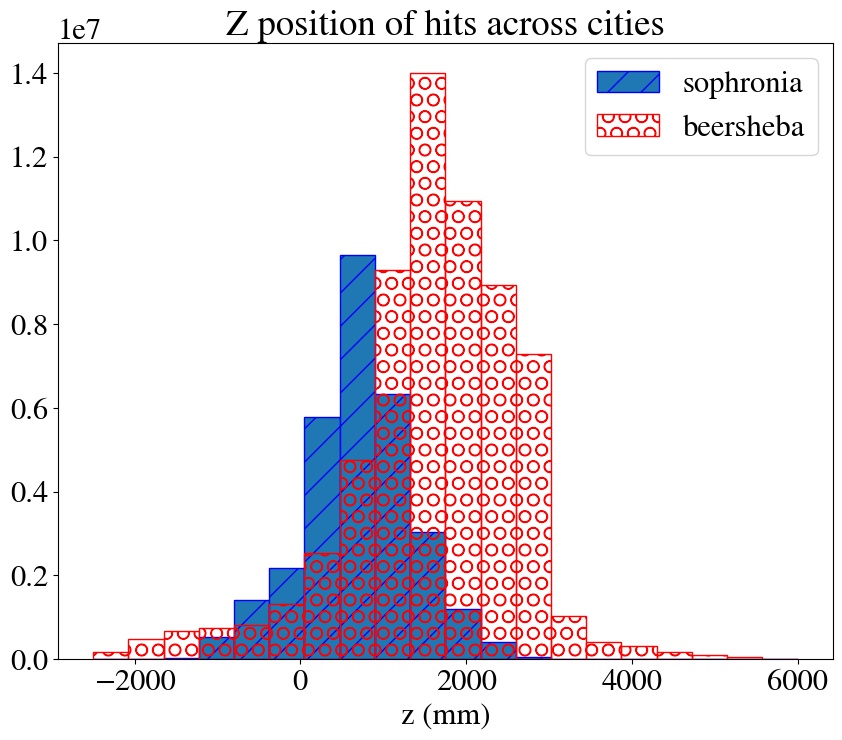

In [36]:
plt.hist(soph_hits.Z.values, bins = 20, label = 'sophronia', fill = True, edgecolor = 'b', hatch = '/', range = (-2500, 6000))
plt.hist(hits.Z.values, bins = 20, label = 'beersheba', fill = False, edgecolor = 'r', hatch='O', range = (-2500, 6000))
plt.xlabel('z (mm)')
plt.title('Z position of hits across cities')
plt.legend()
plt.show()

EVENT 5119
Number of tracks: 4
Energy of the event: 2.1062159767888957
event 5119 pre beersheba
EVENT 5119
Total energy 1.18 MeV

Time spent in cut_over_Q: 0.03876781463623047 s
Time spent in drop_isolated: 0.07659077644348145 s


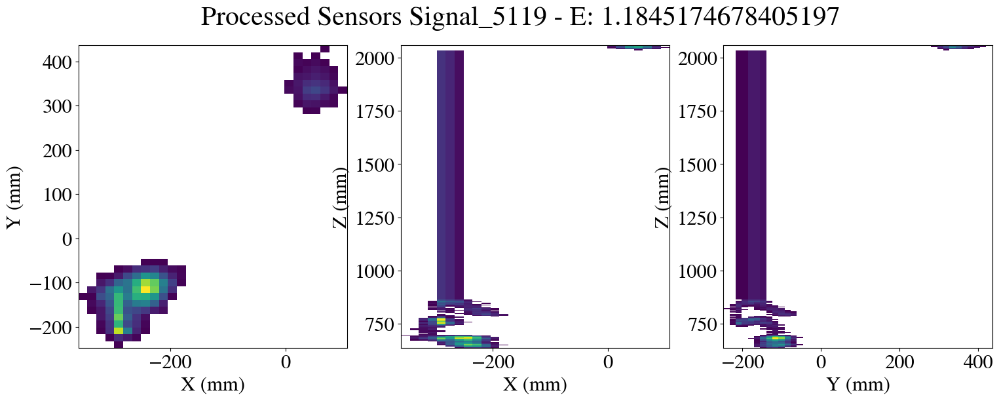

event 5119 post beersheba
EVENT 5119
Total energy 2.11 MeV



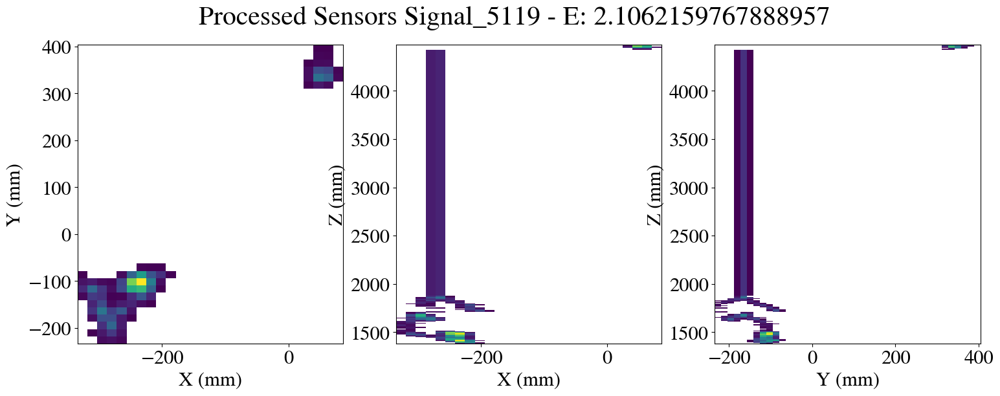

EVENT 5126
Number of tracks: 12
Energy of the event: 1.7465809446856653
event 5126 pre beersheba
EVENT 5126
Total energy 1.00 MeV

Time spent in cut_over_Q: 0.08138823509216309 s
Time spent in drop_isolated: 0.09405755996704102 s


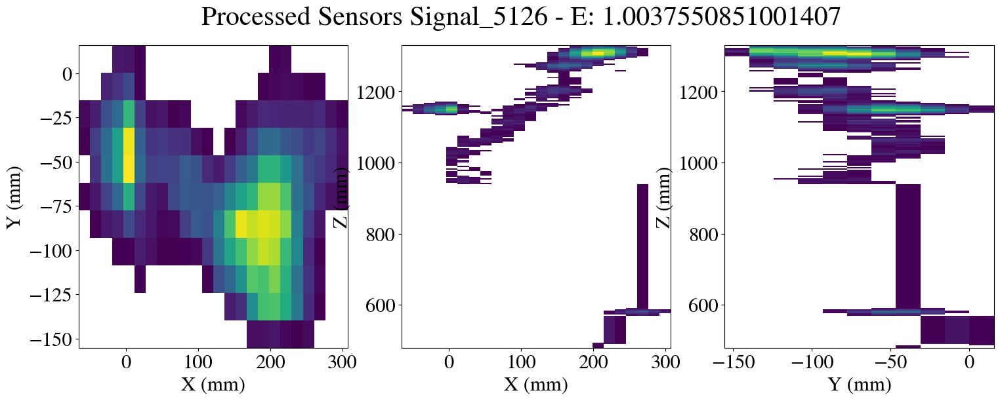

event 5126 post beersheba
EVENT 5126
Total energy 1.75 MeV



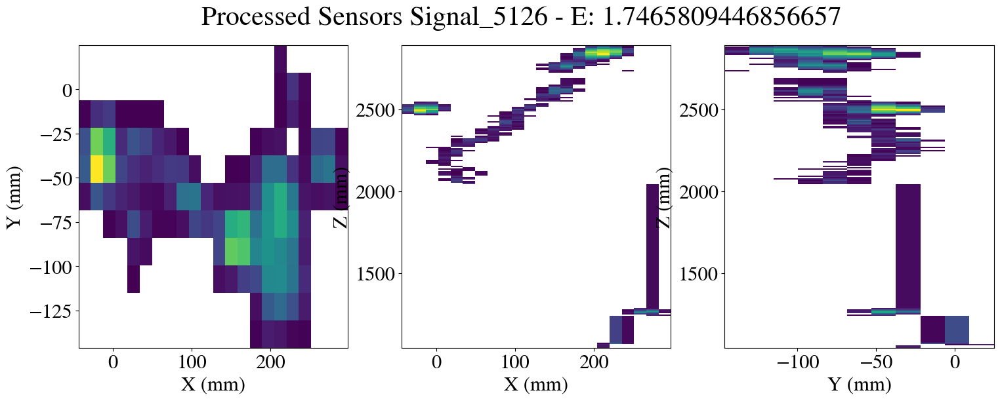

EVENT 11825
Number of tracks: 5
Energy of the event: 1.7551705806547417
event 11825 pre beersheba
EVENT 11825
Total energy 0.94 MeV

Time spent in cut_over_Q: 0.053034067153930664 s
Time spent in drop_isolated: 0.2639622688293457 s


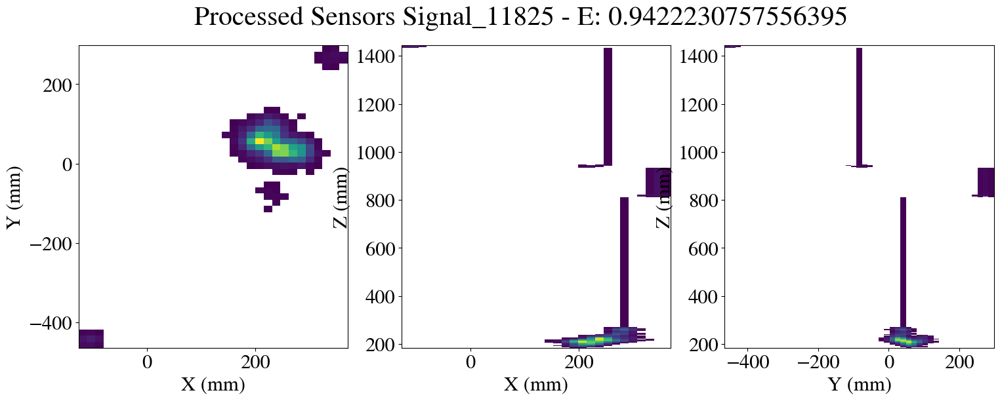

event 11825 post beersheba
EVENT 11825
Total energy 1.76 MeV



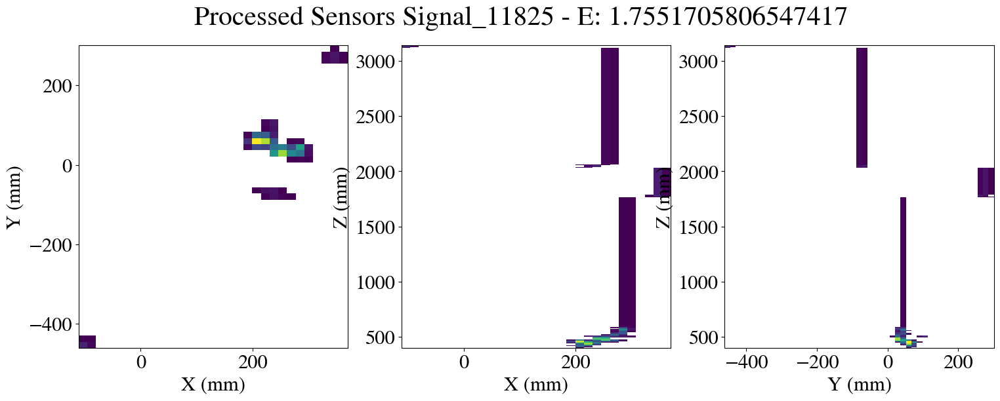

EVENT 16368
Number of tracks: 7
Energy of the event: 3.550473274323997
event 16368 pre beersheba
EVENT 16368
Total energy 1.87 MeV

Time spent in cut_over_Q: 0.047823429107666016 s
Time spent in drop_isolated: 0.07764649391174316 s


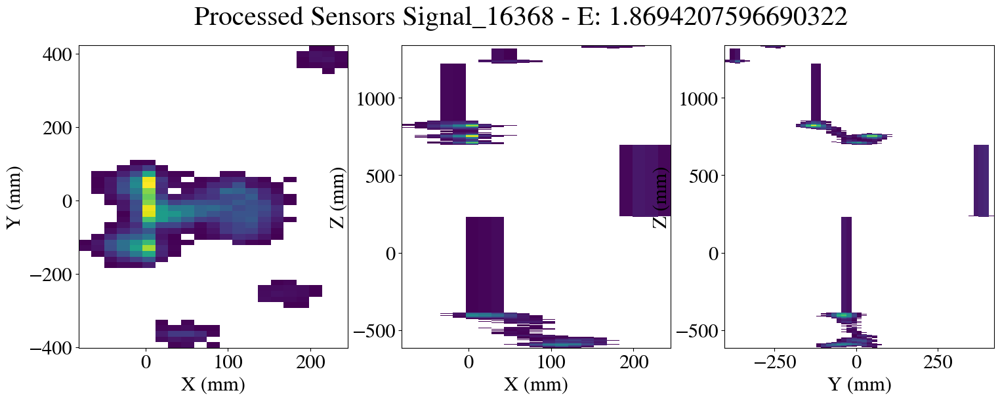

event 16368 post beersheba
EVENT 16368
Total energy 3.55 MeV



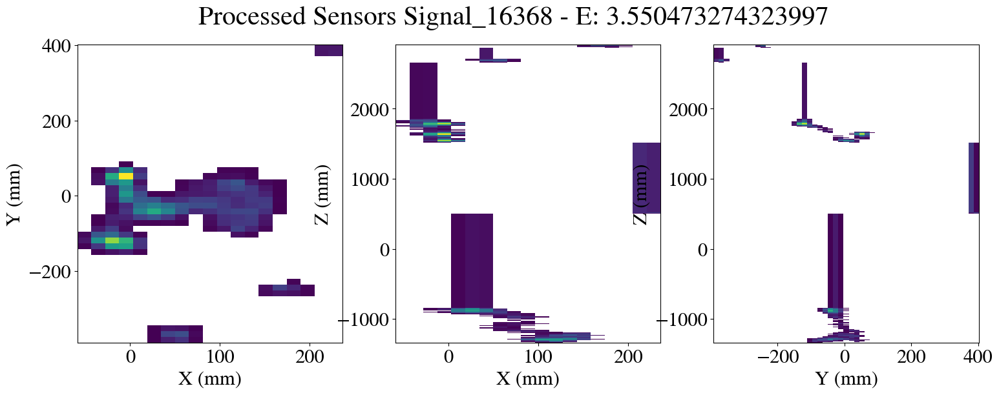

EVENT 27946
Number of tracks: 3
Energy of the event: 2.2460487399306777
event 27946 pre beersheba
EVENT 27946
Total energy 1.25 MeV

Time spent in cut_over_Q: 0.028951644897460938 s
Time spent in drop_isolated: 0.04718661308288574 s


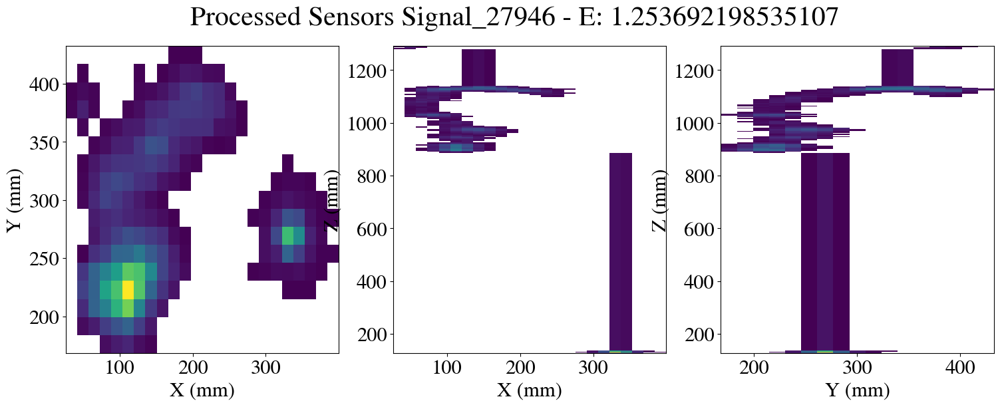

event 27946 post beersheba
EVENT 27946
Total energy 2.25 MeV



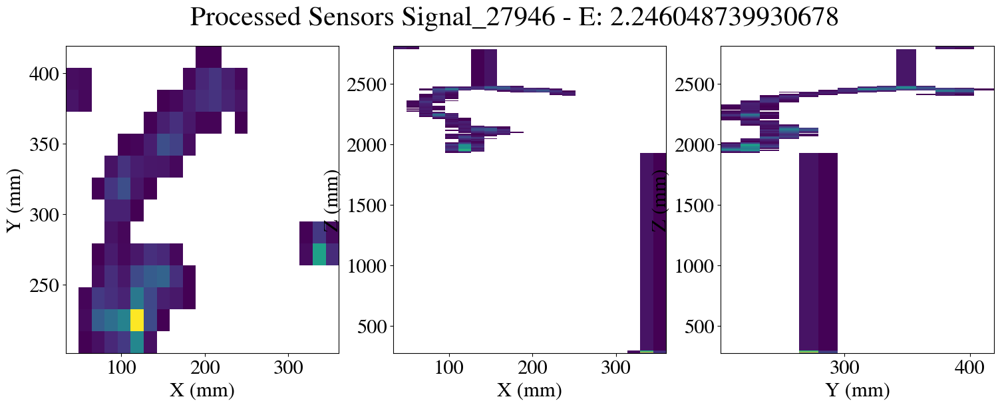

EVENT 19833
Number of tracks: 11
Energy of the event: 2.2035745393515915
event 19833 pre beersheba
EVENT 19833
Total energy 1.13 MeV

Time spent in cut_over_Q: 0.1173851490020752 s
Time spent in drop_isolated: 0.043548583984375 s


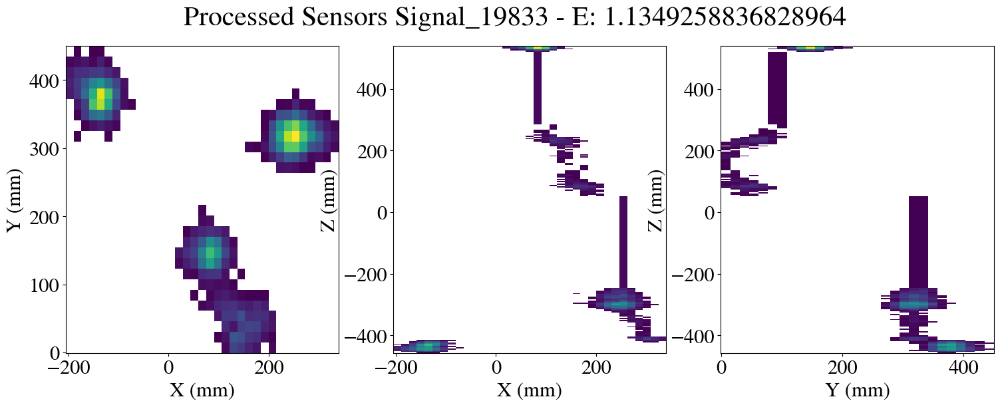

event 19833 post beersheba
EVENT 19833
Total energy 2.20 MeV



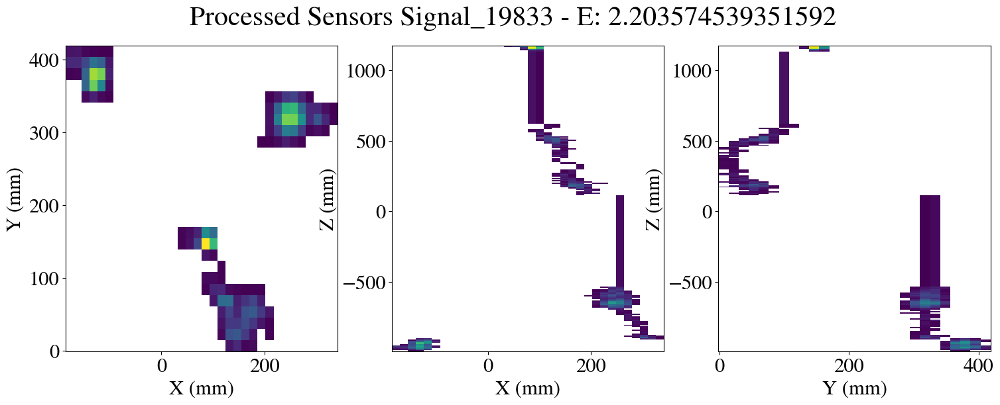

EVENT 28695
Number of tracks: 4
Energy of the event: 2.674367696472633
event 28695 pre beersheba
EVENT 28695
Total energy 1.42 MeV

Time spent in cut_over_Q: 0.04926609992980957 s
Time spent in drop_isolated: 0.07489371299743652 s


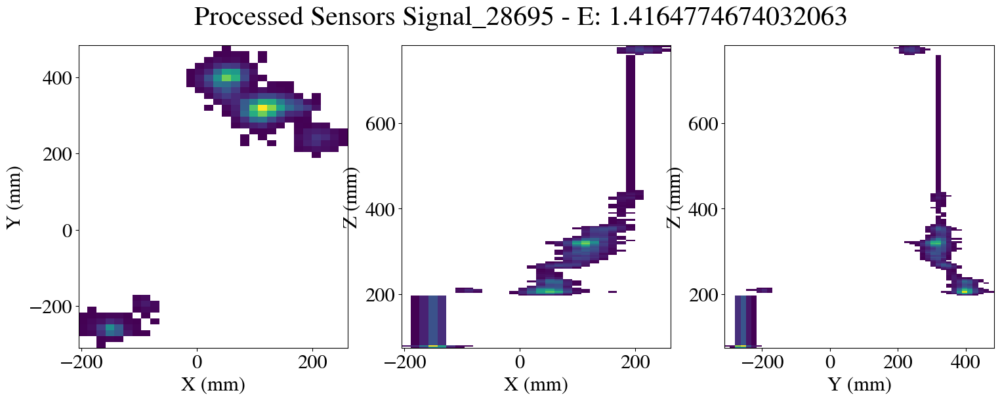

event 28695 post beersheba
EVENT 28695
Total energy 2.67 MeV



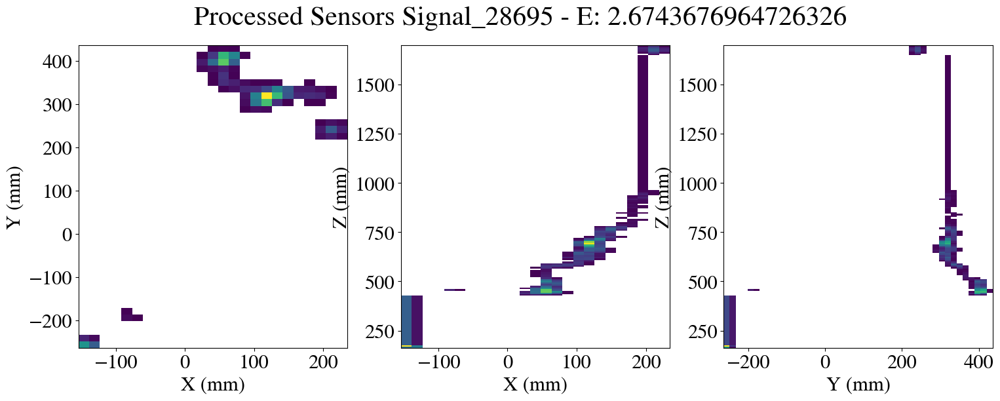

EVENT 25944
Number of tracks: 5
Energy of the event: 2.220332832266139
event 25944 pre beersheba
EVENT 25944
Total energy 1.17 MeV

Time spent in cut_over_Q: 0.041159629821777344 s
Time spent in drop_isolated: 0.06170082092285156 s


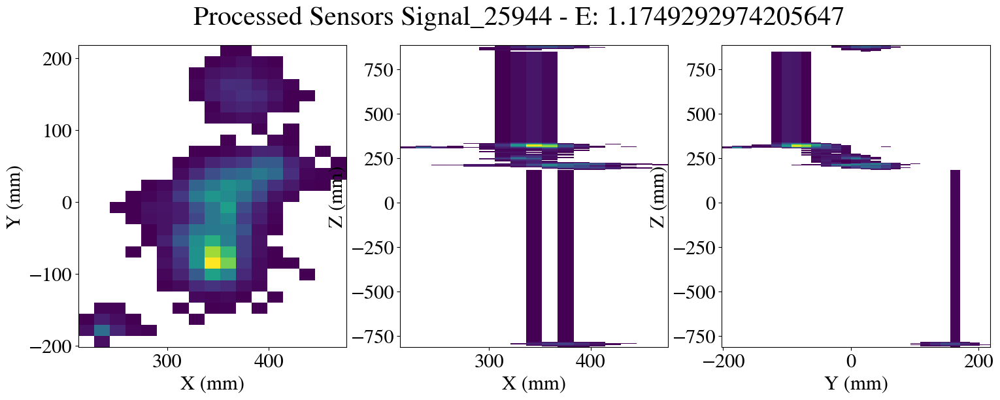

event 25944 post beersheba
EVENT 25944
Total energy 2.22 MeV



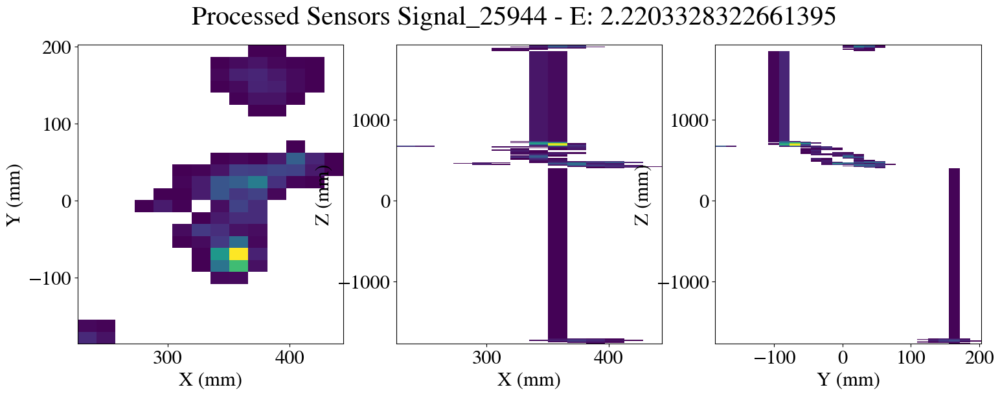

EVENT 32244
Number of tracks: 4
Energy of the event: 2.2853777003803226
event 32244 pre beersheba
EVENT 32244
Total energy 1.21 MeV

Time spent in cut_over_Q: 0.34542131423950195 s
Time spent in drop_isolated: 0.09084129333496094 s


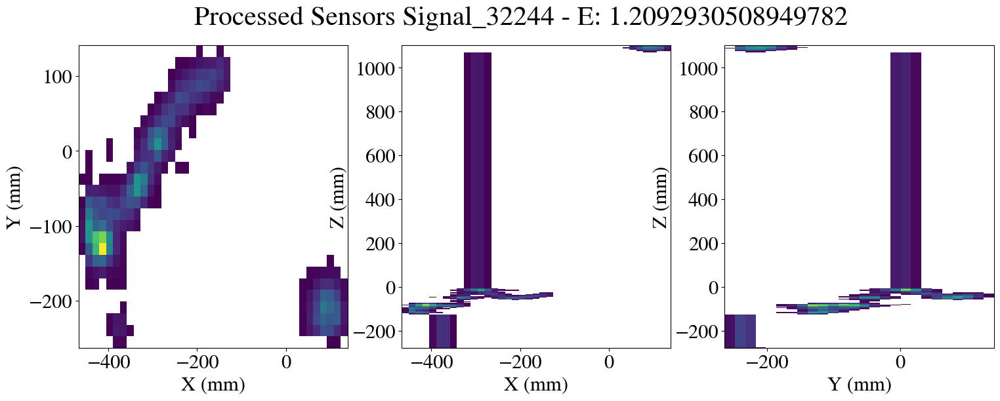

event 32244 post beersheba
EVENT 32244
Total energy 2.29 MeV



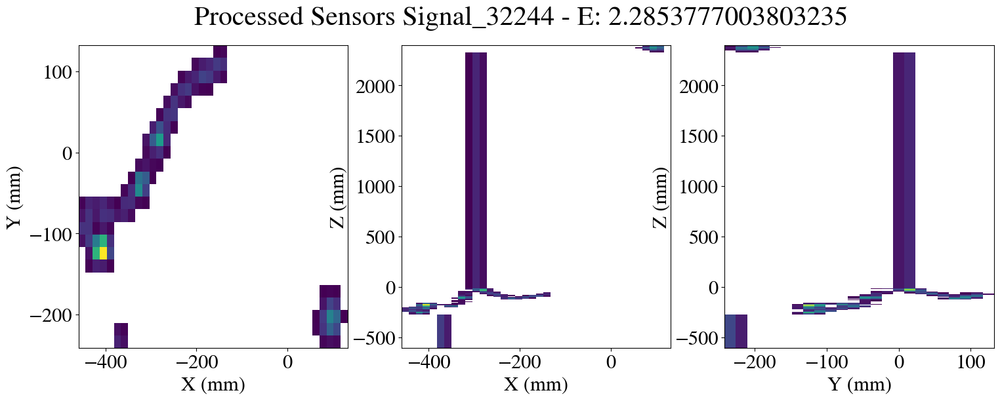

EVENT 39461
Number of tracks: 4
Energy of the event: 1.7039357746196528
event 39461 pre beersheba
EVENT 39461
Total energy 0.91 MeV

Time spent in cut_over_Q: 0.03008246421813965 s
Time spent in drop_isolated: 0.03664851188659668 s


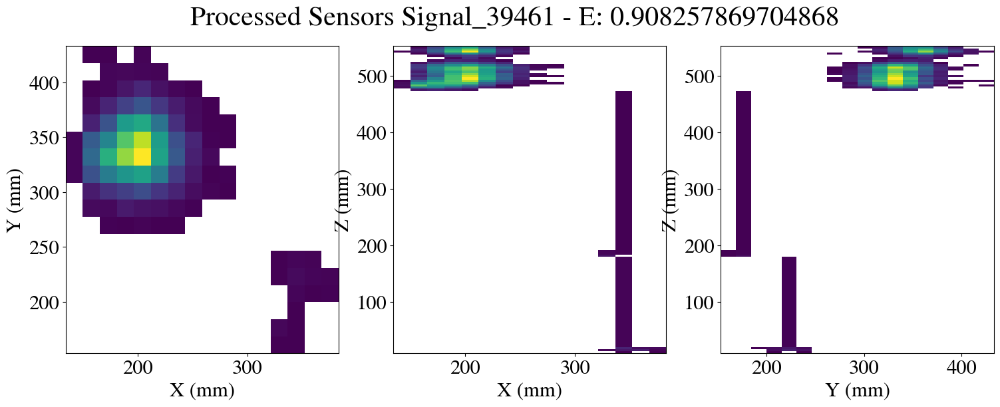

event 39461 post beersheba
EVENT 39461
Total energy 1.70 MeV



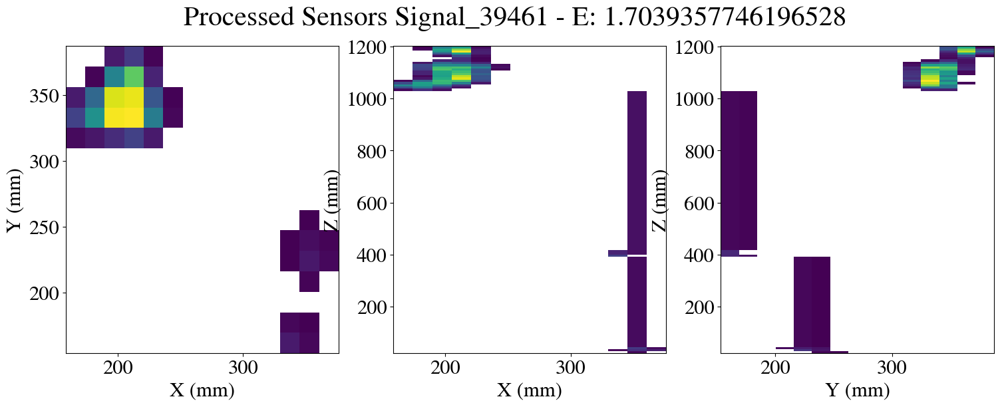

EVENT 39706
Number of tracks: 4
Energy of the event: 2.3481771142686356
event 39706 pre beersheba
EVENT 39706
Total energy 1.32 MeV

Time spent in cut_over_Q: 0.0234072208404541 s
Time spent in drop_isolated: 0.1077873706817627 s


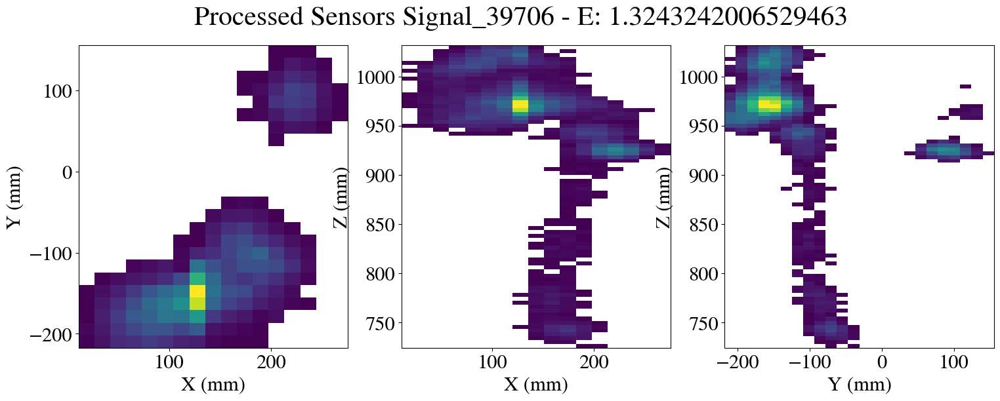

event 39706 post beersheba
EVENT 39706
Total energy 2.35 MeV



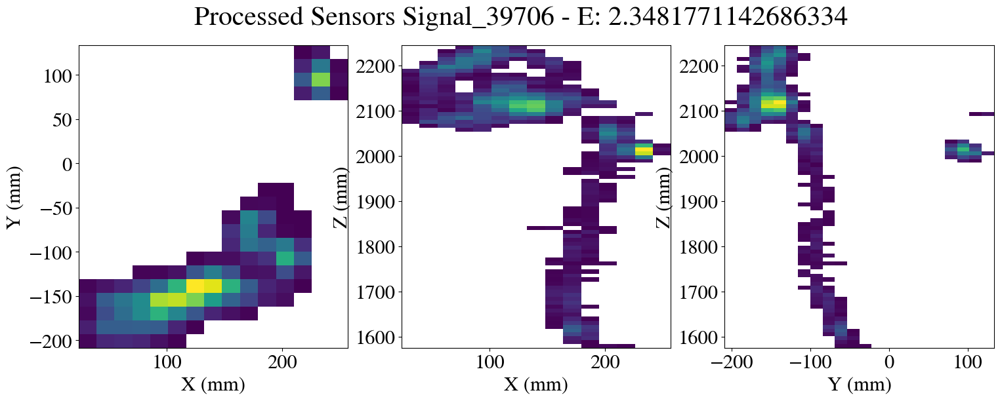

EVENT 35793
Number of tracks: 6
Energy of the event: 2.718338505156302
event 35793 pre beersheba
EVENT 35793
Total energy 1.49 MeV

Time spent in cut_over_Q: 0.12008810043334961 s
Time spent in drop_isolated: 0.056108713150024414 s


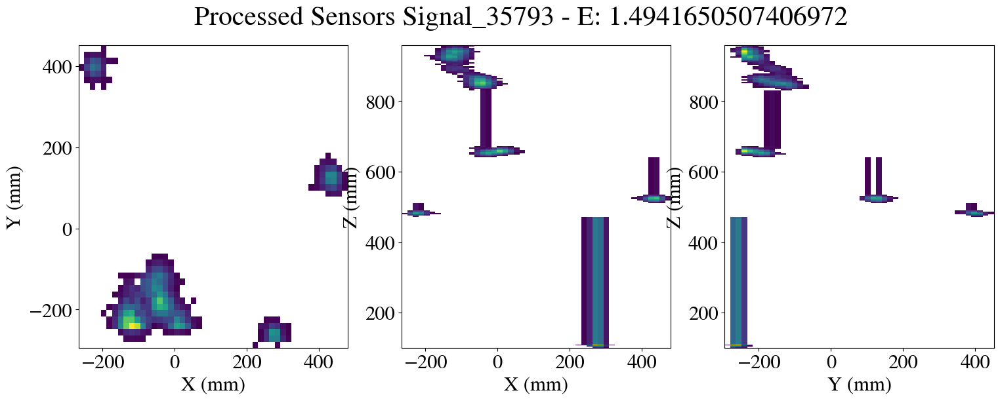

event 35793 post beersheba
EVENT 35793
Total energy 2.72 MeV



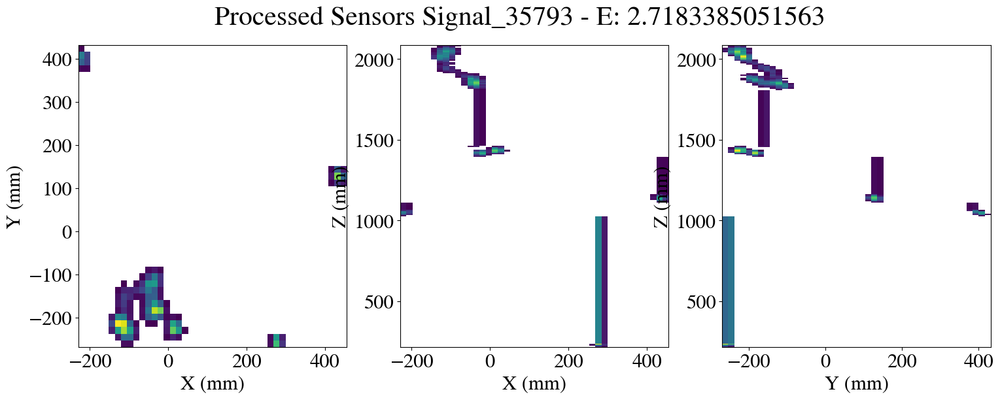

EVENT 41750
Number of tracks: 5
Energy of the event: 2.318050116383399
event 41750 pre beersheba
EVENT 41750
Total energy 1.31 MeV

Time spent in cut_over_Q: 0.16802144050598145 s
Time spent in drop_isolated: 0.051429033279418945 s


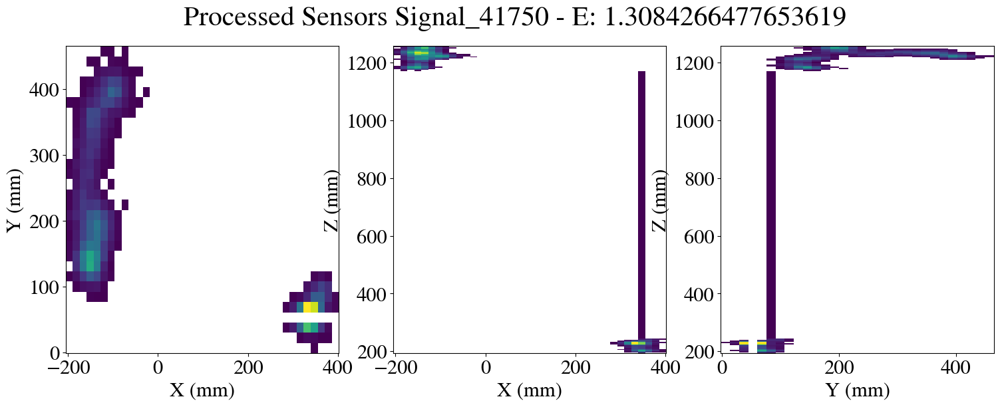

event 41750 post beersheba
EVENT 41750
Total energy 2.32 MeV



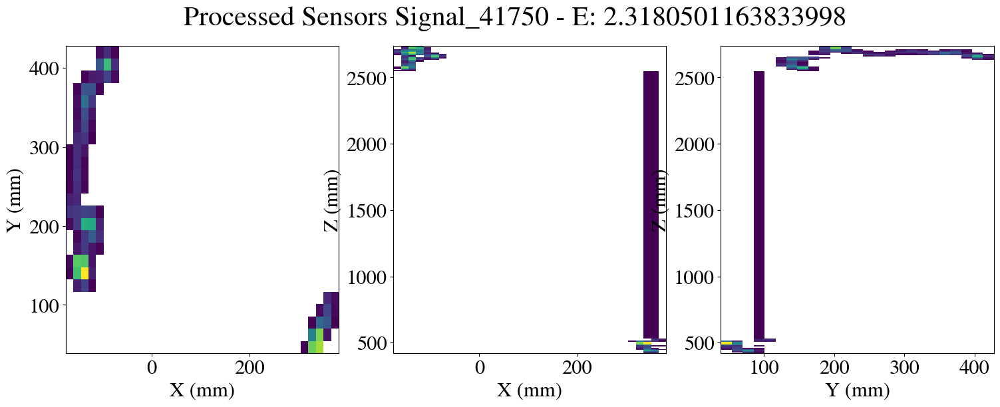

EVENT 45243
Number of tracks: 6
Energy of the event: 1.6995309952072728
event 45243 pre beersheba
EVENT 45243
Total energy 0.93 MeV

Time spent in cut_over_Q: 0.019956111907958984 s
Time spent in drop_isolated: 0.035948753356933594 s


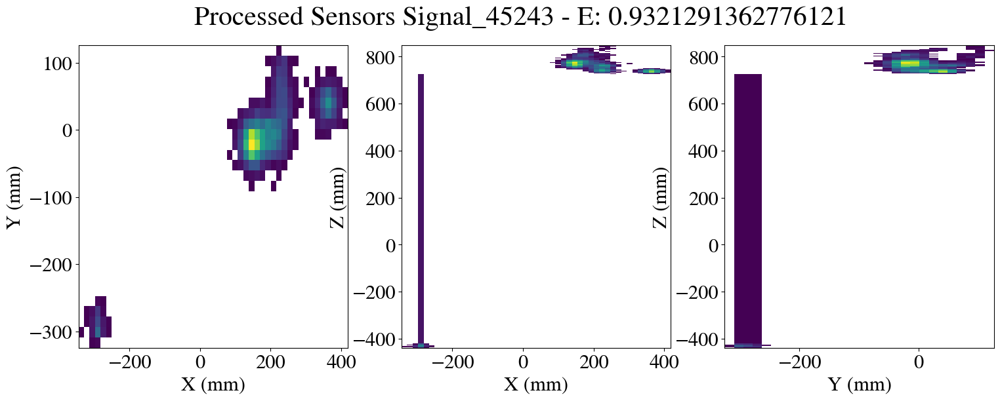

event 45243 post beersheba
EVENT 45243
Total energy 1.70 MeV



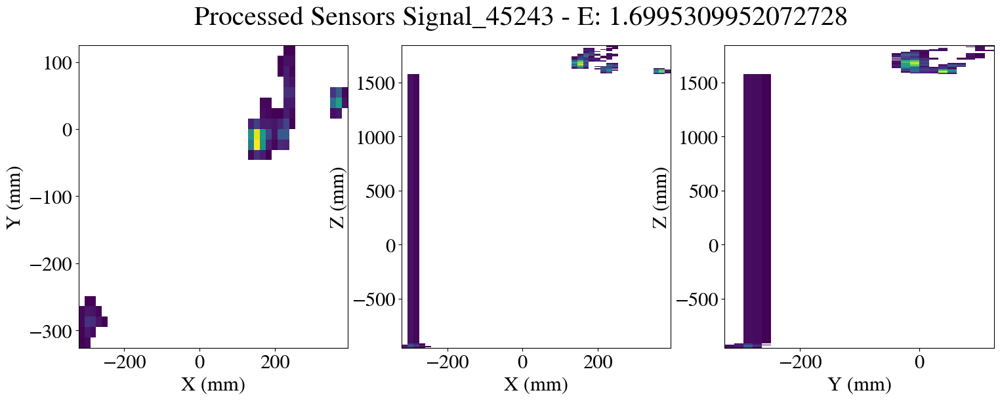

EVENT 53643
Number of tracks: 5
Energy of the event: 1.6995276167302917
event 53643 pre beersheba
EVENT 53643
Total energy 0.92 MeV

Time spent in cut_over_Q: 0.020201683044433594 s
Time spent in drop_isolated: 0.030971050262451172 s


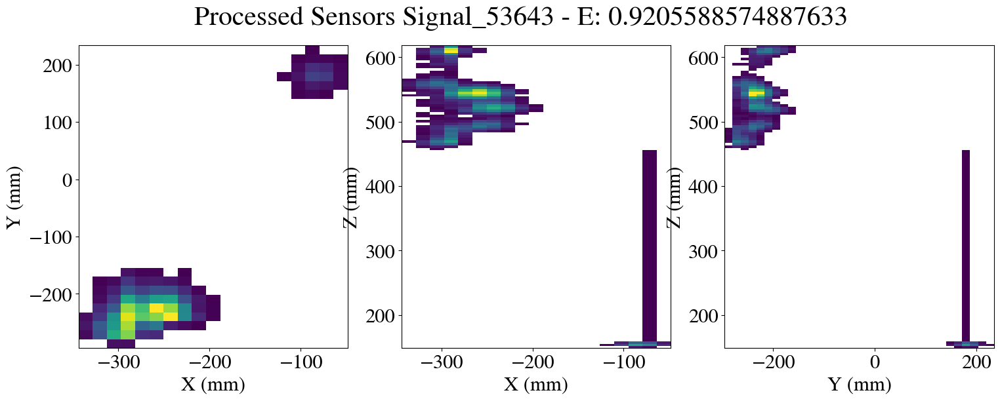

event 53643 post beersheba
EVENT 53643
Total energy 1.70 MeV



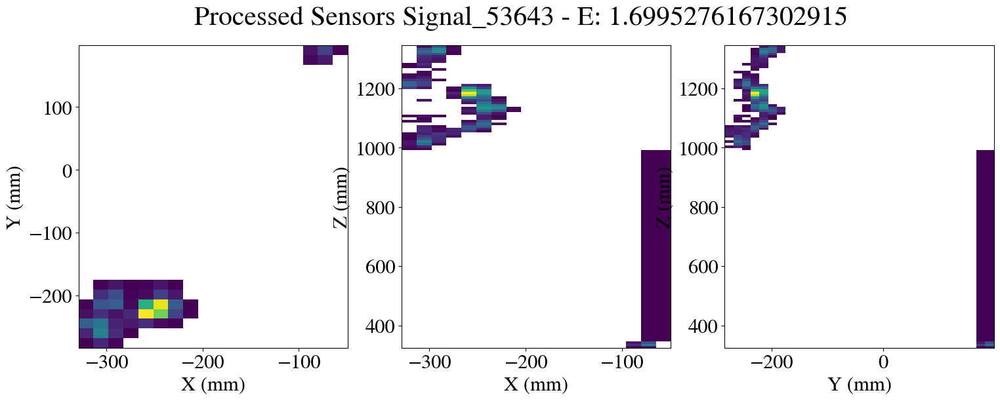

EVENT 47672
Number of tracks: 10
Energy of the event: 1.6084519010896408
event 47672 pre beersheba
EVENT 47672
Total energy 0.91 MeV

Time spent in cut_over_Q: 0.25919556617736816 s
Time spent in drop_isolated: 0.06695342063903809 s


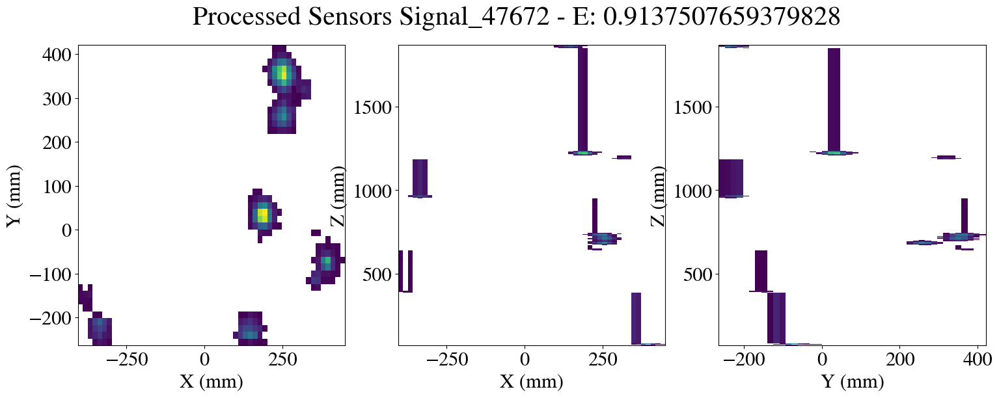

event 47672 post beersheba
EVENT 47672
Total energy 1.61 MeV



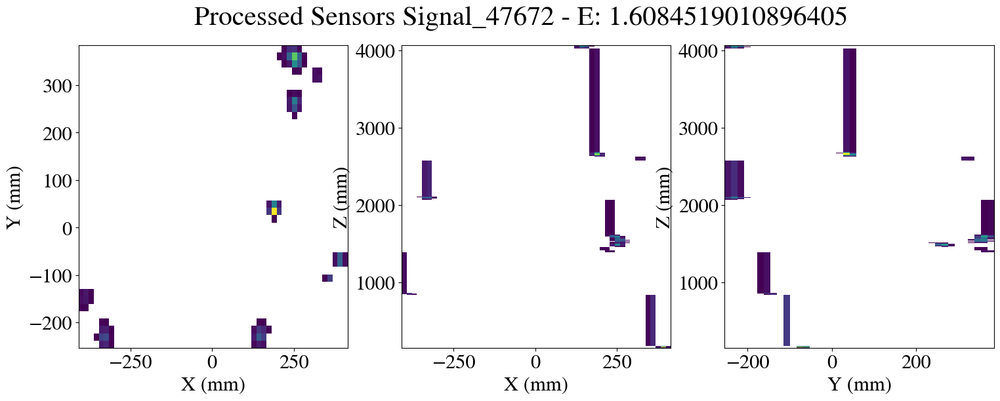

EVENT 48057
Number of tracks: 3
Energy of the event: 1.8009575577958332
event 48057 pre beersheba
EVENT 48057
Total energy 1.01 MeV

Time spent in cut_over_Q: 0.03659224510192871 s
Time spent in drop_isolated: 0.07501935958862305 s


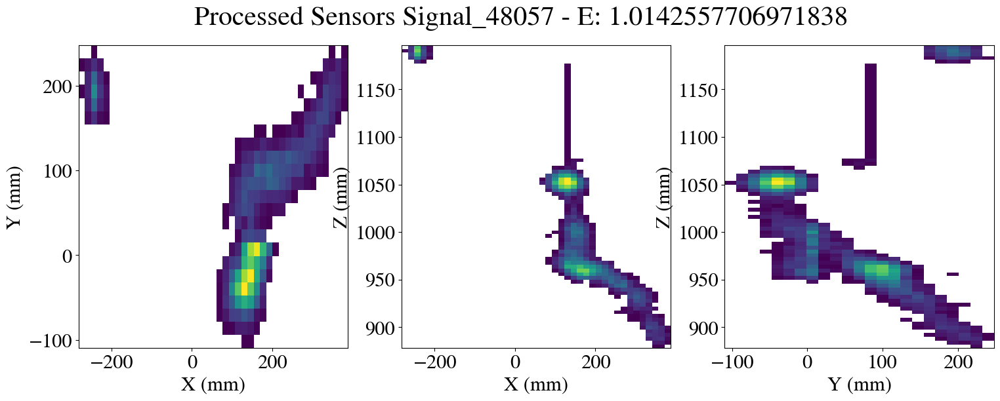

event 48057 post beersheba
EVENT 48057
Total energy 1.80 MeV



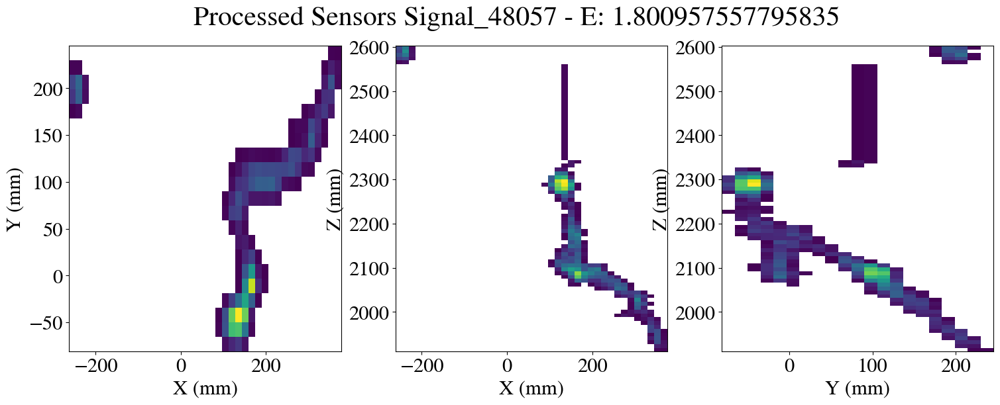

EVENT 48288
Number of tracks: 5
Energy of the event: 1.6065610796554557
event 48288 pre beersheba
EVENT 48288
Total energy 0.86 MeV

Time spent in cut_over_Q: 0.022351741790771484 s
Time spent in drop_isolated: 0.029444217681884766 s


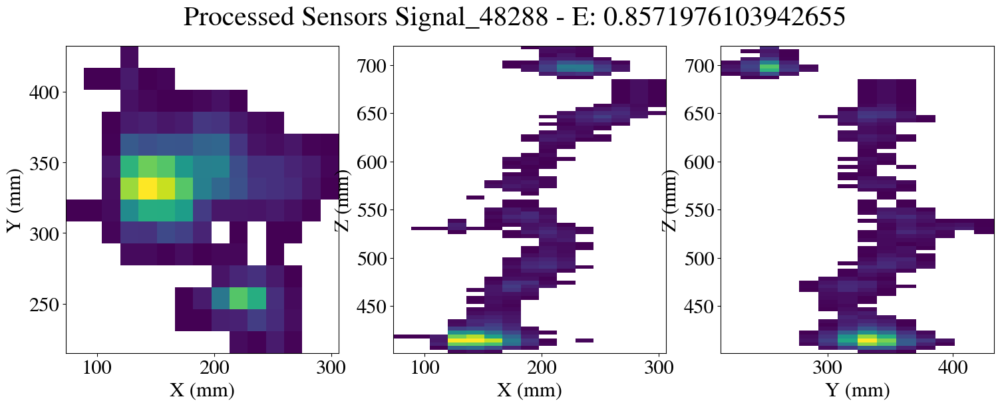

event 48288 post beersheba
EVENT 48288
Total energy 1.61 MeV



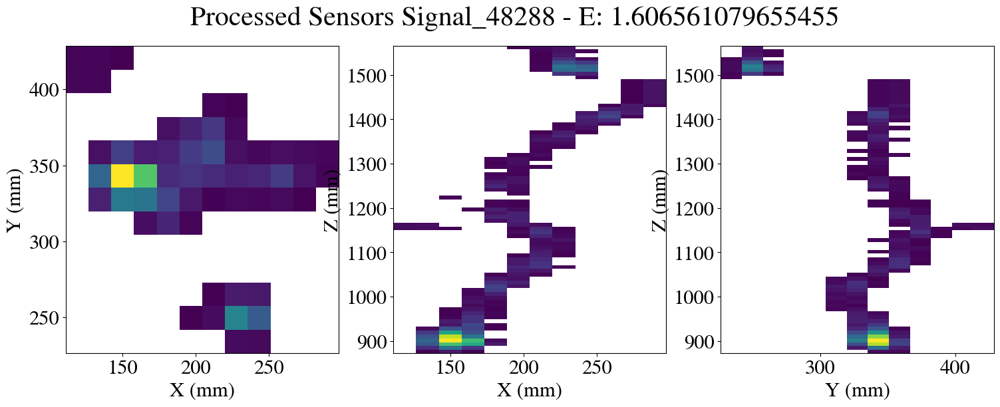

EVENT 55498
Number of tracks: 6
Energy of the event: 2.042192055213049
event 55498 pre beersheba
EVENT 55498
Total energy 1.03 MeV

Time spent in cut_over_Q: 0.15764141082763672 s
Time spent in drop_isolated: 0.056452035903930664 s


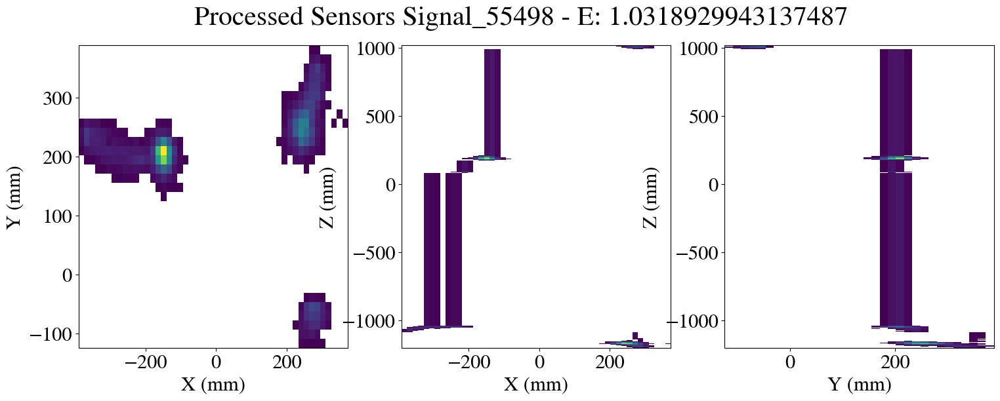

event 55498 post beersheba
EVENT 55498
Total energy 2.04 MeV



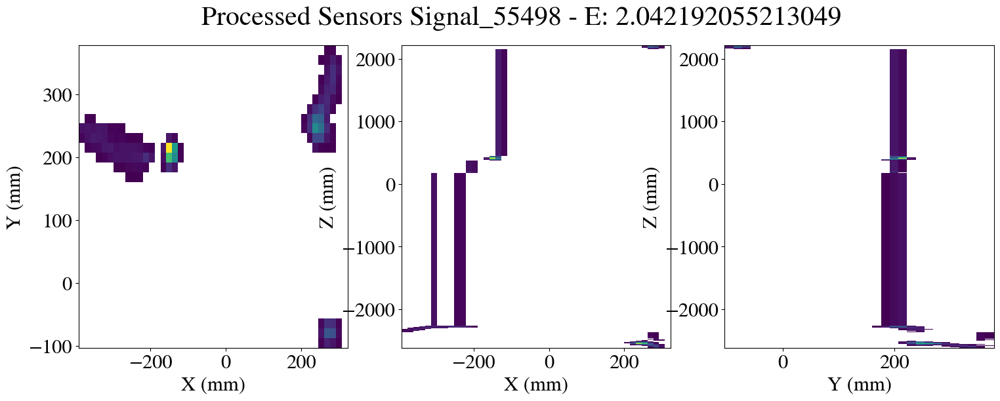

EVENT 55673
Number of tracks: 7
Energy of the event: 1.9465229676168496
event 55673 pre beersheba
EVENT 55673
Total energy 1.03 MeV

Time spent in cut_over_Q: 0.06668996810913086 s
Time spent in drop_isolated: 0.05039811134338379 s


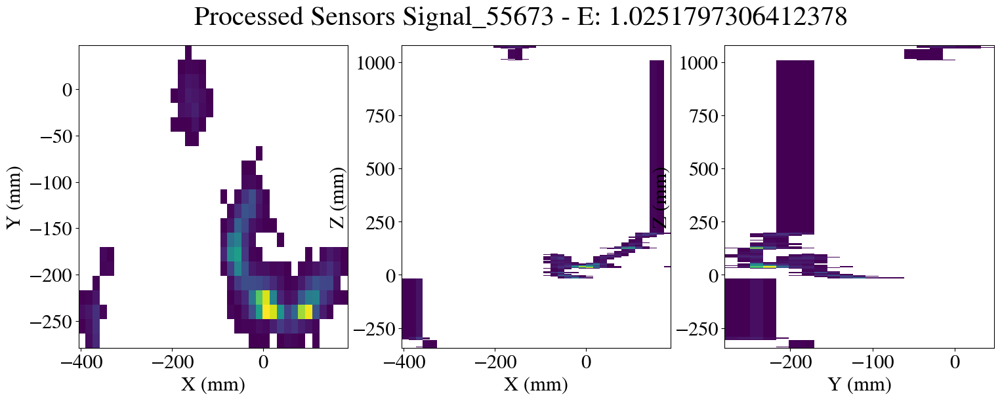

event 55673 post beersheba
EVENT 55673
Total energy 1.95 MeV



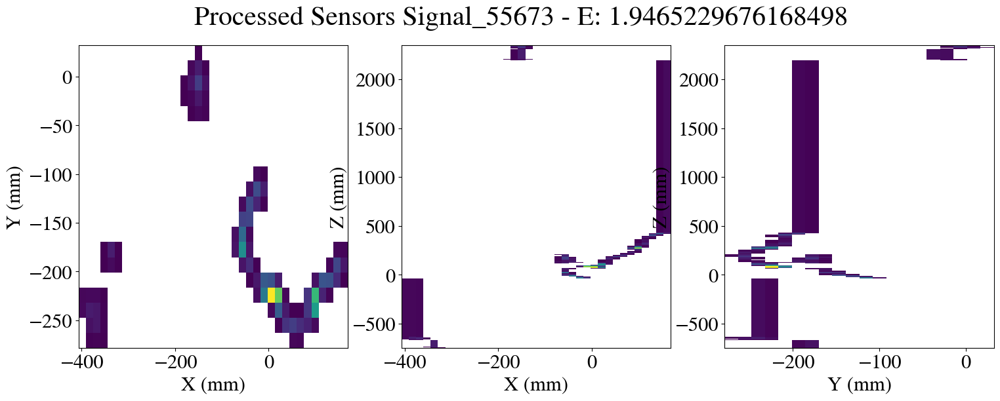

EVENT 60615
Number of tracks: 6
Energy of the event: 1.6665020013809821
event 60615 pre beersheba
EVENT 60615
Total energy 0.90 MeV

Time spent in cut_over_Q: 0.05184459686279297 s
Time spent in drop_isolated: 0.047287940979003906 s


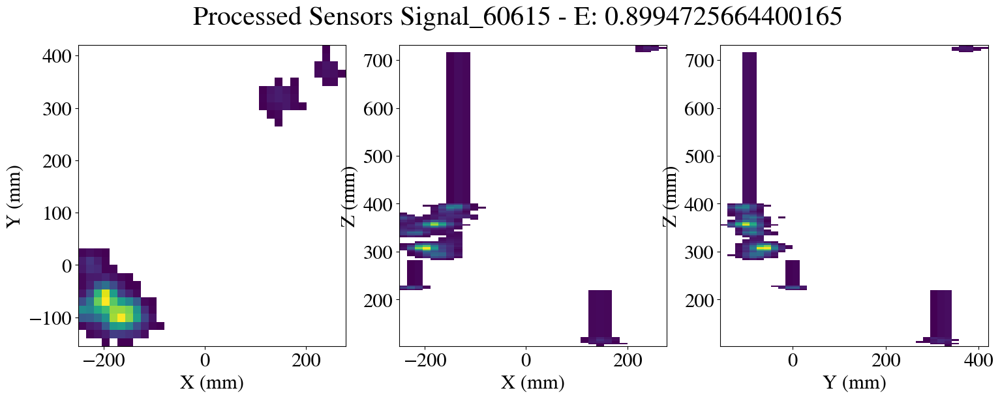

event 60615 post beersheba
EVENT 60615
Total energy 1.67 MeV



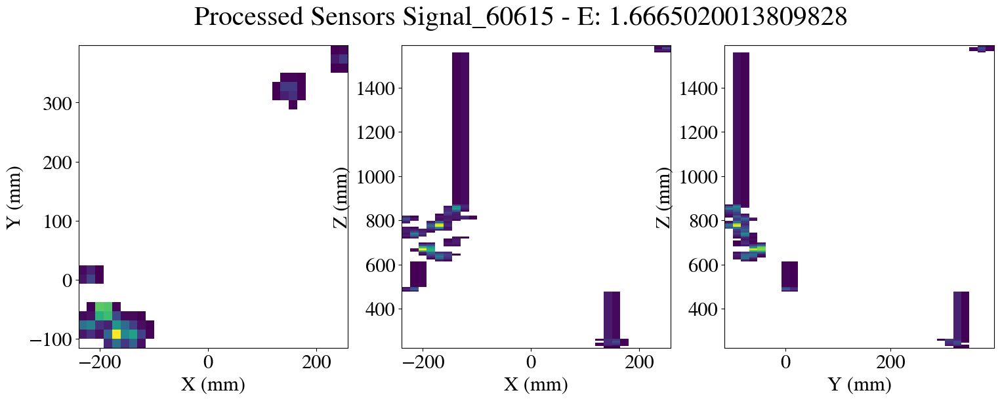

EVENT 53734
Number of tracks: 9
Energy of the event: 2.373151869623574
event 53734 pre beersheba
EVENT 53734
Total energy 1.32 MeV

Time spent in cut_over_Q: 0.07111072540283203 s
Time spent in drop_isolated: 0.11287927627563477 s


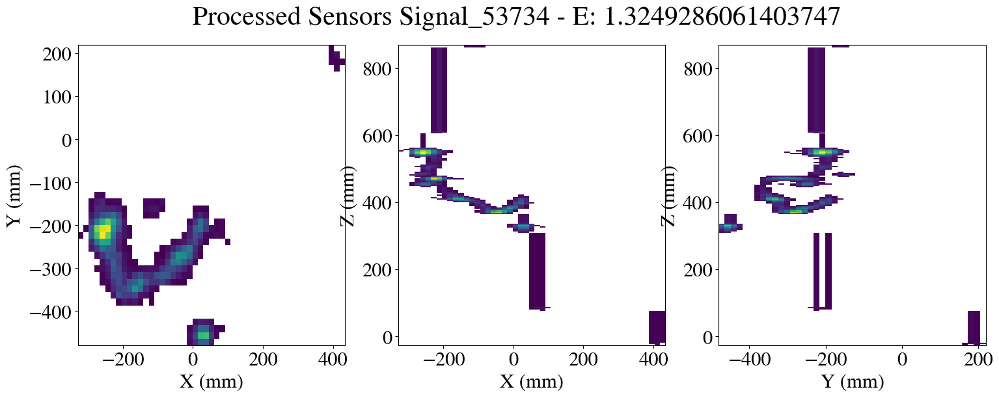

event 53734 post beersheba
EVENT 53734
Total energy 2.37 MeV



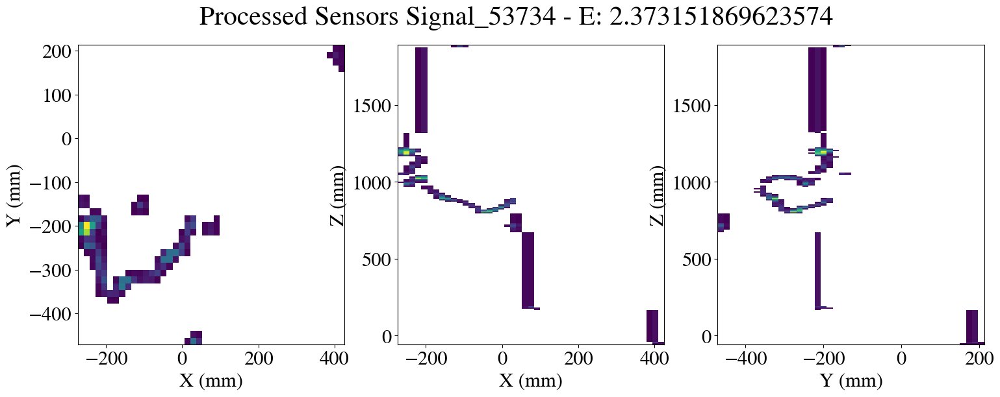

In [25]:
stopper = 20

for i, evt in enumerate(DEP_E_hits.event.unique()):
    print(f"EVENT {evt}\nNumber of tracks: {hdst[hdst.event == evt].numb_of_tracks.unique()[0]}")
    print(f"Energy of the event: {hdst[hdst.event == evt].energy.sum()}")
    print(f"event {evt} pre beersheba")
    func.plotter(low_E_soph_hits, evt, cut_n_drop = True, cut_sensors = cut_sensors, drop_sensors = drop_sensors)
    print(f"event {evt} post beersheba")
    func.plotter(low_E_hits, evt, cut_n_drop = False)
    
    if i > stopper:
        break

In [ ]:
out_fid_hits = hits[hits['event'].isin(out_fid_hdst.event.values)]

In [21]:
display(hdst)

,event,trackID,energy,length,numb_of_voxels,numb_of_hits,numb_of_tracks,x_min,y_min,z_min,...,blob1_z,blob2_x,blob2_y,blob2_z,eblob1,eblob2,ovlp_blob_energy,vox_size_x,vox_size_y,vox_size_z
0,8948,0,0.627782,98.488994,91,1584,2,-176.375,273.825,1372.330129,...,1380.533915,-144.312554,321.944293,1457.465196,0.246330,0.168424,0.000000,11.951220,11.802326,11.361525
1,8948,1,0.128133,27.851397,7,215,2,278.625,-168.675,1440.893132,...,1447.827128,294.496045,-150.151347,1466.777666,0.126592,0.124770,0.123228,11.951220,11.802326,11.361525
2,9053,0,0.694676,81.799334,82,1627,3,208.625,316.325,1098.644016,...,1167.480315,220.980848,344.323564,1098.644016,0.160748,0.083288,0.000000,11.904762,11.875000,11.998640
3,9053,1,0.163198,35.995919,14,411,3,-223.875,-96.175,1864.630107,...,1898.521110,-205.877463,-81.943843,1864.630107,0.120636,0.114544,0.071981,11.904762,11.875000,11.998640
4,9053,2,0.042026,11.998640,2,67,3,-211.375,-41.175,-289.029569,...,-283.708164,-203.872606,-40.184434,-272.790899,0.042026,0.042026,0.042026,11.904762,11.875000,11.998640
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
43178,2327534,1,0.051308,23.462873,7,135,2,53.625,136.325,1236.001440,...,1236.001440,69.808557,146.183483,1253.011833,0.051308,0.051308,0.051308,11.500000,11.590909,11.731437
43179,2327632,0,0.491657,64.767506,39,763,4,241.125,8.825,968.453199,...,968.453199,255.534623,25.528730,1027.902532,0.253606,0.131858,0.000000,11.953125,11.875000,11.975607
43180,2327632,1,0.122795,32.647037,11,272,4,-171.375,-161.175,448.628383,...,455.230631,-153.986975,-153.507172,473.079255,0.122603,0.120549,0.120357,11.953125,11.875000,11.975607
43181,2327632,2,0.067528,28.840684,10,241,4,-406.375,118.825,361.499752,...,369.320431,-387.945065,143.319827,388.073352,0.065150,0.064381,0.062003,11.953125,11.875000,11.975607


In [29]:
def raw_plotter(q, evt, pitch = 15.55):
    '''
    just plots the hits, nothing smart
    '''




    axes[0].scatter(q.X, q.Y, s=q.Q);
    axes[0].set_xlabel('X (mm)');
    axes[0].set_ylabel('Y (mm)');

    axes[1].scatter(q.X, q.Z, s=q.Q);
    axes[1].set_xlabel('X (mm)');
    axes[1].set_ylabel('Z (mm)');


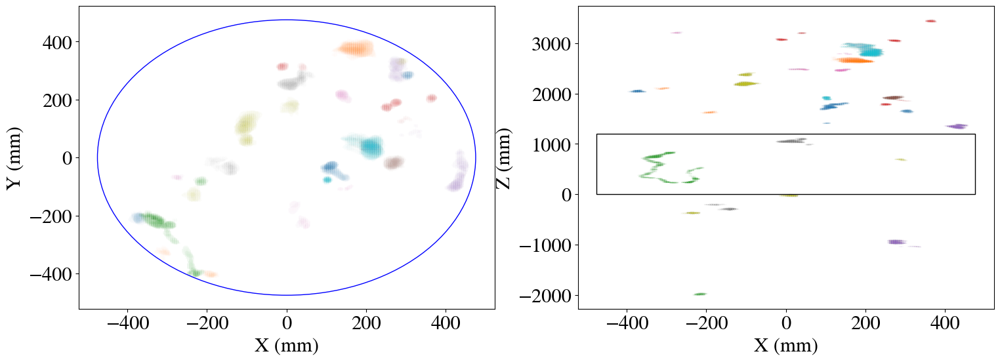

In [35]:
fig, axes = plt.subplots(1, 2, figsize=(18, 6))
circle1 = plt.Circle((0,0), radius = 475, fill = False, edgecolor = 'b')
squareXZ = plt.Rectangle((-475, 0), 475*2, 1200, fill = False, edgecolor = 'black')
axes[0].add_patch(circle1)
axes[1].add_patch(squareXZ)
counter = 0
for evt, df in out_fid_hits.groupby('event'):
    if counter < 10:
        raw_plotter(df, evt)
        counter += 1
    else:
        break

plt.show(fig)